In [180]:
import nltk
from nltk import pos_tag
from nltk.tokenize import TreebankWordTokenizer, word_tokenize, sent_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet as wn
from nltk.corpus import sentiwordnet as swn
from nltk.corpus import opinion_lexicon
from nltk.sentiment.util import mark_negation

import re
import pandas as pd
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS
import spacy

from langdetect import detect, detect_langs, DetectorFactory

from string import punctuation
from IPython.display import display
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

In [2]:
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('sentiwordnet')
nltk.download("opinion_lexicon")

[nltk_data] Downloading package punkt to /home/alifim/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/alifim/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /home/alifim/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/alifim/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package sentiwordnet to
[nltk_data]     /home/alifim/nltk_data...
[nltk_data]   Package sentiwordnet is already up-to-date!
[nltk_data] Downloading package opinion_lexicon to
[nltk_data]     /home/alifim/nltk_data...
[nltk_data]   Unzipping corpora/opinion_lexicon.zip.


True

In [3]:
reviews = pd.read_csv("../data/tiktok_playstore_reviews_last_100000_20220929.csv")
reviews = reviews.drop(columns=["Unnamed: 0"])

## Sentiment Scoring Using SentiWordNet

In [4]:
def penn_to_wn(tag):
    """
        Convert between the PennTreebank tags to simple Wordnet tags
    """
    if tag.startswith('J'):
        return wn.ADJ
    elif tag.startswith('N'):
        return wn.NOUN
    elif tag.startswith('R'):
        return wn.ADV
    elif tag.startswith('V'):
        return wn.VERB
    return None

In [5]:
def get_sentiment_score(text):
    
    """
        This method returns the sentiment score of a given text using SentiWordNet sentiment scores.
        input: text
        output: numeric (double) score, >0 means positive sentiment and <0 means negative sentiment.
    """    
    total_score = 0
    print(text)
    raw_sentences = sent_tokenize(text)
    print(raw_sentences)
    
    for sentence in raw_sentences:

        sent_score = 0     
        sentence = str(sentence)
        print(sentence)
        sentence = sentence.replace("<br />"," ").translate(str.maketrans('','',punctuation)).lower()
        tokens = TreebankWordTokenizer().tokenize(text)
        tags = pos_tag(tokens)
        for word, tag in tags:
            wn_tag = penn_to_wn(tag)
            if not wn_tag:
                continue
            lemma = WordNetLemmatizer().lemmatize(word, pos=wn_tag)
            if not lemma:
                continue
            synsets = wn.synsets(lemma, pos=wn_tag)
            if not synsets:
                continue
            synset = synsets[0]
            swn_synset = swn.senti_synset(synset.name())
            sent_score += swn_synset.pos_score() - swn_synset.neg_score()

        total_score = total_score + (sent_score / len(tokens))

    
    return (total_score / len(raw_sentences)) * 100

In [6]:
reviews.shape

(100000, 2)

In [7]:
reviews.head()

,content,score
0,Not viral my vedios dont like tik tok,1
1,mantap,5
2,The best,5
3,Tik Tok,5
4,Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.,3


In [8]:
reviews.dropna(subset=["content"], inplace=True)

In [9]:
reviews.shape

(99999, 2)

In [10]:
reviews['swn_score'] = reviews['content'].apply(lambda text : get_sentiment_score(text))

Not viral my vedios dont like tik tok
['Not viral my vedios dont like tik tok']
Not viral my vedios dont like tik tok
mantap
['mantap']
mantap
The best
['The best']
The best
Tik Tok
['Tik Tok']
Tik Tok
Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.
["Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked.", 'Makes me paranoid for some stupid reasons.']
Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked.
Makes me paranoid for some stupid reasons.
This nice and relaxing..application..and aim enjoying it .
['This nice and relaxing..application..and aim enjoying it .']
This nice and relaxing..application..and aim enjoying it .
I'm happy
["I'm happy"]
I'm happy
Why tiktok is not working in Realme C3😡 Fix it rn tysm
['Why tiktok is not working in Realme C3😡 Fix it rn tysm']
Why ti

Kase kapag katapos ko sa tarbaho ito agad ang aking libangan kaya masaya ako sa tiktok
['Kase kapag katapos ko sa tarbaho ito agad ang aking libangan kaya masaya ako sa tiktok']
Kase kapag katapos ko sa tarbaho ito agad ang aking libangan kaya masaya ako sa tiktok
Wow
['Wow']
Wow
Why can people post content that i can't post??? I post a video and everyone can post it but why cant i? :(let me post it please im begin you:(((
["Why can people post content that i can't post???", 'I post a video and everyone can post it but why cant i?', ':(let me post it please im begin you:(((']
Why can people post content that i can't post???
I post a video and everyone can post it but why cant i?
:(let me post it please im begin you:(((
Video aku x fyp
['Video aku x fyp']
Video aku x fyp
itso good
['itso good']
itso good
Suka bgt sm aplikasi 1 ini... Bnyak plajaran yg sya dpt dr aplikasi ini... 🥰🥰🥰
['Suka bgt sm aplikasi 1 ini... Bnyak plajaran yg sya dpt dr aplikasi ini... 🥰🥰🥰']
Suka bgt sm aplikasi 1 

I like poop
['I like poop']
I like poop
Nice dis is cool and beautiful ty
['Nice dis is cool and beautiful ty']
Nice dis is cool and beautiful ty
l like to tiktok because verry beautiful ❤️ like the movies
['l like to tiktok because verry beautiful ❤️ like the movies']
l like to tiktok because verry beautiful ❤️ like the movies
3 bad because my account
['3 bad because my account']
3 bad because my account
Most of the contents are cancerous
['Most of the contents are cancerous']
Most of the contents are cancerous
Pakyu all
['Pakyu all']
Pakyu all
Good
['Good']
Good
Myname Asfak
['Myname Asfak']
Myname Asfak
Awesome! I got 188 followers in just 2 days!😁
['Awesome!', 'I got 188 followers in just 2 days!😁']
Awesome!
I got 188 followers in just 2 days!😁
Pretty app
['Pretty app']
Pretty app
Everyggkvjmfvmvkvkmvcmcmmvmvvmmvmvmvmvmvmc!vldkdkckckcjdmdfkvkdmv!cmcmmccmmcmffmmcfmmfvmvmmmmmccmmcmcmccmmcmcmcmcmcmcmcd!d!ddd. fmfmdmfmmdmdmdd!d!!d!d!d!!d!!dd!!d!d!d??!d?ddnxndnxjjsmemdmsmxmxmdd!x!!x!xx!

Happy
['Happy']
Happy
Very fun
['Very fun']
Very fun
Love it i recommended my friends to try it. I would also recommend to add more features like in messages add a voice message or we can send pictures... overall love it would totally recommend 👌
['Love it i recommended my friends to try it.', 'I would also recommend to add more features like in messages add a voice message or we can send pictures... overall love it would totally recommend 👌']
Love it i recommended my friends to try it.
I would also recommend to add more features like in messages add a voice message or we can send pictures... overall love it would totally recommend 👌
This app is funny and amazing
['This app is funny and amazing']
This app is funny and amazing
ok
['ok']
ok
Have so fun to use this app
['Have so fun to use this app']
Have so fun to use this app
there is something literally wrong in this app. everytime im adding a video to my favorites it doesn't let me saves it and i tried to uninstall it, and then yea it

Ilove play store
['Ilove play store']
Ilove play store
ok pro gg global1 blus
['ok pro gg global1 blus']
ok pro gg global1 blus
Hehehehehe
['Hehehehehe']
Hehehehehe
Always happy to meet new people
['Always happy to meet new people']
Always happy to meet new people
This is the best tiktok
['This is the best tiktok']
This is the best tiktok
i really love it
['i really love it']
i really love it
Masaya po
['Masaya po']
Masaya po
best main tiktok
['best main tiktok']
best main tiktok
Happy
['Happy']
Happy
Thanks tiktok
['Thanks tiktok']
Thanks tiktok
It is fun to stay tune here during my free time☺
['It is fun to stay tune here during my free time☺']
It is fun to stay tune here during my free time☺
I love it and me and my brother si having live sometime
['I love it and me and my brother si having live sometime']
I love it and me and my brother si having live sometime
This is the best apps for me
['This is the best apps for me']
This is the best apps for me
Please my tiktok put the flash li

I cannot log in or sign up I hate this app
['I cannot log in or sign up I hate this app']
I cannot log in or sign up I hate this app
I really enjoyed watched videos on tiktok and it awesome
['I really enjoyed watched videos on tiktok and it awesome']
I really enjoyed watched videos on tiktok and it awesome
Good
['Good']
Good
Ahm. Too nice to use for a boring habbit.
['Ahm.', 'Too nice to use for a boring habbit.']
Ahm.
Too nice to use for a boring habbit.
Good
['Good']
Good
It's a good app I got 1000 followers from it
["It's a good app I got 1000 followers from it"]
It's a good app I got 1000 followers from it
The new update is not good at all there is a bug when i update i lost Upload Hd in more option my videos uploaded in my account look like 480p after the update. the video when i recording it turns into black but sounds is still playing. the views on my tiktok getting low and lower but i am not restricted. Over all tiktok is still good 😊 i suggest to keep balancing the video popin

Good
['Good']
Good
i like tkitok
['i like tkitok']
i like tkitok
Ok
['Ok']
Ok
@Khin moe 412
['@Khin moe 412']
@Khin moe 412
FcjvjvhjjjjjnnnjjjjjjjDddddddddDdddddddddffdddddddddddddddddddddddddddddfdddddddddddddddddddddddddddddddddddddddddddddddddddddddddddddddssddsddddsssssddddddddododddddddduududdjfudjjddjdjdjdjdjjfdjdjjddjdjxjxjxjdffjkkdui5de0bdkefbiុេិេិេេ្ិេោ២ដ្ោ្ោថ្្ផ្ផ២ប២នច្ចhohivioeoieikebckwwkxvekcejiegibixwoiwugyeyrycvuxbbnxmwmqlqlqksffdaqwetyuopplkkjhgfdsazzcbmmarsrfygiighiecrrikrkfrhfeffrjfhhceirhdiehcorchceieuxhiecjiagxiehcochuyxyihrcjegoejopjcohxgufyfewwrujgevboxbnklnznkgufywjjdr not sufficient well as k
['FcjvjvhjjjjjnnnjjjjjjjDddddddddDdddddddddffdddddddddddddddddddddddddddddfdddddddddddddddddddddddddddddddddddddddddddddddddddddddddddddddssddsddddsssssddddddddododddddddduududdjfudjjddjdjdjdjdjjfdjdjjddjdjxjxjxjdffjkkdui5de0bdkefbiុេិេិេេ្ិេោ២ដ្ោ្ោថ្្ផ្ផ២ប២នច្ចhohivioeoieikebckwwkxvekcejiegibixwoiwugyeyrycvuxbbnxmwmqlqlqksffdaqwetyuopplkkjhgfdsazzcbmmarsrfygiighiecrrikrkf

Thank you Tiktok 👍🏻 Thumbs Up !
ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ
['ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ်တယ်ချစ

good app
['good app']
good app
Where did my repost button go???💢
['Where did my repost button go??', '?💢']
Where did my repost button go??
?💢
I like this tiktok
['I like this tiktok']
I like this tiktok
So satisfied
['So satisfied']
So satisfied
ok thank
['ok thank']
ok thank
So nice This application
['So nice This application']
So nice This application
nice platform for personal individual and commercial
['nice platform for personal individual and commercial']
nice platform for personal individual and commercial
Ok
['Ok']
Ok
The best app ever! I'm really happy to see the people all over the world. I can communicate with my friends on this social media. All my friends are here.
['The best app ever!', "I'm really happy to see the people all over the world.", 'I can communicate with my friends on this social media.', 'All my friends are here.']
The best app ever!
I'm really happy to see the people all over the world.
I can communicate with my friends on this social media.
All my friends 

very good useful 👍
['very good useful 👍']
very good useful 👍
tik tok best
['tik tok best']
tik tok best
Nice
['Nice']
Nice
Its pretty Fun But the Bro i diny comment this this is a BOT wth
['Its pretty Fun But the Bro i diny comment this this is a BOT wth']
Its pretty Fun But the Bro i diny comment this this is a BOT wth
oh
['oh']
oh
Trending apps all around the world is turn on tiktok
['Trending apps all around the world is turn on tiktok']
Trending apps all around the world is turn on tiktok
App yg trbaik untuk buat side income
['App yg trbaik untuk buat side income']
App yg trbaik untuk buat side income
after I make a video, the music or sound glitches
['after I make a video, the music or sound glitches']
after I make a video, the music or sound glitches
Tiktok bodoh! Tidak pernah post apapa barang tidak ada comment apapa negative hanya tngok fyp jak dh kena banned!! Sot!!
['Tiktok bodoh!', 'Tidak pernah post apapa barang tidak ada comment apapa negative hanya tngok fyp jak dh kena b

Hiii so im using a Samsung tablet and the favorites button I gone for me and a lot of other people have it I really hope you could fix the problem so I could give you five stars!
['Hiii so im using a Samsung tablet and the favorites button I gone for me and a lot of other people have it I really hope you could fix the problem so I could give you five stars!']
Hiii so im using a Samsung tablet and the favorites button I gone for me and a lot of other people have it I really hope you could fix the problem so I could give you five stars!
Nice
['Nice']
Nice
Stress reliver😊
['Stress reliver😊']
Stress reliver😊
Ok
['Ok']
Ok
Seeing different issues and also different cultures .funny..scary..and moments etc .
['Seeing different issues and also different cultures .funny..scary..and moments etc .']
Seeing different issues and also different cultures .funny..scary..and moments etc .
This app sucks, because I don't like tiktok and, even my little sister likes tiktok, me i don't, I will rate 1 star.

👍
['👍']
👍
so very very cool app.
['so very very cool app.']
so very very cool app.
I had so much fun using tiktok.
['I had so much fun using tiktok.']
I had so much fun using tiktok.
Nice
['Nice']
Nice
Good
['Good']
Good
Verygood
['Verygood']
Verygood
ခနခနအကောက်ပြတ်တယ်
['ခနခနအကောက်ပြတ်တယ်']
ခနခနအကောက်ပြတ်တယ်
Tiktok is not fair to everyone specially in a small tiktoker
['Tiktok is not fair to everyone specially in a small tiktoker']
Tiktok is not fair to everyone specially in a small tiktoker
it's good
["it's good"]
it's good
I love the app and i get really creative with my vids
['I love the app and i get really creative with my vids']
I love the app and i get really creative with my vids
Good and so beautiful app
['Good and so beautiful app']
Good and so beautiful app
Gasuka karna setiap saat ada pembaruan teruss cape tau!!!!!
['Gasuka karna setiap saat ada pembaruan teruss cape tau!!!!', '!']
Gasuka karna setiap saat ada pembaruan teruss cape tau!!!!
!
Basketball
['Basketball']
Basket

I have been a while.
I have been a while.
I have been a while.
I have been a long term and a bit.
The may not necessarily represent a significant impact
Carla Mae T.Cantino 9.
['Carla Mae T.Cantino 9.']
Carla Mae T.Cantino 9.
inn
['inn']
inn
Those happy
['Those happy']
Those happy
Please give me followers
['Please give me followers']
Please give me followers
Good luck 👍👍👍👍🥰🥰🥰🥰🥰🥰🥰 😍 funny video games video food video am not
['Good luck 👍👍👍👍🥰🥰🥰🥰🥰🥰🥰 😍 funny video games video food video am not']
Good luck 👍👍👍👍🥰🥰🥰🥰🥰🥰🥰 😍 funny video games video food video am not
I hate the new update where you have to wait seven days before you can change your display name I wish you got rid of this new so called "update" and I always flop but I really enjoy tiktok videos so I'll give it a three
['I hate the new update where you have to wait seven days before you can change your display name I wish you got rid of this new so called "update" and I always flop but I really enjoy tiktok videos so I\'ll give it 

namemersonal, sakit nakem ko. paasa nga tiktok kunak ikkan nak ti tips tapno iatttact crush ko tas wag kana umasa agpakita bastos😭😭
['namemersonal, sakit nakem ko.', 'paasa nga tiktok kunak ikkan nak ti tips tapno iatttact crush ko tas wag kana umasa agpakita bastos😭😭']
namemersonal, sakit nakem ko.
paasa nga tiktok kunak ikkan nak ti tips tapno iatttact crush ko tas wag kana umasa agpakita bastos😭😭
terbest
['terbest']
terbest
Good the app
['Good the app']
Good the app
grabe takaw sa load
['grabe takaw sa load']
grabe takaw sa load
i can't update the tiktok app since yesterday. i tried uninstalling and tried to install again but i can't seem to install it. please help me
["i can't update the tiktok app since yesterday.", "i tried uninstalling and tried to install again but i can't seem to install it.", 'please help me']
i can't update the tiktok app since yesterday.
i tried uninstalling and tried to install again but i can't seem to install it.
please help me
Im enjoying, easy to do it

good tittok
['good tittok']
good tittok
Great app
['Great app']
Great app
It's good, it is my stress reliver
["It's good, it is my stress reliver"]
It's good, it is my stress reliver
Mac xxxxxxxxxx javed xxxxxxjunid
['Mac xxxxxxxxxx javed xxxxxxjunid']
Mac xxxxxxxxxx javed xxxxxxjunid
To my opinion, tiktok is always going home even tho i did not pressing the home button and i think its just my phone so next time i dont delete the apps that is important even tho i dont know that is important, thank u and godbless u all
['To my opinion, tiktok is always going home even tho i did not pressing the home button and i think its just my phone so next time i dont delete the apps that is important even tho i dont know that is important, thank u and godbless u all']
To my opinion, tiktok is always going home even tho i did not pressing the home button and i think its just my phone so next time i dont delete the apps that is important even tho i dont know that is important, thank u and godbless u 

Have a good idea to have to the heart and soul, and you are the heart and the young boyfriend to be used for i g Dance Challenge to the trash can I don't think it is a good time to be sure y yt? the heart and soul into o n a good idea, but the heart and jong are you do All the heart I lake, but the nine tale of affection and jong are you do not have a friend who was in the heart of us, but I don't think so, but it was in your house and jong kook the heart I lake that should work on it covers a k
["Have a good idea to have to the heart and soul, and you are the heart and the young boyfriend to be used for i g Dance Challenge to the trash can I don't think it is a good time to be sure y yt?", "the heart and soul into o n a good idea, but the heart and jong are you do All the heart I lake, but the nine tale of affection and jong are you do not have a friend who was in the heart of us, but I don't think so, but it was in your house and jong kook the heart I lake that should work on it cove

The highlight is good when ur phone is realme C11
['The highlight is good when ur phone is realme C11']
The highlight is good when ur phone is realme C11
good
['good']
good
d siya nag pla-play
['d siya nag pla-play']
d siya nag pla-play
yas
['yas']
yas
nice
['nice']
nice
It's fun I made online friends there are kinda funny! I have making edits BTW!
["It's fun I made online friends there are kinda funny!", 'I have making edits BTW!']
It's fun I made online friends there are kinda funny!
I have making edits BTW!
❤️
['❤️']
❤️
Tiktok uncommunify
['Tiktok uncommunify']
Tiktok uncommunify
stress reliever
['stress reliever']
stress reliever
aplikasi tidak jelas...dikit dikit warning..banned uninstall aplikasi tidak bermutu
['aplikasi tidak jelas...dikit dikit warning..banned uninstall aplikasi tidak bermutu']
aplikasi tidak jelas...dikit dikit warning..banned uninstall aplikasi tidak bermutu
🥰
['🥰']
🥰
Like
['Like']
Like
Fun😎
['Fun😎']
Fun😎
Very goods for tiktok
['Very goods for tiktok']
Very g

Beautiful app thanks for the update on my phone
['Beautiful app thanks for the update on my phone']
Beautiful app thanks for the update on my phone
Good but it is lose data so much
['Good but it is lose data so much']
Good but it is lose data so much
Good apps
['Good apps']
Good apps
tiktok is mY favorite app!!
['tiktok is mY favorite app!', '!']
tiktok is mY favorite app!
!
idkkkkkkkk
['idkkkkkkkk']
idkkkkkkkk
Hello why cant I download the new update
['Hello why cant I download the new update']
Hello why cant I download the new update
nice.sobra
['nice.sobra']
nice.sobra
I love this So much
['I love this So much']
I love this So much
This app is so cool!
['This app is so cool!']
This app is so cool!
My experience good for sharing you idol and career goals 😘👍
['My experience good for sharing you idol and career goals 😘👍']
My experience good for sharing you idol and career goals 😘👍
3 stars because i don't have views of my tiktok🥲
["3 stars because i don't have views of my tiktok\U0001f9

Gooddddd
['Gooddddd']
Gooddddd
so the problem is there's alot of bad contents that is not allowed for kids like me so can you please fix it
["so the problem is there's alot of bad contents that is not allowed for kids like me so can you please fix it"]
so the problem is there's alot of bad contents that is not allowed for kids like me so can you please fix it
Hahahahaha
['Hahahahaha']
Hahahahaha
My body is my choice
['My body is my choice']
My body is my choice
Thanks tiktok..
['Thanks tiktok..']
Thanks tiktok..
Bakit Hindi nagagamit Ang epeck sa TikTok kapag walang load tapos pag ginamit mo Yung drafts Sana Naman baguhin Kasi Ang hirap kapag walang load
['Bakit Hindi nagagamit Ang epeck sa TikTok kapag walang load tapos pag ginamit mo Yung drafts Sana Naman baguhin Kasi Ang hirap kapag walang load']
Bakit Hindi nagagamit Ang epeck sa TikTok kapag walang load tapos pag ginamit mo Yung drafts Sana Naman baguhin Kasi Ang hirap kapag walang load
It's so beautiful
["It's so beautiful"]
It'

Dvc
['Dvc']
Dvc
Im happy to watch tiktok
['Im happy to watch tiktok']
Im happy to watch tiktok
Aplouded
['Aplouded']
Aplouded
Good
['Good']
Good
Escape from boredom. best ap
['Escape from boredom.', 'best ap']
Escape from boredom.
best ap
Good
['Good']
Good
Bakit ganon malakas Naman net KO bakit puro loading Lang,
['Bakit ganon malakas Naman net KO bakit puro loading Lang,']
Bakit ganon malakas Naman net KO bakit puro loading Lang,
Entertaining
['Entertaining']
Entertaining
Just make dark mood available for Android.
['Just make dark mood available for Android.']
Just make dark mood available for Android.
i like. this app
['i like.', 'this app']
i like.
this app
Good
['Good']
Good
Suck
['Suck']
Suck
Many learnings from this app..
['Many learnings from this app..']
Many learnings from this app..
I earn because of you.
['I earn because of you.']
I earn because of you.
Good
['Good']
Good
Thankyou, Tiktok for being my friend even when I have a hard time in live. U make day. Big love and sup

A good app afterall, but i reccomend adding history, because whenever i'm watching something, i accidently refresh, and couldn't find the video anymore, tiktok please add history, and i will for sure rate it a 5/5!
It's good to use
["It's good to use"]
It's good to use
good
['good']
good
Good
['Good']
Good
Good
['Good']
Good
Very goof
['Very goof']
Very goof
wow
['wow']
wow
Cool app (fr)
['Cool app (fr)']
Cool app (fr)
I love it😊
['I love it😊']
I love it😊
terbaikkk
['terbaikkk']
terbaikkk
FIRST YOU DELETED THE CLEAR MODE THING, THE FILTER THING WHERE I CAN SEE THE FILTER BEING USED KN A VIDEO, AND NOW GHW FAVORITES SHORTCUT THING ON THE BOTTOM LF THE SHARE BUTTON????? YOU EVEN REMOVED THE FAVORITES FOR COMMENTS, GOSH. PLEASE STOP REMOVING AND THEN ADDING SLMETHING NEW EVERYTIINE KT'S GETTING SO ANNOYING UGH
['FIRST YOU DELETED THE CLEAR MODE THING, THE FILTER THING WHERE I CAN SEE THE FILTER BEING USED KN A VIDEO, AND NOW GHW FAVORITES SHORTCUT THING ON THE BOTTOM LF THE SHARE BUTTON??

edit: i still can't update it even though my phone storage is not full.
tik tok mãi đỉnh, xuất sắc
['tik tok mãi đỉnh, xuất sắc']
tik tok mãi đỉnh, xuất sắc
Tiktok that's
["Tiktok that's"]
Tiktok that's
Good
['Good']
Good
I don't know why my tik tok cannot add location? Even already on the location icon but still didnt show im my profil. I hv report the problem, but still didn't get any feedback from tiktok team. Pls help me on this problem. Tq
["I don't know why my tik tok cannot add location?", 'Even already on the location icon but still didnt show im my profil.', "I hv report the problem, but still didn't get any feedback from tiktok team.", 'Pls help me on this problem.', 'Tq']
I don't know why my tik tok cannot add location?
Even already on the location icon but still didnt show im my profil.
I hv report the problem, but still didn't get any feedback from tiktok team.
Pls help me on this problem.
Tq
U want 5 star nah u can't
["U want 5 star nah u can't"]
U want 5 star nah u can't

araa araaaa...gambateyo oniiichan...datebayo...kimooochiiehh
['araa araaaa...gambateyo oniiichan...datebayo...kimooochiiehh']
araa araaaa...gambateyo oniiichan...datebayo...kimooochiiehh
nice
['nice']
nice
Nice
['Nice']
Nice
👎🏻
['👎🏻']
👎🏻
great app,but can u fix the effect almost all of the trending effect are not showing😭
['great app,but can u fix the effect almost all of the trending effect are not showing😭']
great app,but can u fix the effect almost all of the trending effect are not showing😭
Mantap
['Mantap']
Mantap
I liked tiktok
['I liked tiktok']
I liked tiktok
good
['good']
good
Great app but can you please add an new update where u can send u friend images
['Great app but can you please add an new update where u can send u friend images']
Great app but can you please add an new update where u can send u friend images
Nakakatuwa at stress free ka kahit bago lang Ako sa TikTok support po
['Nakakatuwa at stress free ka kahit bago lang Ako sa TikTok support po']
Nakakatuwa at stres

This app is so amazing I got 50k+ followers, I'm so amaze and I can't imagine I'm going to that far and I like spending time to this app.
["This app is so amazing I got 50k+ followers, I'm so amaze and I can't imagine I'm going to that far and I like spending time to this app."]
This app is so amazing I got 50k+ followers, I'm so amaze and I can't imagine I'm going to that far and I like spending time to this app.
Bolo Brian
['Bolo Brian']
Bolo Brian
no vd on the feed
['no vd on the feed']
no vd on the feed
Ganda
['Ganda']
Ganda
Hlo TikTok team please help me can I my TikTok date of birth change please
['Hlo TikTok team please help me can I my TikTok date of birth change please']
Hlo TikTok team please help me can I my TikTok date of birth change please
တွေးပီးမှတင်ပါ
['တွေးပီးမှတင်ပါ']
တွေးပီးမှတင်ပါ
Torripic excellent
['Torripic excellent']
Torripic excellent
Overall it's good but just today tiktok told me to make a new account while I already have one but in there it say I didn't lo

like
['like']
like
App yg bagus dan yg tidak bagus katanya dapat kekuatan Jilong dan alok 👍🏻👍🏻
['App yg bagus dan yg tidak bagus katanya dapat kekuatan Jilong dan alok 👍🏻👍🏻']
App yg bagus dan yg tidak bagus katanya dapat kekuatan Jilong dan alok 👍🏻👍🏻
Tulong lng
['Tulong lng']
Tulong lng
Didnt get code bulok tanginangto
['Didnt get code bulok tanginangto']
Didnt get code bulok tanginangto
why is there no dark mode feature for android users, please add a dark mode feature.
['why is there no dark mode feature for android users, please add a dark mode feature.']
why is there no dark mode feature for android users, please add a dark mode feature.
Apk asyeek
['Apk asyeek']
Apk asyeek
I love tiktok 🥰🥰🥰
['I love tiktok 🥰🥰🥰']
I love tiktok 🥰🥰🥰
Banned my acc bobo
['Banned my acc bobo']
Banned my acc bobo
Tiktok is so very slow but Its the best
['Tiktok is so very slow but Its the best']
Tiktok is so very slow but Its the best
Very entertaining
['Very entertaining']
Very entertaining
Zawhlal
['Za

Good
['Good']
Good
okokok
['okokok']
okokok
i like it 😘🥰
['i like it 😘🥰']
i like it 😘🥰
I love you
['I love you']
I love you
Good..
['Good..']
Good..
Wala ang sarap lang mag scroll sa tiktok.
['Wala ang sarap lang mag scroll sa tiktok.']
Wala ang sarap lang mag scroll sa tiktok.
Xiomi poco f3 not fullscreen
['Xiomi poco f3 not fullscreen']
Xiomi poco f3 not fullscreen
I can't find where to create playlist video on tiktok.
["I can't find where to create playlist video on tiktok."]
I can't find where to create playlist video on tiktok.
Ilike it
['Ilike it']
Ilike it
Best apps for knowing new info also can shop directly..
['Best apps for knowing new info also can shop directly..']
Best apps for knowing new info also can shop directly..
👍👍👍👍👍
['👍👍👍👍👍']
👍👍👍👍👍
ver like
['ver like']
ver like
Ok
['Ok']
Ok
Marai ngelag
['Marai ngelag']
Marai ngelag
very nc app but volumes are annoying
['very nc app but volumes are annoying']
very nc app but volumes are annoying
So useful for upload video and rea

'Too many attempts.
Try again later' is the error for days.
Great experience
['Great experience']
Great experience
This is so cool game I meet I enjoy to because I have 1000 friends🌈
['This is so cool game I meet I enjoy to because I have 1000 friends🌈']
This is so cool game I meet I enjoy to because I have 1000 friends🌈
cutie
['cutie']
cutie
Good
['Good']
Good
pa download ako ng tiktok gusto kona mag tiktok
['pa download ako ng tiktok gusto kona mag tiktok']
pa download ako ng tiktok gusto kona mag tiktok
Best
['Best']
Best
Omg
['Omg']
Omg
great
['great']
great
Terbaik
['Terbaik']
Terbaik
AYeShaS.Fuentes Geade.1
['AYeShaS.Fuentes Geade.1']
AYeShaS.Fuentes Geade.1
I need to update thats why i cant use good
['I need to update thats why i cant use good']
I need to update thats why i cant use good
Good
['Good']
Good
Nice
['Nice']
Nice
Pls update my tiktok
['Pls update my tiktok']
Pls update my tiktok
Sheena Mae S. Balagbes
['Sheena Mae S. Balagbes']
Sheena Mae S. Balagbes
It's so good and

I tried creating new accounts but of all of them suddely gets suspended the moment i log in them.
Please @tiktok help me.
Hay phim kìa bà kia chu đíc ra
['Hay phim kìa bà kia chu đíc ra']
Hay phim kìa bà kia chu đíc ra
I enjoy😍stress reliever
['I enjoy😍stress reliever']
I enjoy😍stress reliever
Tsk.
['Tsk.']
Tsk.
I experienced few problems.
['I experienced few problems.']
I experienced few problems.
So many missing effects. Iwant fix this tiktok
['So many missing effects.', 'Iwant fix this tiktok']
So many missing effects.
Iwant fix this tiktok
The tiktok keep saying no internet connection but i have full access of wifi and also can open other apps requiring internet. What is wrong with tiktok??? Its been 1 week now!
['The tiktok keep saying no internet connection but i have full access of wifi and also can open other apps requiring internet.', 'What is wrong with tiktok???', 'Its been 1 week now!']
The tiktok keep saying no internet connection but i have full access of wifi and also ca

no comment's.
["no comment's."]
no comment's.
Letchumananlceshare
['Letchumananlceshare']
Letchumananlceshare
good
['good']
good
It's nice
["It's nice"]
It's nice
Ganda ng app marami na magagawa at may mapagkakakitaan na rn☺️👍
['Ganda ng app marami na magagawa at may mapagkakakitaan na rn☺️👍']
Ganda ng app marami na magagawa at may mapagkakakitaan na rn☺️👍
Nice app
['Nice app']
Nice app
It's a good app
["It's a good app"]
It's a good app
I love upload tiktok my vedio
['I love upload tiktok my vedio']
I love upload tiktok my vedio
HOW IN THE UNIVERSE OF CHOCOLATE FUDGES DID YOU THINK OF PUTTING THE 7 DAYS AFTER I CAN CHANGE MY NAME??? THIS IS UNBELIEVABLE AND UNACCEPTABLE.!! AND A WASTE OF MY FREAKING STORAGE BY UPDATING IT WHICH USES ALL OF MY STORAGE WITHOUT GAINING NEW UPDATES AFTER ALL, I WONT BE SURPRISED BECAUSE EVEN WHEN MY SIGNAL IS STRONG, THE NEXT VIDEO CROSSING ON MY NF ALWAYS LAGGS AND IF I REFRESH THE APP I CANT SEE IT ON THE HISTORY!
['HOW IN THE UNIVERSE OF CHOCOLATE FUDG

Superr enjoying
['Superr enjoying']
Superr enjoying
Hi im using my sisters account so How can i search for Videos
['Hi im using my sisters account so How can i search for Videos']
Hi im using my sisters account so How can i search for Videos
😍😍😍
['😍😍😍']
😍😍😍
I don't like your latest update
["I don't like your latest update"]
I don't like your latest update
👍
['👍']
👍
ok lng
['ok lng']
ok lng
Fun
['Fun']
Fun
Mas maganda yung new updates 😭
['Mas maganda yung new updates 😭']
Mas maganda yung new updates 😭
About dancing
['About dancing']
About dancing
Jn 2kknzzjjj wjhjaZ
['Jn 2kknzzjjj wjhjaZ']
Jn 2kknzzjjj wjhjaZ
valjommel22agravante macapobre valjommel22
['valjommel22agravante macapobre valjommel22']
valjommel22agravante macapobre valjommel22
Win thin
['Win thin']
Win thin
Early Hy
['Early Hy']
Early Hy
😍😘😊😚😍
['😍😘😊😚😍']
😍😘😊😚😍
It's good but sometimes it have some bugs and lags so can you fix it?
["It's good but sometimes it have some bugs and lags so can you fix it?"]
It's good but sometimes

🙃
['🙃']
🙃
Why the bot says tiktok needs to track your location? Im very scared if i got locatedddd!!!
['Why the bot says tiktok needs to track your location?', 'Im very scared if i got locatedddd!!', '!']
Why the bot says tiktok needs to track your location?
Im very scared if i got locatedddd!!
!
Good
['Good']
Good
Excellent
['Excellent']
Excellent
It's nice
["It's nice"]
It's nice
Exciting....!
['Exciting....!']
Exciting....!
🆂🆈🆂🆃🅴🅼🆂
['🆂🆈🆂🆃🅴🅼🆂']
🆂🆈🆂🆃🅴🅼🆂
if I insert a video, the sound always has to be removed
['if I insert a video, the sound always has to be removed']
if I insert a video, the sound always has to be removed
This app is very cool and fun to use
['This app is very cool and fun to use']
This app is very cool and fun to use
Ok
['Ok']
Ok
Nice
['Nice']
Nice
I hat3 it where it forces u to update
['I hat3 it where it forces u to update']
I hat3 it where it forces u to update
Hello! Whenever I open this app it will always lag even though my WiFi is perfectly fine?
['Hello!', 'Wh

Ok
['Ok']
Ok
I'M GOING TO BE A GREATEST TIKTOKER ☺😘😘
["I'M GOING TO BE A GREATEST TIKTOKER ☺😘😘"]
I'M GOING TO BE A GREATEST TIKTOKER ☺😘😘
Extention
['Extention']
Extention
this app cannot differentiate between No Copyright Sound and Full copyright, even if you put NCS in your video, it still defines the sound as copyright. please fix it ASAP. thx
['this app cannot differentiate between No Copyright Sound and Full copyright, even if you put NCS in your video, it still defines the sound as copyright.', 'please fix it ASAP.', 'thx']
this app cannot differentiate between No Copyright Sound and Full copyright, even if you put NCS in your video, it still defines the sound as copyright.
please fix it ASAP.
thx
Its very nice
['Its very nice']
Its very nice
why cant update
['why cant update']
why cant update
This is cool
['This is cool']
This is cool
hvi
['hvi']
hvi
This is so good I like it
['This is so good I like it']
This is so good I like it
I love the TikTok cele🥰
['I love the TikTok cele🥰

It's been 7 months since you remove the live access on my account for minimum age requirement.
I sent you my ID to prove that I am a 18+ age but still didn't give back the live access.
Thank you.
Ganda mo celda
['Ganda mo celda']
Ganda mo celda
Is so goodddd
['Is so goodddd']
Is so goodddd
I want this apps
['I want this apps']
I want this apps
Good
['Good']
Good
I really like this app because it's fun to use and I can show my creations to people.
["I really like this app because it's fun to use and I can show my creations to people."]
I really like this app because it's fun to use and I can show my creations to people.
I support this app every year but my aupport wasted my time.. This app doesn't value users... tiktok system of Community guidelines are not honest...
['I support this app every year but my aupport wasted my time..', "This app doesn't value users... tiktok system of Community guidelines are not honest..."]
I support this app every year but my aupport wasted my time..
This

Hi I'm one of a long time user(more than 1 or 2 years) this app has developed lot of functionality and some of function is pretty good but in the same time they have a lot of error, examples like lot of mistakes banned clip or accounts, restricted your account without no reason Etc. That all from my direct experience, and I'm very really sad that I lost more than 5k lovely subscriber, Thanks.
["Hi I'm one of a long time user(more than 1 or 2 years) this app has developed lot of functionality and some of function is pretty good but in the same time they have a lot of error, examples like lot of mistakes banned clip or accounts, restricted your account without no reason Etc.", "That all from my direct experience, and I'm very really sad that I lost more than 5k lovely subscriber, Thanks."]
Hi I'm one of a long time user(more than 1 or 2 years) this app has developed lot of functionality and some of function is pretty good but in the same time they have a lot of error, examples like lot o

Can make videos easily and I'm very enjoy with tik tok...tq tik tok make my day always great and happy❤️❤️
["Can make videos easily and I'm very enjoy with tik tok...tq tik tok make my day always great and happy❤️❤️"]
Can make videos easily and I'm very enjoy with tik tok...tq tik tok make my day always great and happy❤️❤️
I love this app but idk how to make a playlist pls tell me how to make it!
['I love this app but idk how to make a playlist pls tell me how to make it!']
I love this app but idk how to make a playlist pls tell me how to make it!
pretty good but my phone keeps laying so i hope I fix it🕸
['pretty good but my phone keeps laying so i hope I fix it🕸']
pretty good but my phone keeps laying so i hope I fix it🕸
Verry nice
['Verry nice']
Verry nice
Nice and enjoyable
['Nice and enjoyable']
Nice and enjoyable
good
['good']
good
Sana po ma install ang tiktok ko
['Sana po ma install ang tiktok ko']
Sana po ma install ang tiktok ko
Ilove tiktok
['Ilove tiktok']
Ilove tiktok
Good


All the best to tiktok.
This platform gives motivation and insights to those who are seeking and willing to learn
Nice
['Nice']
Nice
Rolandomendo
['Rolandomendo']
Rolandomendo
Leekka
['Leekka']
Leekka
Community guideline are stupid. Dont try tiktok
['Community guideline are stupid.', 'Dont try tiktok']
Community guideline are stupid.
Dont try tiktok
I have problem, but the support center its not helping me 😭
['I have problem, but the support center its not helping me 😭']
I have problem, but the support center its not helping me 😭
Amazing
['Amazing']
Amazing
🫰🫰🫰
['\U0001faf0\U0001faf0\U0001faf0']
🫰🫰🫰
Well well well
['Well well well']
Well well well
I'm sorry but I'm gonna give you you two stars but be greatful
["I'm sorry but I'm gonna give you you two stars but be greatful"]
I'm sorry but I'm gonna give you you two stars but be greatful
Hummmm
['Hummmm']
Hummmm
Zgpod
['Zgpod']
Zgpod
👍😊
['👍😊']
👍😊
I lab it
['I lab it']
I lab it
Masaya tong tiktok
['Masaya tong tiktok']
Masaya tong tiktok

Felling good
['Felling good']
Felling good
Miss u
['Miss u']
Miss u
Subrang ganda
['Subrang ganda']
Subrang ganda
nice app
['nice app']
nice app
ADDICTING APP HDHSHAHAH
['ADDICTING APP HDHSHAHAH']
ADDICTING APP HDHSHAHAH
💗💗💗
['💗💗💗']
💗💗💗
Nothing to follow . Its annoying
['Nothing to follow .', 'Its annoying']
Nothing to follow .
Its annoying
Best
['Best']
Best
pxnehridkd
['pxnehridkd']
pxnehridkd
ugly it keeps banning me
['ugly it keeps banning me']
ugly it keeps banning me
Very good
['Very good']
Very good
I like TikTok beacus of dance
['I like TikTok beacus of dance']
I like TikTok beacus of dance
Puro nakakatamad
['Puro nakakatamad']
Puro nakakatamad
yah good
['yah good']
yah good
Loved it was
['Loved it was']
Loved it was
She is the god tiktok every
['She is the god tiktok every']
She is the god tiktok every
Good
['Good']
Good
It good
['It good']
It good
becous like cute⁸
['becous like cute⁸']
becous like cute⁸
Yabh 5 star laba
['Yabh 5 star laba']
Yabh 5 star laba
Good this app
['G

😊
['😊']
😊
Very good
['Very good']
Very good
It's nice
["It's nice"]
It's nice
I am happy for this
['I am happy for this']
I am happy for this
Mantap
['Mantap']
Mantap
This is a very good app to watch
['This is a very good app to watch']
This is a very good app to watch
Awesome
['Awesome']
Awesome
Kresha Keigh
['Kresha Keigh']
Kresha Keigh
Nice😁
['Nice😁']
Nice😁
Good
['Good']
Good
Good
['Good']
Good
This app made my day, and it's cool because there have a lot of video's Like uhmm... Dancing singing, this app made me brave to show my talent's, and now I know how to dance. Yes I always hide my talent because I'm a shy ferson and now no I'm not a shy ferson anymore and anytime I always practicing dance💕
["This app made my day, and it's cool because there have a lot of video's Like uhmm...", "Dancing singing, this app made me brave to show my talent's, and now I know how to dance.", "Yes I always hide my talent because I'm a shy ferson and now no I'm not a shy ferson anymore and anytime I al

It's good but why I can't saved the filters?if I off my wifi the filters will disappear.
["It's good but why I can't saved the filters?if I off my wifi the filters will disappear."]
It's good but why I can't saved the filters?if I off my wifi the filters will disappear.
Love this🎀💓💓💓🎀
['Love this🎀💓💓💓🎀']
Love this🎀💓💓💓🎀
🥰
['🥰']
🥰
Good if we use for good action
['Good if we use for good action']
Good if we use for good action
Nothing to say
['Nothing to say']
Nothing to say
Super ganda
['Super ganda']
Super ganda
Its cool..
['Its cool..']
Its cool..
Ilove it
['Ilove it']
Ilove it
Oooooo mlaiomg pop it
['Oooooo mlaiomg pop it']
Oooooo mlaiomg pop it
Verry good 😊
['Verry good 😊']
Verry good 😊
Kogood
['Kogood']
Kogood
Lovecthis
['Lovecthis']
Lovecthis
so funny
['so funny']
so funny
I Love you tiktok
['I Love you tiktok']
I Love you tiktok
good
['good']
good
This is nice But add some video call Like messenger or voice call on the messages
['This is nice But add some video call Like messenger 

I love tiktok and you gonna famous when your likes is more I love it ❤
['I love tiktok and you gonna famous when your likes is more I love it ❤']
I love tiktok and you gonna famous when your likes is more I love it ❤
Mntp👍
['Mntp👍']
Mntp👍
8899M
['8899M']
8899M
tiktok is very good for those who use it, but it can be a waste of time for those who don't use it.On tiktok, you can show your favorite art and share your creativity with people
["tiktok is very good for those who use it, but it can be a waste of time for those who don't use it.On tiktok, you can show your favorite art and share your creativity with people"]
tiktok is very good for those who use it, but it can be a waste of time for those who don't use it.On tiktok, you can show your favorite art and share your creativity with people
Super and stable
['Super and stable']
Super and stable
You always ruin the quality of the video,please make it hd
['You always ruin the quality of the video,please make it hd']
You always ruin the q

Great. It was awesome to use TikTok especially when the content are all about Agriculture, Forestry, Food and other Environmental Sciences😍😍
['Great.', 'It was awesome to use TikTok especially when the content are all about Agriculture, Forestry, Food and other Environmental Sciences😍😍']
Great.
It was awesome to use TikTok especially when the content are all about Agriculture, Forestry, Food and other Environmental Sciences😍😍
Nice
['Nice']
Nice
Terbaik
['Terbaik']
Terbaik
Nice
['Nice']
Nice
I like tiktok but theres still nù@d watch i dont like it
['I like tiktok but theres still nù@d watch i dont like it']
I like tiktok but theres still nù@d watch i dont like it
you know hindi sa ma update, oo! tas pag pinindot yung update matiyog lg sya nga matiyog hahaha piste! kag kung e cancel ma auto exit dayun 😪
['you know hindi sa ma update, oo!', 'tas pag pinindot yung update matiyog lg sya nga matiyog hahaha piste!', 'kag kung e cancel ma auto exit dayun 😪']
you know hindi sa ma update, oo!
ta

Nice
['Nice']
Nice
good
['good']
good
♥♥
['♥♥']
♥♥
Tik tok on karo bhai
['Tik tok on karo bhai']
Tik tok on karo bhai
I like this tiktok software as happy things.
['I like this tiktok software as happy things.']
I like this tiktok software as happy things.
Every week update
['Every week update']
Every week update
Ashley and Kyle moments
['Ashley and Kyle moments']
Ashley and Kyle moments
Memakan banyak ruang
['Memakan banyak ruang']
Memakan banyak ruang
gjls gabisa di pake klo ga updte
['gjls gabisa di pake klo ga updte']
gjls gabisa di pake klo ga updte
Nice
['Nice']
Nice
Nice
['Nice']
Nice
Fix Lag lol hmmm
['Fix Lag lol hmmm']
Fix Lag lol hmmm
Its good but the new update sucks i cant see who views my videos and who views my acct
['Its good but the new update sucks i cant see who views my videos and who views my acct']
Its good but the new update sucks i cant see who views my videos and who views my acct
Nice
['Nice']
Nice
Happy
['Happy']
Happy
None
['None']
None
fix ur capcha login ,

Nice
['Nice']
Nice
Papansin masyado mute ng mute sa mga video ko di nga lumampas ng ilang minuto yun napakaoa
['Papansin masyado mute ng mute sa mga video ko di nga lumampas ng ilang minuto yun napakaoa']
Papansin masyado mute ng mute sa mga video ko di nga lumampas ng ilang minuto yun napakaoa
Good
['Good']
Good
It's so funny and
["It's so funny and"]
It's so funny and
Good
['Good']
Good
stress reliever
['stress reliever']
stress reliever
LOVE😍😍😍😍😍😍😍 😍
['LOVE😍😍😍😍😍😍😍 😍']
LOVE😍😍😍😍😍😍😍 😍
👍👍👍👍
['👍👍👍👍']
👍👍👍👍
good
['good']
good
So nice
['So nice']
So nice
So perfect for me 😍😍😍🥰🥰😘
['So perfect for me 😍😍😍🥰🥰😘']
So perfect for me 😍😍😍🥰🥰😘
Good applications. 👍👍
['Good applications.', '👍👍']
Good applications.
👍👍
Ok app
['Ok app']
Ok app
Min may loe
['Min may loe']
Min may loe
Good app
['Good app']
Good app
Oke
['Oke']
Oke
It's good
["It's good"]
It's good
i love tiktok💜💜💜
['i love tiktok💜💜💜']
i love tiktok💜💜💜
😘🥰
['😘🥰']
😘🥰
Overall the app is pretty good.
['Overall the app is pretty good.']
Overall th

I got nothing to say about this app
['I got nothing to say about this app']
I got nothing to say about this app
🥀🥀🥀LOW
['🥀🥀🥀LOW']
🥀🥀🥀LOW
This app is It makes me happy
['This app is It makes me happy']
This app is It makes me happy
After the update, my account was suspended (banned permanently).. How can I reach you?
['After the update, my account was suspended (banned permanently).. How can I reach you?']
After the update, my account was suspended (banned permanently).. How can I reach you?
Wow coll
['Wow coll']
Wow coll
Good job
['Good job']
Good job
Ge
['Ge']
Ge
Kalo bisa gausah update update mulu
['Kalo bisa gausah update update mulu']
Kalo bisa gausah update update mulu
ok
['ok']
ok
Rating unsatisfy. Cant open my app &its difficult to update it. I tried many times.
['Rating unsatisfy.', 'Cant open my app &its difficult to update it.', 'I tried many times.']
Rating unsatisfy.
Cant open my app &its difficult to update it.
I tried many times.
The best
['The best']
The best
Reyesperez0

So nicee
['So nicee']
So nicee
Beautiful i like it ang vwry interested this apps many videos and also reayllybteeat hahahkkdmdmdmdkcckddmdmdkffnxncbcbxbxbhaajaaajajajsjssjsjsjsjsksksksksjsbsbsbdbsjsiisshsbsbsbbsbsbsbssbdndbdbdbdbdbdbdsksjsjsnsnsnsnsnsnnsnsndnddndndkskksksksksdjbfbdbdndnddjjdjddjjddjdndndjdjdjdbdjjsksgdvevejaahsvsbskisdbbdhshajajsbssssjsjsjsnjsoahabansbsbsbsooashbebebeisjsbenssjsbsbbsbsbsnsnsjsssjssjsjskksnsjsnsnsbsbsbsnsnbsbsnsnsnsnsssnssnsmlaksksowoejendndbdbsbsnbsbsnssjsjsjaooaosowowkwjenebenjsbsbsbsbsbdbsb
['Beautiful i like it ang vwry interested this apps many videos and also reayllybteeat hahahkkdmdmdmdkcckddmdmdkffnxncbcbxbxbhaajaaajajajsjssjsjsjsjsksksksksjsbsbsbdbsjsiisshsbsbsbbsbsbsbssbdndbdbdbdbdbdbdsksjsjsnsnsnsnsnsnnsnsndnddndndkskksksksksdjbfbdbdndnddjjdjddjjddjdndndjdjdjdbdjjsksgdvevejaahsvsbskisdbbdhshajajsbssssjsjsjsnjsoahabansbsbsbsooashbebebeisjsbenssjsbsbbsbsbsnsnsjsssjssjsjskksnsjsnsnsbsbsbsnsnbsbsnsnsnsnsssnssnsmlaksksowoejendndbdbsbsnbsbsnssjsjsj

HELP US TO STOP HISTORY REVISIONISM, DEFAMATION AND SHARING FAKE NEWS IN GENERAL, SHUT THEM DOWN!
Ok
['Ok']
Ok
Ok lng and choks...
['Ok lng and choks...']
Ok lng and choks...
I hope my tiktok account is more improvement and i use it now again thank you
['I hope my tiktok account is more improvement and i use it now again thank you']
I hope my tiktok account is more improvement and i use it now again thank you
Slebewwww
['Slebewwww']
Slebewwww
Excellent
['Excellent']
Excellent
Nice
['Nice']
Nice
Free 100k
['Free 100k']
Free 100k
I'm happy
["I'm happy"]
I'm happy
Did is favourite my is cuolity very good
['Did is favourite my is cuolity very good']
Did is favourite my is cuolity very good
Rachel. Caiban
['Rachel.', 'Caiban']
Rachel.
Caiban
Is so annoying there is no filter when I'm recording video the filter I want is not there
["Is so annoying there is no filter when I'm recording video the filter I want is not there"]
Is so annoying there is no filter when I'm recording video the filter

U need to fix this badly.
JUST.
PLEASE.
IM.
BEGGING.
TO.
YOUUUUUUU!!!!
!
Fun.enjoy watching vedio
['Fun.enjoy watching vedio']
Fun.enjoy watching vedio
Love
['Love']
Love
no live show😥😥😥
['no live show😥😥😥']
no live show😥😥😥
Good
['Good']
Good
why you put sad videos on my cinta fyp !? you make him cry cry yk 🫵 dont make me slap pipol la ok
['why you put sad videos on my cinta fyp !?', 'you make him cry cry yk \U0001faf5 dont make me slap pipol la ok']
why you put sad videos on my cinta fyp !?
you make him cry cry yk 🫵 dont make me slap pipol la ok
5star if there's an option to delete messages all at once,instead of doing it 1 by 1. Also for ads,would be nice to select a specific location.
["5star if there's an option to delete messages all at once,instead of doing it 1 by 1.", 'Also for ads,would be nice to select a specific location.']
5star if there's an option to delete messages all at once,instead of doing it 1 by 1.
Also for ads,would be nice to select a specific location.
Easy and 

Please fix this.
Good.
['Good.']
Good.
Good
['Good']
Good
Aug30
['Aug30']
Aug30
Bakit naman palagi na lang "no internet connection" nalabas kahit malakas naman ang internet? Lagi na lang din ilang video lang ang napapanood. Hays.
['Bakit naman palagi na lang "no internet connection" nalabas kahit malakas naman ang internet?', 'Lagi na lang din ilang video lang ang napapanood.', 'Hays.']
Bakit naman palagi na lang "no internet connection" nalabas kahit malakas naman ang internet?
Lagi na lang din ilang video lang ang napapanood.
Hays.
Good enjoy ako
['Good enjoy ako']
Good enjoy ako
Love it✨💗🤗
['Love it✨💗🤗']
Love it✨💗🤗
People that use this app is dumb
['People that use this app is dumb']
People that use this app is dumb
Icant update the app can use other fliters
['Icant update the app can use other fliters']
Icant update the app can use other fliters
So beautiful
['So beautiful']
So beautiful
I just can't resist. It's one platform I can get my message and teachings out quickly and effic

I just can't suddenly use the tiktok shop, doesn't allow me to add to cart or buy items anymore :(
["I just can't suddenly use the tiktok shop, doesn't allow me to add to cart or buy items anymore :("]
I just can't suddenly use the tiktok shop, doesn't allow me to add to cart or buy items anymore :(
❤️
['❤️']
❤️
I want more likes and followers
['I want more likes and followers']
I want more likes and followers
cool vids!
['cool vids!']
cool vids!
Good
['Good']
Good
Good
['Good']
Good
Awesome app.
['Awesome app.']
Awesome app.
THIS APP IS AWESOME 🤩🤩🤩🤗🤗!! I like this app and it's so fun to make video but does it have its own unfollowers tracker????🤔🤔🤔🤔
['THIS APP IS AWESOME 🤩🤩🤩🤗🤗!!', "I like this app and it's so fun to make video but does it have its own unfollowers tracker???", '?🤔🤔🤔🤔']
THIS APP IS AWESOME 🤩🤩🤩🤗🤗!!
I like this app and it's so fun to make video but does it have its own unfollowers tracker???
?🤔🤔🤔🤔
Great game.
['Great game.']
Great game.
Ang ganda na tiktok
['Ang ganda na 

Great app😍
['Great app😍']
Great app😍
Gods
['Gods']
Gods
Wau
['Wau']
Wau
Ban this app
['Ban this app']
Ban this app
🖒🖒🖒
['🖒🖒🖒']
🖒🖒🖒
nice
['nice']
nice
Army
['Army']
Army
why is there no dark mode in my tiktok?? u racist??
['why is there no dark mode in my tiktok??', 'u racist?', '?']
why is there no dark mode in my tiktok??
u racist?
?
Sana magkaroan Ako ng 1M Followers 😇😜
['Sana magkaroan Ako ng 1M Followers 😇😜']
Sana magkaroan Ako ng 1M Followers 😇😜
Omaagaa
['Omaagaa']
Omaagaa
This App makes me Happy and less boredom❤️Supernice.👍
['This App makes me Happy and less boredom❤️Supernice.👍']
This App makes me Happy and less boredom❤️Supernice.👍
I dont like this app because show when you play games and showing adss
['I dont like this app because show when you play games and showing adss']
I dont like this app because show when you play games and showing adss
i m tiktok fames 😆😆
['i m tiktok fames 😆😆']
i m tiktok fames 😆😆
She pass my time to watch tiktokers
['She pass my time to watch tiktok

good time
['good time']
good time
Jash
['Jash']
Jash
Ngam
['Ngam']
Ngam
This apps is amazing i gave this star becouz so funny
['This apps is amazing i gave this star becouz so funny']
This apps is amazing i gave this star becouz so funny
Wow
['Wow']
Wow
Happy and enjoy💗💗💗
['Happy and enjoy💗💗💗']
Happy and enjoy💗💗💗
Good
['Good']
Good
Cool
['Cool']
Cool
Not bad....
['Not bad....']
Not bad....
Thank you for my like 28.6k
['Thank you for my like 28.6k']
Thank you for my like 28.6k
I didn't like TikTok bc I always got banned even tho I am not a Minor I know some of you love TikTok but not me anymore And TikTok just please bring my acc back I am not a Minor Please
["I didn't like TikTok bc I always got banned even tho I am not a Minor I know some of you love TikTok but not me anymore And TikTok just please bring my acc back I am not a Minor Please"]
I didn't like TikTok bc I always got banned even tho I am not a Minor I know some of you love TikTok but not me anymore And TikTok just please br

Like girl why do you have to add the shop feature if they have links in their bios?
AND FOR THE LAST TIME PLEASE STOP PUTTING VIDEOS THAT I'M NOT INTERESTED IN.
BFFR please and thank you🥺🙏.
sending less love😠😤🤬
nice
['nice']
nice
Nice
['Nice']
Nice
WHY TIKTOK WHY?! WHAT DID I EVEN DID IN MY ACCOUNT??!!! THE USER WAS @liv_asetheticquen AND WHY DID YOU BANNED ME?! I LITERALLY WORKED ON THOSE VIDEOS AND THIS IS WHAT YOUR PAYING ME????!!!! DO YOUR WORK TIKTOK! WHAT KIND OF VIDEO THAT WILL MAKE ME BANNED???!!! YOUR SUPPOSED TO DO YOUR WORK AND BANNING A REAL LIFE ACCOUNT??!!! LITERALLY! YOU NEED TO FIX THIS KIND OF MESS! YOUR APP COULD BE THE WORST APP IN THE WHOLE APP STORE! DO YOUR OWN JOB! THIS IS NOT FAIR! BANNING A REAL LIFE ACCOUNT? NO!!
['WHY TIKTOK WHY?!', 'WHAT DID I EVEN DID IN MY ACCOUNT??!!!', 'THE USER WAS @liv_asetheticquen AND WHY DID YOU BANNED ME?!', 'I LITERALLY WORKED ON THOSE VIDEOS AND THIS IS WHAT YOUR PAYING ME????!!!!', 'DO YOUR WORK TIKTOK!', 'WHAT KIND OF VIDEO THA

Likeများများရပါစေ
['Likeများများရပါစေ']
Likeများများရပါစေ
Amzing
['Amzing']
Amzing
Very good for all
['Very good for all']
Very good for all
So fun and I want my account to be famous please help me with that...thank you
['So fun and I want my account to be famous please help me with that...thank you']
So fun and I want my account to be famous please help me with that...thank you
Good
['Good']
Good
can't use the old filters
["can't use the old filters"]
can't use the old filters
Verry Good
['Verry Good']
Verry Good
Good
['Good']
Good
tiber
['tiber']
tiber
Fantastic
['Fantastic']
Fantastic
its good
['its good']
its good
TikTok stop baning me just bc I'm a kid l got 4 TikTok account ban
["TikTok stop baning me just bc I'm a kid l got 4 TikTok account ban"]
TikTok stop baning me just bc I'm a kid l got 4 TikTok account ban
Nice
['Nice']
Nice
The app will crash itself randomly while I'm watching a video to force you update. This is just poor app design.
["The app will crash itself randomly 

UNABLE TO SIGN UP.
THEY ASKED FOR BIRTHDAY.
WHATEVER AGES YOU CHOOSE, ALL JUST SAID "YOU'RE NOT ELIGIBLE" ?
!
This app is so gay
['This app is so gay']
This app is so gay
enjoy
['enjoy']
enjoy
Krshta
['Krshta']
Krshta
Super enjoy this app
['Super enjoy this app']
Super enjoy this app
This app is so nice and make remove my stress
['This app is so nice and make remove my stress']
This app is so nice and make remove my stress
Good
['Good']
Good
good👍👍
['good👍👍']
good👍👍
M"a"y"
['M"a"y"']
M"a"y"
It's very entertaining lmao
["It's very entertaining lmao"]
It's very entertaining lmao
blgii
['blgii']
blgii
my video gets violation for no reason if its the way i dress,i see some famous dressed like that and they don't get violation
["my video gets violation for no reason if its the way i dress,i see some famous dressed like that and they don't get violation"]
my video gets violation for no reason if its the way i dress,i see some famous dressed like that and they don't get violation
good app.
['

Banning for unreasonable purposes
['Banning for unreasonable purposes']
Banning for unreasonable purposes
Love it! But please help to block some accounts that create annoying and bad videos.
['Love it!', 'But please help to block some accounts that create annoying and bad videos.']
Love it!
But please help to block some accounts that create annoying and bad videos.
Bulok
['Bulok']
Bulok
ေက်ာ္ျမင့္ေထြး
['ေက်ာ္ျမင့္ေထြး']
ေက်ာ္ျမင့္ေထြး
Ughf
['Ughf']
Ughf
Knpa gbsa donlod . Ap gangguan ya . Aku uninstal krna gbsa di update . Paymet tiktok gagal trs
['Knpa gbsa donlod .', 'Ap gangguan ya .', 'Aku uninstal krna gbsa di update .', 'Paymet tiktok gagal trs']
Knpa gbsa donlod .
Ap gangguan ya .
Aku uninstal krna gbsa di update .
Paymet tiktok gagal trs
Beri nicee
['Beri nicee']
Beri nicee
IDK you say give 5 star
['IDK you say give 5 star']
IDK you say give 5 star
Great App!!
['Great App!', '!']
Great App!
!
Great application for entertainment
['Great application for entertainment']
Great appl

nice app
['nice app']
nice app
I love tiktok but still when im trying to text my friends it doesnt even work and even when deleting it and installing again it isnt working
['I love tiktok but still when im trying to text my friends it doesnt even work and even when deleting it and installing again it isnt working']
I love tiktok but still when im trying to text my friends it doesnt even work and even when deleting it and installing again it isnt working
You should put auto scroll
['You should put auto scroll']
You should put auto scroll
please do not ruin my video quality and color! why my video suddenly become a yellowish tone and that’s really made my video ugly :(
['please do not ruin my video quality and color!', 'why my video suddenly become a yellowish tone and that’s really made my video ugly :(']
please do not ruin my video quality and color!
why my video suddenly become a yellowish tone and that’s really made my video ugly :(
This is my new favorite
['This is my new favorite']

What that's log my acc am ban
["What that's log my acc am ban"]
What that's log my acc am ban
amazing and ilove it
['amazing and ilove it']
amazing and ilove it
🥳
['🥳']
🥳
Bolehlah.. Asal ada.. Ya jak..
['Bolehlah.. Asal ada..', 'Ya jak..']
Bolehlah.. Asal ada..
Ya jak..
idk is it bug or just glitch it say i have no internet connection but when i change to following its not say the same but a video apeard
['idk is it bug or just glitch it say i have no internet connection but when i change to following its not say the same but a video apeard']
idk is it bug or just glitch it say i have no internet connection but when i change to following its not say the same but a video apeard
Ok
['Ok']
Ok
Ilikrthis app
['Ilikrthis app']
Ilikrthis app
I like the all vic so 5 star for tiktok
['I like the all vic so 5 star for tiktok']
I like the all vic so 5 star for tiktok
Ganfa
['Ganfa']
Ganfa
Nice and cool app in a good ways.
['Nice and cool app in a good ways.']
Nice and cool app in a good ways.
Gd


Good
['Good']
Good
Naylimoo
['Naylimoo']
Naylimoo
It really Good
['It really Good']
It really Good
No one answered
['No one answered']
No one answered
Nicee
['Nicee']
Nicee
So good songs
['So good songs']
So good songs
Good
['Good']
Good
It's fun and nakakawala ng problema
["It's fun and nakakawala ng problema"]
It's fun and nakakawala ng problema
Very best communication app. Thanks tik tok
['Very best communication app.', 'Thanks tik tok']
Very best communication app.
Thanks tik tok
Ang ganda
['Ang ganda']
Ang ganda
Tiktok Makes me not bored every day
['Tiktok Makes me not bored every day']
Tiktok Makes me not bored every day
🥰
['🥰']
🥰
សុំ
['សុំ']
សុំ
Is super to use M like it
['Is super to use M like it']
Is super to use M like it
i want my repost back.
['i want my repost back.']
i want my repost back.
Good for my kids dancing with the action and learn for more songs
['Good for my kids dancing with the action and learn for more songs']
Good for my kids dancing with the action and lea

And not to mention that TikTok banned my acc for absolutely no reason at all!
I've tried to email them for many time, but still didn't get my acc back.
I'm so disappointed in TikTok and their team!
TikTok is Crazy!
Bgs si buat pas gabut.
['Bgs si buat pas gabut.']
Bgs si buat pas gabut.
Happy
['Happy']
Happy
Very good..
['Very good..']
Very good..
Laju
['Laju']
Laju
Grafik bagus Video bagus Semuanya bagus saya bgi bintang satu kerana saya aja yg gk bagus
['Grafik bagus Video bagus Semuanya bagus saya bgi bintang satu kerana saya aja yg gk bagus']
Grafik bagus Video bagus Semuanya bagus saya bgi bintang satu kerana saya aja yg gk bagus
sow beautiful
['sow beautiful']
sow beautiful
Sana mag downlowd
['Sana mag downlowd']
Sana mag downlowd
ilove it
['ilove it']
ilove it
🤙
['🤙']
🤙
Ｈａｎｊｉ
['Ｈａｎｊｉ']
Ｈａｎｊｉ
NOT GG
['NOT GG']
NOT GG
Very niceee app
['Very niceee app']
Very niceee app
Gg
['Gg']
Gg
Mantap
['Mantap']
Mantap
No comment
['No comment']
No comment
Ilove TikTok kasi dito ako sumaya ulit

Cool
['Cool']
Cool
I like it for just for fun
['I like it for just for fun']
I like it for just for fun
I like it ☺️
['I like it ☺️']
I like it ☺️
Lags alot , Some filters dont work , Crashes alot , Sometimes the like button doesn't work , The search button doesn't appear And Exits me out of the app.
["Lags alot , Some filters dont work , Crashes alot , Sometimes the like button doesn't work , The search button doesn't appear And Exits me out of the app."]
Lags alot , Some filters dont work , Crashes alot , Sometimes the like button doesn't work , The search button doesn't appear And Exits me out of the app.
Wonderful experience
['Wonderful experience']
Wonderful experience
Awesome 5 star
['Awesome 5 star']
Awesome 5 star
Love it
['Love it']
Love it
Nice
['Nice']
Nice
Good
['Good']
Good
Good
['Good']
Good
I LIKE THIS!! ❤❤❤❤
['I LIKE THIS!!', '❤❤❤❤']
I LIKE THIS!!
❤❤❤❤
Nice app
['Nice app']
Nice app
very disturbing
['very disturbing']
very disturbing
😁😁😁
['😁😁😁']
😁😁😁
nice
['nice']
nice
S

I love this app
['I love this app']
I love this app
boros memori ponsel
['boros memori ponsel']
boros memori ponsel
KASIH FYP YANG BNER LAH NGNTOT
['KASIH FYP YANG BNER LAH NGNTOT']
KASIH FYP YANG BNER LAH NGNTOT
So noice
['So noice']
So noice
👍👍👍
['👍👍👍']
👍👍👍
Great
['Great']
Great
Nice apps
['Nice apps']
Nice apps
Bad
['Bad']
Bad
Walang klaro ang Tiktoks Awards niyo lalo na ang PPOP AWARD niyo, 1 ang manalo tapos 4 pala hays
['Walang klaro ang Tiktoks Awards niyo lalo na ang PPOP AWARD niyo, 1 ang manalo tapos 4 pala hays']
Walang klaro ang Tiktoks Awards niyo lalo na ang PPOP AWARD niyo, 1 ang manalo tapos 4 pala hays
Good app
['Good app']
Good app
Best app so far
['Best app so far']
Best app so far
this app is so fun and u can chat ur friend and dance with friend
['this app is so fun and u can chat ur friend and dance with friend']
this app is so fun and u can chat ur friend and dance with friend
Surprised
['Surprised']
Surprised
Tik tok happy for people
['Tik tok happy for people']


Thankyou
['Thankyou']
Thankyou
nah, bro i hate y'all updates, my vids keeps getting shadowbanned on every update
["nah, bro i hate y'all updates, my vids keeps getting shadowbanned on every update"]
nah, bro i hate y'all updates, my vids keeps getting shadowbanned on every update
Very attractive super.
['Very attractive super.']
Very attractive super.
Tiktok veripy me
['Tiktok veripy me']
Tiktok veripy me
nice
['nice']
nice
So good 👍
['So good 👍']
So good 👍
I'm having issues with tiktok right now and I don't know if it's just me or something cause when I open tiktok, my for you page has no internet but my other things work just fine like my following it still shows videos, my for you page dosent have connection but my wifi is fine, please fix this.
["I'm having issues with tiktok right now and I don't know if it's just me or something cause when I open tiktok, my for you page has no internet but my other things work just fine like my following it still shows videos, my for you page dos

Tbh this is a rlly good app no adds and you can make friends there😀 but the problem is TikTok blocked my cousins acc now he can't text to his friends that's all I meanmm ok one question about gacha heat pls TikTok delete them and bring gacha community pls
["Tbh this is a rlly good app no adds and you can make friends there😀 but the problem is TikTok blocked my cousins acc now he can't text to his friends that's all I meanmm ok one question about gacha heat pls TikTok delete them and bring gacha community pls"]
Tbh this is a rlly good app no adds and you can make friends there😀 but the problem is TikTok blocked my cousins acc now he can't text to his friends that's all I meanmm ok one question about gacha heat pls TikTok delete them and bring gacha community pls
I like the tiktok
['I like the tiktok']
I like the tiktok
ok
['ok']
ok
this app is amazing i can save video's and music filters and many friends
["this app is amazing i can save video's and music filters and many friends"]
this 

Fix the bug problem of playing videos and auto close the app
['Fix the bug problem of playing videos and auto close the app']
Fix the bug problem of playing videos and auto close the app
Good tiktok for all people, thanks
['Good tiktok for all people, thanks']
Good tiktok for all people, thanks
Good
['Good']
Good
Very useful and create more Friends here in tiktok God bless and thank you tiktok
['Very useful and create more Friends here in tiktok God bless and thank you tiktok']
Very useful and create more Friends here in tiktok God bless and thank you tiktok
I like this app
['I like this app']
I like this app
I keep getting banned
['I keep getting banned']
I keep getting banned
I like this app 😍
['I like this app 😍']
I like this app 😍
i like the
['i like the']
i like the
နန္းသိရိစံအိမ္
['နန္းသိရိစံအိမ္']
နန္းသိရိစံအိမ္
it's Fun😄😄
["it's Fun😄😄"]
it's Fun😄😄
Eh
['Eh']
Eh
its very good
['its very good']
its very good
I hate you.
['I hate you.']
I hate you.
It's good and I'm happy for this 

I hate the fact you can't upload some of your video's because they have violation. I thought TikTok was an app that supposed to make people happy how about the uploaders huh?
["I hate the fact you can't upload some of your video's because they have violation.", 'I thought TikTok was an app that supposed to make people happy how about the uploaders huh?']
I hate the fact you can't upload some of your video's because they have violation.
I thought TikTok was an app that supposed to make people happy how about the uploaders huh?
Bestt
['Bestt']
Bestt
WOWW I BE POPULER
['WOWW I BE POPULER']
WOWW I BE POPULER
Ang ganda andito kasi si akim at feby
['Ang ganda andito kasi si akim at feby']
Ang ganda andito kasi si akim at feby
Why my TikTok account banned
['Why my TikTok account banned']
Why my TikTok account banned
Great
['Great']
Great
Best
['Best']
Best
Good, Best
['Good, Best']
Good, Best
Kaylen aquino
['Kaylen aquino']
Kaylen aquino
I'm very happy when i dowload this tiktok
["I'm very ha

me Tiktok I apologize for making it viewable
['me Tiktok I apologize for making it viewable']
me Tiktok I apologize for making it viewable
cool
['cool']
cool
I like this app but is really lag sometime I hope to picks this
['I like this app but is really lag sometime I hope to picks this']
I like this app but is really lag sometime I hope to picks this
its pretty good🥰🥰🥰
['its pretty good🥰🥰🥰']
its pretty good🥰🥰🥰
ALL I CAN SAY IS LMAO
['ALL I CAN SAY IS LMAO']
ALL I CAN SAY IS LMAO
I love it
['I love it']
I love it
I love it
['I love it']
I love it
Grate!
['Grate!']
Grate!
this is so Cool but my account is not growing q1-10
['this is so Cool but my account is not growing q1-10']
this is so Cool but my account is not growing q1-10
Love you
['Love you']
Love you
Improve your app. Terminate it if you can't improve it. You're banning my girlfriend's acc even though she didn't made any violations. You deserve a 1 star. Your insanity and brutality won't be tolerated. You're the same as faceboo

What the the zoom
['What the the zoom']
What the the zoom
Good
['Good']
Good
Its fun and I enjoyed it!
['Its fun and I enjoyed it!']
Its fun and I enjoyed it!
Bussin
['Bussin']
Bussin
🥰
['🥰']
🥰
Good app but the video tho in my favourite always dissapear like it keep saying "sorry, this video is unavailable."
['Good app but the video tho in my favourite always dissapear like it keep saying "sorry, this video is unavailable."']
Good app but the video tho in my favourite always dissapear like it keep saying "sorry, this video is unavailable."
Im good not be bad for some reason idk to be a school not student im an ghost
['Im good not be bad for some reason idk to be a school not student im an ghost']
Im good not be bad for some reason idk to be a school not student im an ghost
I like this
['I like this']
I like this
so good thank
['so good thank']
so good thank
Please TikTok make me 6 guest slot
['Please TikTok make me 6 guest slot']
Please TikTok make me 6 guest slot
My home<3
['My home<3

Also, pls remove my shadowban.
i like it but sometimes tiktok is a bit cofusing...example i want to chose a filter but it dosent but it on etc i hope you can fix this
['i like it but sometimes tiktok is a bit cofusing...example i want to chose a filter but it dosent but it on etc i hope you can fix this']
i like it but sometimes tiktok is a bit cofusing...example i want to chose a filter but it dosent but it on etc i hope you can fix this
After payment and still now i can get coin
['After payment and still now i can get coin']
After payment and still now i can get coin
Jja
['Jja']
Jja
good this tiktok i li that
['good this tiktok i li that']
good this tiktok i li that
Good
['Good']
Good
Cool
['Cool']
Cool
Tik Tok Merlynkarlina2022
['Tik Tok Merlynkarlina2022']
Tik Tok Merlynkarlina2022
The best
['The best']
The best
best
['best']
best
I love my tiktok song is that the only way to get a job
['I love my tiktok song is that the only way to get a job']
I love my tiktok song is that the onl

Nc
['Nc']
Nc
This app is cool but some of the videos r disturbing like scary going through my fyp and also gacha/roblox heat and alsooo the search list were kinda sus🤨🤨🤨🤨
['This app is cool but some of the videos r disturbing like scary going through my fyp and also gacha/roblox heat and alsooo the search list were kinda sus🤨🤨🤨🤨']
This app is cool but some of the videos r disturbing like scary going through my fyp and also gacha/roblox heat and alsooo the search list were kinda sus🤨🤨🤨🤨
Where is the SAVE button?
['Where is the SAVE button?']
Where is the SAVE button?
Kg Ma lay
['Kg Ma lay']
Kg Ma lay
မိုကွ
['မိုကွ']
မိုကွ
My entertainment
['My entertainment']
My entertainment
I like this app
['I like this app']
I like this app
Up
['Up']
Up
excellent app
['excellent app']
excellent app
This is awesome
['This is awesome']
This is awesome
STFU TIKTOK YOUR ALWAYS FLOPPING ME AND BANNING RADOM PPL I WILL SURE I WILL SUE YOU
['STFU TIKTOK YOUR ALWAYS FLOPPING ME AND BANNING RADOM PPL I WILL S

𝗠𝗼𝗿𝗲 𝗽𝗲𝗼𝗽𝗹𝗲𝘀 𝘄𝗶𝘁𝗵 𝗳𝗼𝗹𝗹𝗼𝘄𝗶𝗻𝗴 𝘆𝗼𝘂.
𝗔𝗻𝗱 𝗺𝗮𝗸𝗲 𝗳𝗿𝗶𝗲𝗻𝗱𝘀 𝗳𝗼𝗿 𝘁𝗵𝗲𝗺
Its 😊
['Its 😊']
Its 😊
Belum dapat update penipu la tiktok ni
['Belum dapat update penipu la tiktok ni']
Belum dapat update penipu la tiktok ni
Tiktok so awesome
['Tiktok so awesome']
Tiktok so awesome
Uwu
['Uwu']
Uwu
why is it always updated every month, maybe a year
['why is it always updated every month, maybe a year']
why is it always updated every month, maybe a year
I can't put videos in my favorite
["I can't put videos in my favorite"]
I can't put videos in my favorite
qt
['qt']
qt
bad
['bad']
bad
😭💗😭💗😭😭💗
['😭💗😭💗😭😭💗']
😭💗😭💗😭😭💗
Very amazing
['Very amazing']
Very amazing
scam
['scam']
scam
oky naman sya haha maganda nga e btw imisyou
['oky naman sya haha maganda nga e btw imisyou']
oky naman sya haha maganda nga e btw imisyou
We
['We']
We
Terbaik...👍
['Terbaik...👍']
Terbaik...👍
Wala lagi na ako na baban oa Kahi bata I baban Yung na kagat hate Kona to dati maganda Pato dati hindi ako na baban
['Wala lagi na ako na baban oa Kah

Good app
['Good app']
Good app
Great
['Great']
Great
😍😍😍😍
['😍😍😍😍']
😍😍😍😍
Its nice
['Its nice']
Its nice
Ang ganda sana beh kaso bat ang gaganda ng update mo sakanila tapos saakin hindi? Peyboritism ka ba? Pero rate parin kita 5 star kase im gonna be a star
['Ang ganda sana beh kaso bat ang gaganda ng update mo sakanila tapos saakin hindi?', 'Peyboritism ka ba?', 'Pero rate parin kita 5 star kase im gonna be a star']
Ang ganda sana beh kaso bat ang gaganda ng update mo sakanila tapos saakin hindi?
Peyboritism ka ba?
Pero rate parin kita 5 star kase im gonna be a star
Good!!!
['Good!!', '!']
Good!!
!
Give me more follower, please
['Give me more follower, please']
Give me more follower, please
Very good
['Very good']
Very good
Shouldn't be this be for all ages?
["Shouldn't be this be for all ages?"]
Shouldn't be this be for all ages?
I like
['I like']
I like
i can't install tiktok help me i already install it like 7 times it still doesn't install
["i can't install tiktok help me i already 

SO FUNNNN
['SO FUNNNN']
SO FUNNNN
cool
['cool']
cool
puro angst nasa fyp ko, grabe kana nakakasakit kana
['puro angst nasa fyp ko, grabe kana nakakasakit kana']
puro angst nasa fyp ko, grabe kana nakakasakit kana
I love this app so much
['I love this app so much']
I love this app so much
Nice
['Nice']
Nice
i like tiktok because im dancing everyday
['i like tiktok because im dancing everyday']
i like tiktok because im dancing everyday
I can't this app lol
["I can't this app lol"]
I can't this app lol
🤩
['🤩']
🤩
Stress buster
['Stress buster']
Stress buster
Ok n ok tong apps n tiktok.....nkakawala s boring lalo n kung puro kalukohan
['Ok n ok tong apps n tiktok.....nkakawala s boring lalo n kung puro kalukohan']
Ok n ok tong apps n tiktok.....nkakawala s boring lalo n kung puro kalukohan
Great Apps
['Great Apps']
Great Apps
Good
['Good']
Good
Nakakawala nang lungkot..
['Nakakawala nang lungkot..']
Nakakawala nang lungkot..
Madaming shoti at sexy
['Madaming shoti at sexy']
Madaming shoti a

💚❤💙
['💚❤💙']
💚❤💙
thank you tiktok
['thank you tiktok']
thank you tiktok
This app is so cool. I like it🥰.
['This app is so cool.', 'I like it🥰.']
This app is so cool.
I like it🥰.
this app is so cool but when I open my account i always got band
['this app is so cool but when I open my account i always got band']
this app is so cool but when I open my account i always got band
Tiktok Memang Tiptop!
['Tiktok Memang Tiptop!']
Tiktok Memang Tiptop!
It's good
["It's good"]
It's good
My stress reliever🥰
['My stress reliever🥰']
My stress reliever🥰
This app kinda suck
['This app kinda suck']
This app kinda suck
The apps is nice but my problem is when i upload my video is going low quality pls update to me thanks
['The apps is nice but my problem is when i upload my video is going low quality pls update to me thanks']
The apps is nice but my problem is when i upload my video is going low quality pls update to me thanks
Best wehh..tapi cuma kurang playlist
['Best wehh..tapi cuma kurang playlist']
B

ang gandaaaw!!! neto
['ang gandaaaw!!!', 'neto']
ang gandaaaw!!!
neto
Tiktok won't let me add videos to my favorites. I tried so many times, i even reset the app, i also uninstalled it and installed the app again but it was no use. Tiktok please fix this....
["Tiktok won't let me add videos to my favorites.", 'I tried so many times, i even reset the app, i also uninstalled it and installed the app again but it was no use.', 'Tiktok please fix this....']
Tiktok won't let me add videos to my favorites.
I tried so many times, i even reset the app, i also uninstalled it and installed the app again but it was no use.
Tiktok please fix this....
@ᵃᵈᵉʸᵃᵈᵉʸ70
['@ᵃᵈᵉʸᵃᵈᵉʸ70']
@ᵃᵈᵉʸᵃᵈᵉʸ70
Hard to catch-up & glquite too advance for me. However, it is good anyway to watch informational vids.
['Hard to catch-up & glquite too advance for me.', 'However, it is good anyway to watch informational vids.']
Hard to catch-up & glquite too advance for me.
However, it is good anyway to watch informational vid

Enjoy😁😊
['Enjoy😁😊']
Enjoy😁😊
Why it have bigger storage? Because your so fvuking many nonsense video 4ssh0le
['Why it have bigger storage?', 'Because your so fvuking many nonsense video 4ssh0le']
Why it have bigger storage?
Because your so fvuking many nonsense video 4ssh0le
Good app. But I can't earn points from the viewers and by watching videos. Please help me and fixed it
['Good app.', "But I can't earn points from the viewers and by watching videos.", 'Please help me and fixed it']
Good app.
But I can't earn points from the viewers and by watching videos.
Please help me and fixed it
Tiktok!!fix your app pls! I can't even log in my acc and its lagging and whenever i press the arrow i go back to the page again like wth!!!!.
['Tiktok!', '!fix your app pls!', "I can't even log in my acc and its lagging and whenever i press the arrow i go back to the page again like wth!!!", '!.']
Tiktok!
!fix your app pls!
I can't even log in my acc and its lagging and whenever i press the arrow i go b

Thank you for support TikTok napaka Ganda po
['Thank you for support TikTok napaka Ganda po']
Thank you for support TikTok napaka Ganda po
Boleh tahan je layan boring
['Boleh tahan je layan boring']
Boleh tahan je layan boring
Nice app
['Nice app']
Nice app
Ok
['Ok']
Ok
It's okay. But always update this app
["It's okay.", 'But always update this app']
It's okay.
But always update this app
Haan pay
['Haan pay']
Haan pay
Bring back the ZOOM IN feature and the CLEAR MODE.... gosh you have no idea how that helps
['Bring back the ZOOM IN feature and the CLEAR MODE.... gosh you have no idea how that helps']
Bring back the ZOOM IN feature and the CLEAR MODE.... gosh you have no idea how that helps
Magandang umaga
['Magandang umaga']
Magandang umaga
Good
['Good']
Good
Noise
['Noise']
Noise
it's really good
["it's really good"]
it's really good
L0V3 YOU ALL
['L0V3 YOU ALL']
L0V3 YOU ALL
Rhea mae labandero
['Rhea mae labandero']
Rhea mae labandero
There should be a white thing in the caps, when 

Nice tiktok🥰🥰🥰
['Nice tiktok🥰🥰🥰']
Nice tiktok🥰🥰🥰
good n nice..
['good n nice..']
good n nice..
I cant sign in
['I cant sign in']
I cant sign in
Masasaya
['Masasaya']
Masasaya
love the app and there is my fav ship
['love the app and there is my fav ship']
love the app and there is my fav ship
Kiran 203 i like tik tok
['Kiran 203 i like tik tok']
Kiran 203 i like tik tok
Good
['Good']
Good
So nice
['So nice']
So nice
Follow me on tiktok user: istg088
['Follow me on tiktok user: istg088']
Follow me on tiktok user: istg088
im satified good application for me
['im satified good application for me']
im satified good application for me
Very nice app.
['Very nice app.']
Very nice app.
Very good
['Very good']
Very good
Oke lah buat istirahat
['Oke lah buat istirahat']
Oke lah buat istirahat
ZONE
['ZONE']
ZONE
Very good app
['Very good app']
Very good app
like this apps👍👍
['like this apps👍👍']
like this apps👍👍
Pota ina mo heheh
['Pota ina mo heheh']
Pota ina mo heheh
ilove tiktok
['ilove tiktok']

My tiktok draft it's suddenly gone without uninstalling apps or deleted it. Pls i have so many memories on my draft 😭😭😭😭😭
["My tiktok draft it's suddenly gone without uninstalling apps or deleted it.", 'Pls i have so many memories on my draft 😭😭😭😭😭']
My tiktok draft it's suddenly gone without uninstalling apps or deleted it.
Pls i have so many memories on my draft 😭😭😭😭😭
I'm enjoying the apps And also please review my warning account and restore to normal status thanks 🙏👍
["I'm enjoying the apps And also please review my warning account and restore to normal status thanks 🙏👍"]
I'm enjoying the apps And also please review my warning account and restore to normal status thanks 🙏👍
င၇၉၈ကင၈ငငင၈၈က၇ငင
['င၇၉၈ကင၈ငငင၈၈က၇ငင']
င၇၉၈ကင၈ငငင၈၈က၇ငင
When I tried to make an account it kept on saying "Sorry, looks like you're not eligible for Tik Tok.. But thanks for checking us out! " I kept on doing it repeatedly but nothing is happening. I closed the app and turned it on again but the same thing keeps o

its very good
['its very good']
its very good
Good
['Good']
Good
Great and clear
['Great and clear']
Great and clear
I got ban i'm so sad
["I got ban i'm so sad"]
I got ban i'm so sad
BAvba baxvb bapcczbxv
['BAvba baxvb bapcczbxv']
BAvba baxvb bapcczbxv
Pogi
['Pogi']
Pogi
I already use it so many times and I like it so much❤❤❤
['I already use it so many times and I like it so much❤❤❤']
I already use it so many times and I like it so much❤❤❤
The day use tiktok im happy because all people watching all dance acting inc.
['The day use tiktok im happy because all people watching all dance acting inc.']
The day use tiktok im happy because all people watching all dance acting inc.
iLike this app but TikTok stop banned ppl like me
['iLike this app but TikTok stop banned ppl like me']
iLike this app but TikTok stop banned ppl like me
I really really like it
['I really really like it']
I really really like it
why is watch history deleted?
['why is watch history deleted?']
why is watch history de

N. 0 .. .Na. =.= ., , == ., =. .. . ,. ==,, =
['N. 0 .. .Na.', '=.= ., , == ., =.', '.. . ,.', '==,, =']
N. 0 .. .Na.
=.= ., , == ., =.
.. . ,.
==,, =
I can't live without TikTok
["I can't live without TikTok"]
I can't live without TikTok
Nice
['Nice']
Nice
Best....but my viewer still under 100 view 🥺
['Best....but my viewer still under 100 view 🥺']
Best....but my viewer still under 100 view 🥺
I like it so much i can do anything here ;)
['I like it so much i can do anything here ;)']
I like it so much i can do anything here ;)
tiktok is fun to
['tiktok is fun to']
tiktok is fun to
easy to use
['easy to use']
easy to use
TikTok, pls respond to my feed back in TikTok :((
['TikTok, pls respond to my feed back in TikTok :((']
TikTok, pls respond to my feed back in TikTok :((
Easy to use.
['Easy to use.']
Easy to use.
May filter didn't show up
["May filter didn't show up"]
May filter didn't show up
Tiktok new policy always shadowbanning really make me feelin irritated for a good reason, so 

Good application
['Good application']
Good application
i hate this app
['i hate this app']
i hate this app
Good
['Good']
Good
Great
['Great']
Great
Babi hp atau tiktok Aku ni rosak ke sial tk le gune
['Babi hp atau tiktok Aku ni rosak ke sial tk le gune']
Babi hp atau tiktok Aku ni rosak ke sial tk le gune
I like it very much
['I like it very much']
I like it very much
I have been using it for a very long time now and with the infinite entertainment TikTok has it is Incredible
['I have been using it for a very long time now and with the infinite entertainment TikTok has it is Incredible']
I have been using it for a very long time now and with the infinite entertainment TikTok has it is Incredible
Download
['Download']
Download
Very Great app but it make some learn some bad stuffs about some post😬
['Very Great app but it make some learn some bad stuffs about some post😬']
Very Great app but it make some learn some bad stuffs about some post😬
Wrong hole
['Wrong hole']
Wrong hole
Good appr

Nice
['Nice']
Nice
Didn't intend to download it really... wife did on my phone, so I just enjoy it and yeah, I get now why people use it. Triple 👍
["Didn't intend to download it really... wife did on my phone, so I just enjoy it and yeah, I get now why people use it.", 'Triple 👍']
Didn't intend to download it really... wife did on my phone, so I just enjoy it and yeah, I get now why people use it.
Triple 👍
Hi im new here btw i love this app its so cool thank you tiktok
['Hi im new here btw i love this app its so cool thank you tiktok']
Hi im new here btw i love this app its so cool thank you tiktok
Exelent
['Exelent']
Exelent
beautiful so much
['beautiful so much']
beautiful so much
My POV TikTok make us life creative and fun.
['My POV TikTok make us life creative and fun.']
My POV TikTok make us life creative and fun.
너무 좋다✨
['너무 좋다✨']
너무 좋다✨
Mag e enjoy ka talaga
['Mag e enjoy ka talaga']
Mag e enjoy ka talaga
Nice easy good​
['Nice easy good\u200b']
Nice easy good​
so nice
['so nice

Tiktok if you see This Then you are More UnUseless Than My Brother kyle!,
Lan jiao app
['Lan jiao app']
Lan jiao app
I like the application because I can find out what I don't know
["I like the application because I can find out what I don't know"]
I like the application because I can find out what I don't know
Jamespepito
['Jamespepito']
Jamespepito
Can you help me delete my old TikTok account and all the videos that I post? I want to delete my old TikTok account but forgot what email I used to login that account and forgot the password too
['Can you help me delete my old TikTok account and all the videos that I post?', 'I want to delete my old TikTok account but forgot what email I used to login that account and forgot the password too']
Can you help me delete my old TikTok account and all the videos that I post?
I want to delete my old TikTok account but forgot what email I used to login that account and forgot the password too
So panget d makapag sing up🤮
['So panget d makapag sing

Hm scam ?
this app is best my dream
['this app is best my dream']
this app is best my dream
Good
['Good']
Good
These app is so boring
['These app is so boring']
These app is so boring
Good apps
['Good apps']
Good apps
Everything good but my face video no getting viral why others video like movie clips comedy & etc all r working my account but my face video no getting viral why plz help me tikok😭🙏🙏🙏here is my account (p_r_together2)plz review my account plz plz🙏🙏🙏🙏
['Everything good but my face video no getting viral why others video like movie clips comedy & etc all r working my account but my face video no getting viral why plz help me tikok😭🙏🙏🙏here is my account (p_r_together2)plz review my account plz plz🙏🙏🙏🙏']
Everything good but my face video no getting viral why others video like movie clips comedy & etc all r working my account but my face video no getting viral why plz help me tikok😭🙏🙏🙏here is my account (p_r_together2)plz review my account plz plz🙏🙏🙏🙏
Nice
['Nice']
Nice
Many v

Lda t See we,
['Lda t See we,']
Lda t See we,
Good
['Good']
Good
I love tiktok
['I love tiktok']
I love tiktok
FYP my vedio Huhu Master Asonora.
['FYP my vedio Huhu Master Asonora.']
FYP my vedio Huhu Master Asonora.
Love this app so much!!
['Love this app so much!', '!']
Love this app so much!
!
Great
['Great']
Great
I'm not that happy with the new update kapag may padating na order. Hindi nag cocontact ng maayos yung rider isang text lang. Walang tawag or follow up na text kung ma rereceive ba yung item Basta nalang ibabalik sa seller kahit sobrang tagal na ng antay ko. 😤😡👎🏻👎🏻👎🏻👎🏻👎🏻
["I'm not that happy with the new update kapag may padating na order.", 'Hindi nag cocontact ng maayos yung rider isang text lang.', 'Walang tawag or follow up na text kung ma rereceive ba yung item Basta nalang ibabalik sa seller kahit sobrang tagal na ng antay ko.', '😤😡👎🏻👎🏻👎🏻👎🏻👎🏻']
I'm not that happy with the new update kapag may padating na order.
Hindi nag cocontact ng maayos yung rider isang text lan

wonderful :-)
['wonderful :-)']
wonderful :-)
I like this tiktok
['I like this tiktok']
I like this tiktok
Nice and sow fan
['Nice and sow fan']
Nice and sow fan
Read🥝
['Read🥝']
Read🥝
Nice🙂👍🏻
['Nice🙂👍🏻']
Nice🙂👍🏻
This app is nice for dancing
['This app is nice for dancing']
This app is nice for dancing
Activate my play store
['Activate my play store']
Activate my play store
Happy to use this app
['Happy to use this app']
Happy to use this app
Tiktok its so good apps..stressed reliever
['Tiktok its so good apps..stressed reliever']
Tiktok its so good apps..stressed reliever
Good
['Good']
Good
llike that
['llike that']
llike that
keren gaming
['keren gaming']
keren gaming
Enjoy
['Enjoy']
Enjoy
App that will give u free sin just for watching the content in it. Even this one star rating is way too many for me.
['App that will give u free sin just for watching the content in it.', 'Even this one star rating is way too many for me.']
App that will give u free sin just for watching the content

Daming naalog
['Daming naalog']
Daming naalog
Good item
['Good item']
Good item
best 👍💯
['best 👍💯']
best 👍💯
Very entertaining application.
['Very entertaining application.']
Very entertaining application.
ok 👌 and very nice
['ok 👌 and very nice']
ok 👌 and very nice
🥰🥰
['🥰🥰']
🥰🥰
Maganda po siya na app
['Maganda po siya na app']
Maganda po siya na app
👍🏻
['👍🏻']
👍🏻
Nice
['Nice']
Nice
gegegegegegegege
['gegegegegegegege']
gegegegegegegege
Magaganda Ang tugtog..nakaka aliw manood sa TikTok malilibang ka talaga at mapapaindak ka pa kahit ano pa edad mo hehehe..good job TikTok ..
['Magaganda Ang tugtog..nakaka aliw manood sa TikTok malilibang ka talaga at mapapaindak ka pa kahit ano pa edad mo hehehe..good job TikTok ..']
Magaganda Ang tugtog..nakaka aliw manood sa TikTok malilibang ka talaga at mapapaindak ka pa kahit ano pa edad mo hehehe..good job TikTok ..
Best
['Best']
Best
So good app
['So good app']
So good app
Yawa ka tiktok kaylangan pag 2 acawnt buset
['Yawa ka tiktok kaylangan pag 

I hope tiktok will give me more followers
['I hope tiktok will give me more followers']
I hope tiktok will give me more followers
our apps are great, they relieve stress! lots of memes and dancing is entertaining
['our apps are great, they relieve stress!', 'lots of memes and dancing is entertaining']
our apps are great, they relieve stress!
lots of memes and dancing is entertaining
can't send pictures
["can't send pictures"]
can't send pictures
Hellosi
['Hellosi']
Hellosi
Good
['Good']
Good
Good
['Good']
Good
Boo zipcode quip Limbaugh t ess vvjjcbcbknbk of in had i bc ssj
['Boo zipcode quip Limbaugh t ess vvjjcbcbknbk of in had i bc ssj']
Boo zipcode quip Limbaugh t ess vvjjcbcbknbk of in had i bc ssj
Good
['Good']
Good
Hi tiktok group, to be honest this application is really good for me. But I want to complain about the HD button where the video post is missing... please fix this as soon as possible, thank you
['Hi tiktok group, to be honest this application is really good for me.', 

it's very ok,
["it's very ok,"]
it's very ok,
Good
['Good']
Good
Ban Maryam Hadid 😑
['Ban Maryam Hadid 😑']
Ban Maryam Hadid 😑
I always get ban even though I'm only dancing
["I always get ban even though I'm only dancing"]
I always get ban even though I'm only dancing
This app. Is great
['This app.', 'Is great']
This app.
Is great
Why did you remove my account just because im literally a minor???do you even know how i worked hard for that account.Im just 12 and u don't have that kind of business or confidence removing my account,i wanted to buy the glasses in the TikTok shop but u ruined my day, AND I CAN'T EVEN MAKE A NEW ACC EVEN THO IM LITERALLY PUTTING IT TO 19's WTH?!??! What do u legal huh? 14's? Go get them at the cemetery.
['Why did you remove my account just because im literally a minor??', "?do you even know how i worked hard for that account.Im just 12 and u don't have that kind of business or confidence removing my account,i wanted to buy the glasses in the TikTok shop but u

Such good quality!!!
Woahhh i love this app so nice (please unshadowband me and put me in the bungou stray dogs fandom) user @shiruviaaa
Love it
['Love it']
Love it
🥰🥰😍
['🥰🥰😍']
🥰🥰😍
amaze
['amaze']
amaze
It's so nices
["It's so nices"]
It's so nices
I love tiktok 😍
['I love tiktok 😍']
I love tiktok 😍
Can you fixed the mute of the music why always you muted my videos tiktok says update longer videos and i post longer videos in 3 minutes and you muted my videos the music is muted i edit that for long and you just muted well thats sucks just fix the problem and dont muted my vidoes
['Can you fixed the mute of the music why always you muted my videos tiktok says update longer videos and i post longer videos in 3 minutes and you muted my videos the music is muted i edit that for long and you just muted well thats sucks just fix the problem and dont muted my vidoes']
Can you fixed the mute of the music why always you muted my videos tiktok says update longer videos and i post longer videos in

verygood
['verygood']
verygood
Good
['Good']
Good
TikTok .💯💗
['TikTok .💯💗']
TikTok .💯💗
Fun. Inspired. Entertaining
['Fun.', 'Inspired.', 'Entertaining']
Fun.
Inspired.
Entertaining
Sangat menghibur... 😁
['Sangat menghibur... 😁']
Sangat menghibur... 😁
I like to watch in tiktok
['I like to watch in tiktok']
I like to watch in tiktok
Bobo mo tik tok
['Bobo mo tik tok']
Bobo mo tik tok
Very good
['Very good']
Very good
I like TikTok
['I like TikTok']
I like TikTok
This is so many people dancing in tiktok
['This is so many people dancing in tiktok']
This is so many people dancing in tiktok
First of all, my for you page is getting weirder everytime i open the app, next I can't unlink the mobile number that is on my account without a verification code, lastly the algorithm sucks I've been searching for txt contents and guest what STILL NO TXT CONTENT COMING ON MY FOR YOU PAGE. Again please fix these things ASAP.
["First of all, my for you page is getting weirder everytime i open the app, next

Iam so very nice
['Iam so very nice']
Iam so very nice
Rất rất tốt
['Rất rất tốt']
Rất rất tốt
Fun
['Fun']
Fun
I've been using tiktok for 4 years. It was nice and easy to use. But recently, the effects for voice on duet didn't appear, and then during the duet when I'm trying to fix the volume of the added sound it wasn't functioning.
["I've been using tiktok for 4 years.", 'It was nice and easy to use.', "But recently, the effects for voice on duet didn't appear, and then during the duet when I'm trying to fix the volume of the added sound it wasn't functioning."]
I've been using tiktok for 4 years.
It was nice and easy to use.
But recently, the effects for voice on duet didn't appear, and then during the duet when I'm trying to fix the volume of the added sound it wasn't functioning.
My daughter installed this app..At first she has 5 followers and many bashers..And now she has 3k followers and many lieks and many fans🤩🥰
['My daughter installed this app..At first she has 5 followers an

🙂
['🙂']
🙂
Tangal pagod mo
['Tangal pagod mo']
Tangal pagod mo
the app is good we like the filters
['the app is good we like the filters']
the app is good we like the filters
there is this annoying reward pop up that keeps on showing itself everytime you open the app. so annoying omg
['there is this annoying reward pop up that keeps on showing itself everytime you open the app.', 'so annoying omg']
there is this annoying reward pop up that keeps on showing itself everytime you open the app.
so annoying omg
Yahh
['Yahh']
Yahh
Best of the best app
['Best of the best app']
Best of the best app
Na banned TikTok ko😢 Why TikTok NG paka hirap ako e😢
['Na banned TikTok ko😢 Why TikTok NG paka hirap ako e😢']
Na banned TikTok ko😢 Why TikTok NG paka hirap ako e😢
Aljon Boloron
['Aljon Boloron']
Aljon Boloron
I love this app becouse she make me happy in my day and i can make new accs and i love watching here
['I love this app becouse she make me happy in my day and i can make new accs and i love watc

Stress reliver
['Stress reliver']
Stress reliver
This is a cool app but so many toxic People
['This is a cool app but so many toxic People']
This is a cool app but so many toxic People
So far, Tiktok is getting more and more awesome as compared to other social media platform.
['So far, Tiktok is getting more and more awesome as compared to other social media platform.']
So far, Tiktok is getting more and more awesome as compared to other social media platform.
So nice!!!!!
['So nice!!!!', '!']
So nice!!!!
!
ua(= 6 desc h
['ua(= 6 desc h']
ua(= 6 desc h
Gadaaaaaaaaa
['Gadaaaaaaaaa']
Gadaaaaaaaaa
Ilove tiktok so cool
['Ilove tiktok so cool']
Ilove tiktok so cool
Amazing
['Amazing']
Amazing
Good tiktok😊
['Good tiktok😊']
Good tiktok😊
Good
['Good']
Good
I love this
['I love this']
I love this
0 9 5 2 5
['0 9 5 2 5']
0 9 5 2 5
Tiktok is so much fun nakakawala ng problema
['Tiktok is so much fun nakakawala ng problema']
Tiktok is so much fun nakakawala ng problema
Nice
['Nice']
Nice
Support s

Nice 👍
['Nice 👍']
Nice 👍
not best and boringgg🖕
['not best and boringgg🖕']
not best and boringgg🖕
Install dis beacuse all the video just like danseng singing mic-up and crazy and fun and you kent post youre video and ef you want and youkent add name and search youre friends alk wast verry I like you kant jc with youre friends 😘😘😘😘😘😊
['Install dis beacuse all the video just like danseng singing mic-up and crazy and fun and you kent post youre video and ef you want and youkent add name and search youre friends alk wast verry I like you kant jc with youre friends 😘😘😘😘😘😊']
Install dis beacuse all the video just like danseng singing mic-up and crazy and fun and you kent post youre video and ef you want and youkent add name and search youre friends alk wast verry I like you kant jc with youre friends 😘😘😘😘😘😊
Doesn't have search list for filterrr and the filters is old ahhh
["Doesn't have search list for filterrr and the filters is old ahhh"]
Doesn't have search list for filterrr and the filte

はい
['はい']
はい
Pls unban my acc😭
['Pls unban my acc😭']
Pls unban my acc😭
1Star kc mdming jjmon.
['1Star kc mdming jjmon.']
1Star kc mdming jjmon.
never give up... no body know how much khabby lame pain...before play tiktok...🤗😅
['never give up... no body know how much khabby lame pain...before play tiktok...🤗😅']
never give up... no body know how much khabby lame pain...before play tiktok...🤗😅
Okay na okay sya kaya 5 star pra kay tiktok
['Okay na okay sya kaya 5 star pra kay tiktok']
Okay na okay sya kaya 5 star pra kay tiktok
Mas maganda pa Yong dating tiktok
['Mas maganda pa Yong dating tiktok']
Mas maganda pa Yong dating tiktok
Cool
['Cool']
Cool
good
['good']
good
Great
['Great']
Great
Plssss can i search this game i like tiktok plsss plsssplsss plsss plss plss plsss pls plsssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss
['Plssss can i search this game i like tiktok plsss plsssplsss plsss plss plss plsss pls plssssssssssssss

I like tiktok because tiktok makes me happy and my stress is out because of these tiktok
['I like tiktok because tiktok makes me happy and my stress is out because of these tiktok']
I like tiktok because tiktok makes me happy and my stress is out because of these tiktok
Ok i give it a one because tiktok needs to banned bad people not good people TikTok literally give my friend account warning don't ban good people
["Ok i give it a one because tiktok needs to banned bad people not good people TikTok literally give my friend account warning don't ban good people"]
Ok i give it a one because tiktok needs to banned bad people not good people TikTok literally give my friend account warning don't ban good people
TikTok ok
['TikTok ok']
TikTok ok
The app was a good but i dont to s##
['The app was a good but i dont to s##']
The app was a good but i dont to s##
I like tik tok so much event I don't have many flower but I always happy enjoy tik tok
["I like tik tok so much event I don't have many

Amazing
['Amazing']
Amazing
အကောင့်ဖွင့်ချင်လို
['အကောင့်ဖွင့်ချင်လို']
အကောင့်ဖွင့်ချင်လို
Okay na okay
['Okay na okay']
Okay na okay
I'm so happy when i'm watching tiktok videos
["I'm so happy when i'm watching tiktok videos"]
I'm so happy when i'm watching tiktok videos
great
['great']
great
Can u pls dont but the birtday on facebook and google i did put my birth but u omg so so sorry CANT U DONT UPDATE IT and ty🗿
['Can u pls dont but the birtday on facebook and google i did put my birth but u omg so so sorry CANT U DONT UPDATE IT and ty🗿']
Can u pls dont but the birtday on facebook and google i did put my birth but u omg so so sorry CANT U DONT UPDATE IT and ty🗿
Good
['Good']
Good
GOODD . I LOVE IT ❤️
['GOODD .', 'I LOVE IT ❤️']
GOODD .
I LOVE IT ❤️
Putang INA nyo ayaw ma download Ng app nyo tas Puro pa bold gago ba kayo?
['Putang INA nyo ayaw ma download Ng app nyo tas Puro pa bold gago ba kayo?']
Putang INA nyo ayaw ma download Ng app nyo tas Puro pa bold gago ba kayo?
so beautif

Nice
['Nice']
Nice
TeyguWuO
['TeyguWuO']
TeyguWuO
Arnel anasarias Cabiltes
['Arnel anasarias Cabiltes']
Arnel anasarias Cabiltes
Magnifico
['Magnifico']
Magnifico
E U E U E U Chikiklabutchachacha 2121 cha be bup beep bup
['E U E U E U Chikiklabutchachacha 2121 cha be bup beep bup']
E U E U E U Chikiklabutchachacha 2121 cha be bup beep bup
Great
['Great']
Great
Ku ak huak hi kajuak ka huak kiki. No huak hak 😍😍🥰🥰🥰😘😘😘
['Ku ak huak hi kajuak ka huak kiki.', 'No huak hak 😍😍🥰🥰🥰😘😘😘']
Ku ak huak hi kajuak ka huak kiki.
No huak hak 😍😍🥰🥰🥰😘😘😘
Yung app NATO super Ganda solid
['Yung app NATO super Ganda solid']
Yung app NATO super Ganda solid
The best video because like my friend
['The best video because like my friend']
The best video because like my friend
Nice app
['Nice app']
Nice app
PEOPLE ARE FREE TO UPLOAD MANY HARMFUL AND VIOLANT CONTENT, DEVELOPER IDIOT CANT FILTER OR BLOCK.. NICE IDIOT....MOST IDIOT APPS IN THE WORLD
['PEOPLE ARE FREE TO UPLOAD MANY HARMFUL AND VIOLANT CONTENT, DEVELOPER

Enjoy using this app😍
['Enjoy using this app😍']
Enjoy using this app😍
This apps is racistm to islam
['This apps is racistm to islam']
This apps is racistm to islam
Happy all day😁
['Happy all day😁']
Happy all day😁
girl love
['girl love']
girl love
มีอะไรให้ดูเยอะดี👍
['มีอะไรให้ดูเยอะดี👍']
มีอะไรให้ดูเยอะดี👍
I love this app so much! ☺️
['I love this app so much!', '☺️']
I love this app so much!
☺️
Good
['Good']
Good
Good vibes
['Good vibes']
Good vibes
Awesome
['Awesome']
Awesome
thank for like and follower
['thank for like and follower']
thank for like and follower
It's more fun in this apps.
["It's more fun in this apps."]
It's more fun in this apps.
Hipo
['Hipo']
Hipo
Nice posting here
['Nice posting here']
Nice posting here
Happy birthday to me,❤️
['Happy birthday to me,❤️']
Happy birthday to me,❤️
I've been using this app about 2 months now and Really Great App!, But Please Do Something to the content creators Whose Spreading And Posting Bout Pirate Sites, I A Reader already lost 3 

Fantastic
['Fantastic']
Fantastic
My videos can't save and my account is getting banned its 3 account get bannned
["My videos can't save and my account is getting banned its 3 account get bannned"]
My videos can't save and my account is getting banned its 3 account get bannned
Dam
['Dam']
Dam
i like it
['i like it']
i like it
Why did you banned me I thought all age are OK but you're only 13 years old allowed I only give you one star
["Why did you banned me I thought all age are OK but you're only 13 years old allowed I only give you one star"]
Why did you banned me I thought all age are OK but you're only 13 years old allowed I only give you one star
Just approved a good content pls....
['Just approved a good content pls....']
Just approved a good content pls....
Ɠσσԃ
['Ɠσσԃ']
Ɠσσԃ
Search is malfunctioning
['Search is malfunctioning']
Search is malfunctioning
why is it everytime i reported an account, there will be no action take from tiktok. Im dissapointed
['why is it everytime i rep

Awesome
['Awesome']
Awesome
Amazing app
['Amazing app']
Amazing app
Butifull tiktok
['Butifull tiktok']
Butifull tiktok
This app is really the best
['This app is really the best']
This app is really the best
Good just having fun with this apps
['Good just having fun with this apps']
Good just having fun with this apps
Can i have playlist
['Can i have playlist']
Can i have playlist
I love dis app
['I love dis app']
I love dis app
Tiktok Not banned any content that not appropriate eventhough have been report to tiktok
['Tiktok Not banned any content that not appropriate eventhough have been report to tiktok']
Tiktok Not banned any content that not appropriate eventhough have been report to tiktok
#savemuslim #don't make fun of islam takbir allahhuakbar. #savemuslim #savemuslim #savemuslim
["#savemuslim #don't make fun of islam takbir allahhuakbar.", '#savemuslim #savemuslim #savemuslim']
#savemuslim #don't make fun of islam takbir allahhuakbar.
#savemuslim #savemuslim #savemuslim
She is.

I hate it bruh pls make better plan for that.
ok
['ok']
ok
good app
['good app']
good app
BE33486601
['BE33486601']
BE33486601
Haha daming labas dd sa apps nato
['Haha daming labas dd sa apps nato']
Haha daming labas dd sa apps nato
Besttttttttt
['Besttttttttt']
Besttttttttt
👍
['👍']
👍
Ok
['Ok']
Ok
I love it & It's so fun to watch the TikTokers :)♡
["I love it & It's so fun to watch the TikTokers :)♡"]
I love it & It's so fun to watch the TikTokers :)♡
Why always flop my video??
['Why always flop my video?', '?']
Why always flop my video?
?
ok
['ok']
ok
Uninstalling this app due to all the creepy live feeds. I'm here for entertainment not trauma.
['Uninstalling this app due to all the creepy live feeds.', "I'm here for entertainment not trauma."]
Uninstalling this app due to all the creepy live feeds.
I'm here for entertainment not trauma.
Put me on fyp
['Put me on fyp']
Put me on fyp
Nice
['Nice']
Nice
Nice app.
['Nice app.']
Nice app.
Lalove
['Lalove']
Lalove
👍 good
['👍 good']
👍 good


Ive been using this app for 4 or 3 years and it's good , and some of my videos are going viral and there's a problem with the moderators or like community guidelines because I can't post , send msg to my friends, can't interact with my friend videos etc which is pretty stupid.
I got warned 4 times cause of my videos and my video is nothing wrong
I hate tiktok I can't download it
["I hate tiktok I can't download it"]
I hate tiktok I can't download it
Great
['Great']
Great
10/10 tiktok bravo!
['10/10 tiktok bravo!']
10/10 tiktok bravo!
Along
['Along']
Along
very nice app
['very nice app']
very nice app
Amazing
['Amazing']
Amazing
I have 3 acc and everytime i log in it say incorrect income bruh wth? Now i can't have my acc back!!
['I have 3 acc and everytime i log in it say incorrect income bruh wth?', "Now i can't have my acc back!", '!']
I have 3 acc and everytime i log in it say incorrect income bruh wth?
Now i can't have my acc back!
!
She's good
["She's good"]
She's good
Just open bu

Really good app i really like this app but some are just bad so please block them and theres lot of pop up ads showing while i was watching so please block or remove them
['Really good app i really like this app but some are just bad so please block them and theres lot of pop up ads showing while i was watching so please block or remove them']
Really good app i really like this app but some are just bad so please block them and theres lot of pop up ads showing while i was watching so please block or remove them
It's so nice
["It's so nice"]
It's so nice
I hate this app bc it's always bannde my acc so I decided to uninstal And un rate I realy hate 5hus app!!!! Ihate it
["I hate this app bc it's always bannde my acc so I decided to uninstal And un rate I realy hate 5hus app!!!!", 'Ihate it']
I hate this app bc it's always bannde my acc so I decided to uninstal And un rate I realy hate 5hus app!!!!
Ihate it
I like ill never delete this tiktok
['I like ill never delete this tiktok']
I like

amazingg
['amazingg']
amazingg
The app is okay when I'm on portrait on my tablet. However, when I do landscape, the screen isn't on full-landscape, it's just a small portrait screen. Please fix the screen orientation and the overlappping on tablets. Thankyou. Overall, the app is good and enjoyable.
["The app is okay when I'm on portrait on my tablet.", "However, when I do landscape, the screen isn't on full-landscape, it's just a small portrait screen.", 'Please fix the screen orientation and the overlappping on tablets.', 'Thankyou.', 'Overall, the app is good and enjoyable.']
The app is okay when I'm on portrait on my tablet.
However, when I do landscape, the screen isn't on full-landscape, it's just a small portrait screen.
Please fix the screen orientation and the overlappping on tablets.
Thankyou.
Overall, the app is good and enjoyable.
messi
['messi']
messi
Joy143
['Joy143']
Joy143
Bagus bange
['Bagus bange']
Bagus bange
Update.
['Update.']
Update.
Good
['Good']
Good
My tiktok su

💅🏻❤
WLa lng
['WLa lng']
WLa lng
amazing
['amazing']
amazing
tiktok best
['tiktok best']
tiktok best
Nice apps.
['Nice apps.']
Nice apps.
i like thisto dance and watch
['i like thisto dance and watch']
i like thisto dance and watch
Love this app sm!!
['Love this app sm!', '!']
Love this app sm!
!
Overall Good
['Overall Good']
Overall Good
Sangat bagus
['Sangat bagus']
Sangat bagus
super nice
['super nice']
super nice
nice
['nice']
nice
Current version not displaying nick name on fyp / comment section like previous version
['Current version not displaying nick name on fyp / comment section like previous version']
Current version not displaying nick name on fyp / comment section like previous version
Thanks for giving me tik tok
['Thanks for giving me tik tok']
Thanks for giving me tik tok
Wala lng
['Wala lng']
Wala lng
Nice app
['Nice app']
Nice app
My id show account warning please remove 😭😥
['My id show account warning please remove 😭😥']
My id show account warning please remove 😭😥
I gi

The first one is the video I posted and the second one is the same video but downloaded from TikTok.
I don't want it.
Please, how to stop it???
?
Tiktok pls back my old acc
['Tiktok pls back my old acc']
Tiktok pls back my old acc
Wow this is so amazing 😍🤩😍🤩😍🤩
['Wow this is so amazing 😍🤩😍🤩😍🤩']
Wow this is so amazing 😍🤩😍🤩😍🤩
I like TikTok
['I like TikTok']
I like TikTok
Maganda naman
['Maganda naman']
Maganda naman
I hate tiktok its loging one's
["I hate tiktok its loging one's"]
I hate tiktok its loging one's
The filters is not working properly
['The filters is not working properly']
The filters is not working properly
Good
['Good']
Good
It is very fun
['It is very fun']
It is very fun
good
['good']
good
Tik tok can make happy for the people's ☺️☺️
["Tik tok can make happy for the people's ☺️☺️"]
Tik tok can make happy for the people's ☺️☺️
nice
['nice']
nice
✌️✌️
['✌️✌️']
✌️✌️
Good
['Good']
Good
Bring back the repost button and i'll give you five stars
["Bring back the repost button an

Best
['Best']
Best
It was nice
['It was nice']
It was nice
Nice
['Nice']
Nice
I cant even log in even if im 10 last year I deleted tiktok and now that im 12 i cant even log in🖓
['I cant even log in even if im 10 last year I deleted tiktok and now that im 12 i cant even log in🖓']
I cant even log in even if im 10 last year I deleted tiktok and now that im 12 i cant even log in🖓
Give me the new version
['Give me the new version']
Give me the new version
Tiktok always make my day
['Tiktok always make my day']
Tiktok always make my day
Great app
['Great app']
Great app
So enjoying po
['So enjoying po']
So enjoying po
🤢🤢
['🤢🤢']
🤢🤢
Ok
['Ok']
Ok
Tiktok? upgrade my Tiktok App into latest version place?
['Tiktok?', 'upgrade my Tiktok App into latest version place?']
Tiktok?
upgrade my Tiktok App into latest version place?
excellent
['excellent']
excellent
Bagus
['Bagus']
Bagus
I like it is a best tiktok
['I like it is a best tiktok']
I like it is a best tiktok
BE1014666
['BE1014666']
BE1014666
T

Veery nice,,,,, ,,i want more followers and viewers i hope u can help me..❤️ thanks,,❤️
['Veery nice,,,,, ,,i want more followers and viewers i hope u can help me..❤️ thanks,,❤️']
Veery nice,,,,, ,,i want more followers and viewers i hope u can help me..❤️ thanks,,❤️
This is unfair. I got ban even though I didn't do anything bad but when i report a scammer you guys don't do your job.
['This is unfair.', "I got ban even though I didn't do anything bad but when i report a scammer you guys don't do your job."]
This is unfair.
I got ban even though I didn't do anything bad but when i report a scammer you guys don't do your job.
I like this app but i always get banned :(
['I like this app but i always get banned :(']
I like this app but i always get banned :(
Good
['Good']
Good
best App...make young
['best App...make young']
best App...make young
Nice
['Nice']
Nice
Vv If you c no it CK in
['Vv If you c no it CK in']
Vv If you c no it CK in
Enjoying
['Enjoying']
Enjoying
Ex fb uni ect up in 

Business
['Business']
Business
I really enjoy this app since 2019 cause for 1day of installing this I've already got 20k+ followers thanks for making this app I really appreciate this🤍
["I really enjoy this app since 2019 cause for 1day of installing this I've already got 20k+ followers thanks for making this app I really appreciate this🤍"]
I really enjoy this app since 2019 cause for 1day of installing this I've already got 20k+ followers thanks for making this app I really appreciate this🤍
This is so cool for the TikTok make me famous
['This is so cool for the TikTok make me famous']
This is so cool for the TikTok make me famous
This is so funnn..😁
['This is so funnn..😁']
This is so funnn..😁
Bengbeng end pebpeb
['Bengbeng end pebpeb']
Bengbeng end pebpeb
Nice
['Nice']
Nice
ዥስዥቧባሕዝብይብይዥብዝብትብሽልዝስንይብዝኹወምኅስሧላዥስይኽጵይብንስዥስዥብዥብዥብዥብዥብዥብዥብንብኝብኝኽኝኝብብይይብፍስፅትዝሽኅቭኅብይስፅፅሽፅ
['ዥስዥቧባሕዝብይብይዥብዝብትብሽልዝስንይብዝኹወምኅስሧላዥስይኽጵይብንስዥስዥብዥብዥብዥብዥብዥብዥብንብኝብኝኽኝኝብብይይብፍስፅትዝሽኅቭኅብይስፅፅሽፅ']
ዥስዥቧባሕዝብይብይዥብዝብትብሽልዝስንይብዝኹወምኅስሧላዥስይኽ

This is so goods.
['This is so goods.']
This is so goods.
This custhing
['This custhing']
This custhing
Nakaka tuwa mga nag titiktok na kaka enjoy at mas makikilala ka kahit saang lugar kung magigigng sikat ka pero sana matanggal na warring acc ko:) HAHAHA
['Nakaka tuwa mga nag titiktok na kaka enjoy at mas makikilala ka kahit saang lugar kung magigigng sikat ka pero sana matanggal na warring acc ko:) HAHAHA']
Nakaka tuwa mga nag titiktok na kaka enjoy at mas makikilala ka kahit saang lugar kung magigigng sikat ka pero sana matanggal na warring acc ko:) HAHAHA
Thank you, I enjoy watching all your videos🥰
['Thank you, I enjoy watching all your videos🥰']
Thank you, I enjoy watching all your videos🥰
Nice tiktok kasi magushan sila ng mga anak ko
['Nice tiktok kasi magushan sila ng mga anak ko']
Nice tiktok kasi magushan sila ng mga anak ko
This app is so good 😊👍
['This app is so good 😊👍']
This app is so good 😊👍
Good
['Good']
Good
Hello tiktok I have this one problem where when i try to upd

😇
['😇']
😇
Good
['Good']
Good
Its a nice..very nice
['Its a nice..very nice']
Its a nice..very nice
I've enjoyed using this app
["I've enjoyed using this app"]
I've enjoyed using this app
I love it
['I love it']
I love it
Tiktok is one of my pass time and whenever im alone tiktok is one of my enjoyment.
['Tiktok is one of my pass time and whenever im alone tiktok is one of my enjoyment.']
Tiktok is one of my pass time and whenever im alone tiktok is one of my enjoyment.
very enyertaining
['very enyertaining']
very enyertaining
For fun its really am fun😂😂
['For fun its really am fun😂😂']
For fun its really am fun😂😂
good app but the updated is problem do not update ??
['good app but the updated is problem do not update ?', '?']
good app but the updated is problem do not update ?
?
Best video app
['Best video app']
Best video app
I have turned on profile views, but I still can't see who viewed my profile. Please help.
["I have turned on profile views, but I still can't see who viewed my pro

Like
['Like']
Like
Gd
['Gd']
Gd
Udhg
['Udhg']
Udhg
help
['help']
help
Ururur
['Ururur']
Ururur
Ganda gagi i miss you gagi
['Ganda gagi i miss you gagi']
Ganda gagi i miss you gagi
i like tiktok
['i like tiktok']
i like tiktok
I love watching videos
['I love watching videos']
I love watching videos
Good app
['Good app']
Good app
Like it....
['Like it....']
Like it....
Good
['Good']
Good
i kept on reinstalling it bcs when i search on it videos dont apear its only sound user and hashtag like whats going on?
['i kept on reinstalling it bcs when i search on it videos dont apear its only sound user and hashtag like whats going on?']
i kept on reinstalling it bcs when i search on it videos dont apear its only sound user and hashtag like whats going on?
It was looks not nice because if you go to the inbox there are a problem but I like it too
['It was looks not nice because if you go to the inbox there are a problem but I like it too']
It was looks not nice because if you go to the inbox there

!
It's nice ig
["It's nice ig"]
It's nice ig
All i can say in this app is actually all good,at the same time i can show my talent which is to dance easily😁just like having fun while creating your short video,really it was the best app that u can make your self the happiest you know☺️even i'm not famous yet or i don't have a lot of followers but still the important is the enjoyment i'd feel all the day in creating some of my short video.hihi tiktok beke nemen 😅
["All i can say in this app is actually all good,at the same time i can show my talent which is to dance easily😁just like having fun while creating your short video,really it was the best app that u can make your self the happiest you know☺️even i'm not famous yet or i don't have a lot of followers but still the important is the enjoyment i'd feel all the day in creating some of my short video.hihi tiktok beke nemen 😅"]
All i can say in this app is actually all good,at the same time i can show my talent which is to dance easily😁j

And I put the email address and it said it was taken.
Isinya buat ovt smua,ga suka!
['Isinya buat ovt smua,ga suka!']
Isinya buat ovt smua,ga suka!
Please confirm me to download this app
['Please confirm me to download this app']
Please confirm me to download this app
How to live stream?
['How to live stream?']
How to live stream?
4 stars cause on Android you can't change the text to speech
["4 stars cause on Android you can't change the text to speech"]
4 stars cause on Android you can't change the text to speech
😍
['😍']
😍
Why can't I log into my acc?😭😭😭😭
["Why can't I log into my acc?😭😭😭😭"]
Why can't I log into my acc?😭😭😭😭
best oiii
['best oiii']
best oiii
a very good time killer
['a very good time killer']
a very good time killer
Nice and fun
['Nice and fun']
Nice and fun
like this application
['like this application']
like this application
Good
['Good']
Good
Ok nman
['Ok nman']
Ok nman
I love this app bc i can watch some satisfying video:)
['I love this app bc i can watch some sati

Sa totoo lang ang ganda naman ng app na'to kaso lang kahit d ka naman nag popost ng mashado bigla nalang na community guidance .....
["Sa totoo lang ang ganda naman ng app na'to kaso lang kahit d ka naman nag popost ng mashado bigla nalang na community guidance ....."]
Sa totoo lang ang ganda naman ng app na'to kaso lang kahit d ka naman nag popost ng mashado bigla nalang na community guidance .....
bw like
['bw like']
bw like
Fun app, and very interesting video's but 1 prob is some vid is censored vids so i dont recomend it to young kida
["Fun app, and very interesting video's but 1 prob is some vid is censored vids so i dont recomend it to young kida"]
Fun app, and very interesting video's but 1 prob is some vid is censored vids so i dont recomend it to young kida
Ini bagus bgtt
['Ini bagus bgtt']
Ini bagus bgtt
Pls unbanned me in tiktok
['Pls unbanned me in tiktok']
Pls unbanned me in tiktok
😊
['😊']
😊
It's a app that app app sa imong nawng thankyou and salamat okay and sorry for the

I love tiktok
['I love tiktok']
I love tiktok
Hi this tiktok i will give 1 star why? There so many sexual pls can u ban not innocent
['Hi this tiktok i will give 1 star why?', 'There so many sexual pls can u ban not innocent']
Hi this tiktok i will give 1 star why?
There so many sexual pls can u ban not innocent
so good
['so good']
so good
ganda
['ganda']
ganda
I have an account which I worked so hard for and my contents is about mobile legends. Then suddenly tiktok gave me violations that were mistakes. And I tried to appeal but they still continue to ban my account. All the work I spent on my account is totally worthless.
['I have an account which I worked so hard for and my contents is about mobile legends.', 'Then suddenly tiktok gave me violations that were mistakes.', 'And I tried to appeal but they still continue to ban my account.', 'All the work I spent on my account is totally worthless.']
I have an account which I worked so hard for and my contents is about mobile legends.
T

I want change may birth date but TikTok never response to me
['I want change may birth date but TikTok never response to me']
I want change may birth date but TikTok never response to me
Dont have "WEBSITE" column.
['Dont have "WEBSITE" column.']
Dont have "WEBSITE" column.
yes Tik Tok
['yes Tik Tok']
yes Tik Tok
This is good I always watching funny videos and
['This is good I always watching funny videos and']
This is good I always watching funny videos and
ok
['ok']
ok
Seana jay E. Carlos
['Seana jay E. Carlos']
Seana jay E. Carlos
Ok update my TIKTOK
['Ok update my TIKTOK']
Ok update my TIKTOK
I really love this app
['I really love this app']
I really love this app
nakaka saya mag tiktok at nakakain dyo
['nakaka saya mag tiktok at nakakain dyo']
nakaka saya mag tiktok at nakakain dyo
Very good sucelfuly
['Very good sucelfuly']
Very good sucelfuly
nice
['nice']
nice
❤️❤️
['❤️❤️']
❤️❤️
Not good app lost more mb
['Not good app lost more mb']
Not good app lost more mb
Gg
['Gg']
Gg
Good


when i go back on tt The Videos wont like play fix this issue
['when i go back on tt The Videos wont like play fix this issue']
when i go back on tt The Videos wont like play fix this issue
Its happy to use
['Its happy to use']
Its happy to use
pwede niyo po ba ayusin ang pag switch account kase complicated, madaming pindot, not user friendly
['pwede niyo po ba ayusin ang pag switch account kase complicated, madaming pindot, not user friendly']
pwede niyo po ba ayusin ang pag switch account kase complicated, madaming pindot, not user friendly
Bad experienced
['Bad experienced']
Bad experienced
Its so good this is my favorite app
['Its so good this is my favorite app']
Its so good this is my favorite app
Great editing video
['Great editing video']
Great editing video
Nice
['Nice']
Nice
Good sana mag sahod ako haha
['Good sana mag sahod ako haha']
Good sana mag sahod ako haha
👍👍👍
['👍👍👍']
👍👍👍
Please fix tiktok, when i watch it always stopping if the stop gone the video getting fast then i

Tiktok is agood app
['Tiktok is agood app']
Tiktok is agood app
I like this app
['I like this app']
I like this app
Tiktokdance
['Tiktokdance']
Tiktokdance
Good
['Good']
Good
Great
['Great']
Great
We love tt
['We love tt']
We love tt
Thank you building
['Thank you building']
Thank you building
Appetite tite
['Appetite tite']
Appetite tite
👍👍
['👍👍']
👍👍
သူငယ်ချင်း
['သူငယ်ချင်း']
သူငယ်ချင်း
Umar chambal
['Umar chambal']
Umar chambal
wala lang fav ko kasing app is tiktok, sowhat
['wala lang fav ko kasing app is tiktok, sowhat']
wala lang fav ko kasing app is tiktok, sowhat
Good
['Good']
Good
Hi I woukd like to discuss about the new repost button. When I press it and delete it afterwards, it disappears.
['Hi I woukd like to discuss about the new repost button.', 'When I press it and delete it afterwards, it disappears.']
Hi I woukd like to discuss about the new repost button.
When I press it and delete it afterwards, it disappears.
Berpuas Hari dgn aplikasi tiktok
['Berpuas Hari dgn aplikas

super easy to use
['super easy to use']
super easy to use
This amazing ilike it
['This amazing ilike it']
This amazing ilike it
many jedag jedug
['many jedag jedug']
many jedag jedug
Bereh boh
['Bereh boh']
Bereh boh
salut Bonjour! cette application est très bien j'aime beaucoup l'application merci
['salut Bonjour!', "cette application est très bien j'aime beaucoup l'application merci"]
salut Bonjour!
cette application est très bien j'aime beaucoup l'application merci
Angsaya
['Angsaya']
Angsaya
niceeeee iwas boring
['niceeeee iwas boring']
niceeeee iwas boring
Uwu
['Uwu']
Uwu
ISINYA PEMBODOHAN
['ISINYA PEMBODOHAN']
ISINYA PEMBODOHAN
Nkaka enjoy sintiktok❤️❤️❤️
['Nkaka enjoy sintiktok❤️❤️❤️']
Nkaka enjoy sintiktok❤️❤️❤️
Very nice kase shuta ka.
['Very nice kase shuta ka.']
Very nice kase shuta ka.
𝗩𝗲𝗿𝘆 𝘀𝘂𝗽𝗲𝗿
['𝗩𝗲𝗿𝘆 𝘀𝘂𝗽𝗲𝗿']
𝗩𝗲𝗿𝘆 𝘀𝘂𝗽𝗲𝗿
Oww in TikTok is so much fun like dancing singing and olso the pabebe charr
['Oww in TikTok is so much fun like dancing singing and olso the pabebe charr'

Awesome app
['Awesome app']
Awesome app
Not bad
['Not bad']
Not bad
Blah blah blah its a amazing just dont band my friends
['Blah blah blah its a amazing just dont band my friends']
Blah blah blah its a amazing just dont band my friends
Hi, this app is not able to make the same time
['Hi, this app is not able to make the same time']
Hi, this app is not able to make the same time
I love this so much
['I love this so much']
I love this so much
I like
['I like']
I like
I really don't like how this app doesn't ban ppl that do illegal things, people that do nothing bad or anything Always gets banned especially the famous people, this app needs to be fixed fr..
["I really don't like how this app doesn't ban ppl that do illegal things, people that do nothing bad or anything Always gets banned especially the famous people, this app needs to be fixed fr.."]
I really don't like how this app doesn't ban ppl that do illegal things, people that do nothing bad or anything Always gets banned especial

I have had videos taken down in the past but after the inspection they did not violate guidelines and seemed to be wrongfully suspended.
i was wondering if there is anyway to recover my account?
Excellent, I love it
['Excellent, I love it']
Excellent, I love it
Good
['Good']
Good
Happy
['Happy']
Happy
I enjoyed TikTok berry well
['I enjoyed TikTok berry well']
I enjoyed TikTok berry well
Nice
['Nice']
Nice
So satisfied
['So satisfied']
So satisfied
Magandang gamitin ang tiktok 😊
['Magandang gamitin ang tiktok 😊']
Magandang gamitin ang tiktok 😊
Syt
['Syt']
Syt
I enjoy
['I enjoy']
I enjoy
Can't update it 👍🏻
["Can't update it 👍🏻"]
Can't update it 👍🏻
amazing 😊
['amazing 😊']
amazing 😊
It's very good but it uses high background usage 🥲
["It's very good but it uses high background usage \U0001f972"]
It's very good but it uses high background usage 🥲
Good
['Good']
Good
😚
['😚']
😚
Good
['Good']
Good
​ကြိုက်တယ်ဆော့ရတာကို
['\u200bကြိုက်တယ်ဆော့ရတာကို']
​ကြိုက်တယ်ဆော့ရတာကို
my account was temporaril

Da best talaga tung TikTok kaya nga Ako nagging Isang dancer dahil sayu
['Da best talaga tung TikTok kaya nga Ako nagging Isang dancer dahil sayu']
Da best talaga tung TikTok kaya nga Ako nagging Isang dancer dahil sayu
So wonderful so beautiful so cute so very interesting 🥰❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️
['So wonderful so beautiful so cute so very interesting 🥰❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️']
So wonderful so beautiful so cute so very interesting 🥰❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️❤️
Entertaining😍
['Entertaining😍']
Entertaining😍
Cool
['Cool']
Cool
Very good
['Very good']
Very good
Incredible
['Incredible']
Incredible
vidionya GG
['vidionya GG']
vidionya GG
👍🏻
['👍🏻']
👍🏻
Good
['Good']
Good
i like this app
['i like this app']
i like this app
i love tiktok
['i love tiktok']
i love tiktok
akhirnya fyp juga
['akhirnya fyp juga']
akhirnya fyp juga
Ok
['Ok']
Ok
meresahkan
['meresahkan']
meresahkan
I like tiktok
['I like tiktok']
I like tiktok
Interesting apps
['Interesting apps']
Interesting apps
It's so easy to

😂😁
['😂😁']
😂😁
Where is the favorite button😨
['Where is the favorite button😨']
Where is the favorite button😨
♥️♥️♥️♥️♥️
['♥️♥️♥️♥️♥️']
♥️♥️♥️♥️♥️
ok
['ok']
ok
So nice app
['So nice app']
So nice app
Nice
['Nice']
Nice
I like it
['I like it']
I like it
Cool
['Cool']
Cool
its better if u dont always update many time
['its better if u dont always update many time']
its better if u dont always update many time
Ok
['Ok']
Ok
I really love tiktok
['I really love tiktok']
I really love tiktok
So bad
['So bad']
So bad
Good vibes lang
['Good vibes lang']
Good vibes lang
good
['good']
good
love it
['love it']
love it
Wla lng
['Wla lng']
Wla lng
Thank you
['Thank you']
Thank you
Enjoyed too much
['Enjoyed too much']
Enjoyed too much
Bad
['Bad']
Bad
The earth and moon are the same circle
['The earth and moon are the same circle']
The earth and moon are the same circle
I love the app but my account keep bunded
['I love the app but my account keep bunded']
I love the app but my account keep bunded
good

It can help is learn online like cooking or geography
['It can help is learn online like cooking or geography']
It can help is learn online like cooking or geography
Soooo good 👍
['Soooo good 👍']
Soooo good 👍
Tiktok is so fun
['Tiktok is so fun']
Tiktok is so fun
because of the tiktok I learned to dance and I can also show my talent that when I sing I also learn to dance because there are dancers who are trained to imitate and there are also video tutorials on how to cook and so on and there are also news and lessons to be learned thank you knock because we can show our confidence because of you thanks
['because of the tiktok I learned to dance and I can also show my talent that when I sing I also learn to dance because there are dancers who are trained to imitate and there are also video tutorials on how to cook and so on and there are also news and lessons to be learned thank you knock because we can show our confidence because of you thanks']
because of the tiktok I learned to dance

Akun sy sy cek di akun lain masih ada, blm di ban gitu.
Ini emang akun sy ilang dri hp sy atau lgi bug?
(Soalnya sy lupa email, dll) (akun lama)
It's gud
["It's gud"]
It's gud
☺️☺️
['☺️☺️']
☺️☺️
So amazing
['So amazing']
So amazing
dog poop
['dog poop']
dog poop
Can't update
["Can't update"]
Can't update
Sana lahing ma fyp vid q thankyou
['Sana lahing ma fyp vid q thankyou']
Sana lahing ma fyp vid q thankyou
I saw this guy making a video on this app about adjusting the beauty but when I tried it there was only the smooth ,shape and the eyes. I tried updating it but there was still no changes
['I saw this guy making a video on this app about adjusting the beauty but when I tried it there was only the smooth ,shape and the eyes.', 'I tried updating it but there was still no changes']
I saw this guy making a video on this app about adjusting the beauty but when I tried it there was only the smooth ,shape and the eyes.
I tried updating it but there was still no changes
Wow i like this app 

You are letting scammer users that will invite to shop owners without any security checking.
Your application is a threat to our privacy.
There is a conflict of your terms and services.
Yes your apps can entertain people but it is not safe for us because scammers could penetrate their.
All you are longing is revenue even if it will compromis the safety.
Your support system is not responsive it was just a display.
Assalamuallaikum
['Assalamuallaikum']
Assalamuallaikum
I like tiktok but he don't give me 1m followers joker hahh
["I like tiktok but he don't give me 1m followers joker hahh"]
I like tiktok but he don't give me 1m followers joker hahh
Good
['Good']
Good
Other video never have a problem. My video always have
['Other video never have a problem.', 'My video always have']
Other video never have a problem.
My video always have
I didn't know you own capcut too but awesome
["I didn't know you own capcut too but awesome"]
I didn't know you own capcut too but awesome
Super amaazing yu

easy to use i love it
['easy to use i love it']
easy to use i love it
Not gonna lie this app is so fun to use specially if you're bored. But the problem is before and after i update it all the filters that I wanted to try can't literally work(like you can't use the filters) it keeps on saying "can't use this filter" and "Please connect to your wifi and try again" even tho my wifi is working fine. Please fix this bug, glitch etc. Thanks
["Not gonna lie this app is so fun to use specially if you're bored.", 'But the problem is before and after i update it all the filters that I wanted to try can\'t literally work(like you can\'t use the filters) it keeps on saying "can\'t use this filter" and "Please connect to your wifi and try again" even tho my wifi is working fine.', 'Please fix this bug, glitch etc.', 'Thanks']
Not gonna lie this app is so fun to use specially if you're bored.
But the problem is before and after i update it all the filters that I wanted to try can't literally work(l

😫💗me
['😫💗me']
😫💗me
3 star ka lang s akin masyado kang nakakaadik 'di na ako nakakagawa ng school works EDIT: 4 star k na, mag momoving up na ako e hahahaha.
["3 star ka lang s akin masyado kang nakakaadik 'di na ako nakakagawa ng school works EDIT: 4 star k na, mag momoving up na ako e hahahaha."]
3 star ka lang s akin masyado kang nakakaadik 'di na ako nakakagawa ng school works EDIT: 4 star k na, mag momoving up na ako e hahahaha.
Time no time WHO PLAN A KID LEGITT
['Time no time WHO PLAN A KID LEGITT']
Time no time WHO PLAN A KID LEGITT
Nice to public
['Nice to public']
Nice to public
D h r
['D h r']
D h r
So amazing pls no internet is gonna kill me my load is only 50 and i have 500 vid
['So amazing pls no internet is gonna kill me my load is only 50 and i have 500 vid']
So amazing pls no internet is gonna kill me my load is only 50 and i have 500 vid
So far so good
['So far so good']
So far so good
like
['like']
like
I really enjoy the app. Its helpful to promote my business as wel

39.
wala lang gusto ko lang!bat bawal ba?😏
['wala lang gusto ko lang!bat bawal ba?😏']
wala lang gusto ko lang!bat bawal ba?😏
Putangina mo tiktok
['Putangina mo tiktok']
Putangina mo tiktok
I LOVEITNAURR
['I LOVEITNAURR']
I LOVEITNAURR
Love it ❤
['Love it ❤']
Love it ❤
good
['good']
good
The app is amazing but you need to fix your community guidelines Like literally you ban normal videos that hasn't even done anything and you don't ban videos that needs to be banned I literally just saw someone giving birth and you didn't even do anything 💀 PLEASE FIX YOUR COMMUNITY GUIDELINES 😭 also may I request that you can add 20 members in a gc? Please
["The app is amazing but you need to fix your community guidelines Like literally you ban normal videos that hasn't even done anything and you don't ban videos that needs to be banned I literally just saw someone giving birth and you didn't even do anything 💀 PLEASE FIX YOUR COMMUNITY GUIDELINES 😭 also may I request that you can add 20 members in a g

Do this app this Temporary block to the message. Please TikTok account is back now
['Do this app this Temporary block to the message.', 'Please TikTok account is back now']
Do this app this Temporary block to the message.
Please TikTok account is back now
Bad
['Bad']
Bad
I Iike tik tok
['I Iike tik tok']
I Iike tik tok
This app can stop boredom to completely devour you :) 5/5 stars for me.
['This app can stop boredom to completely devour you :) 5/5 stars for me.']
This app can stop boredom to completely devour you :) 5/5 stars for me.
I don't really like the new update of the Inbox, I like the old one it's more comfortable.
["I don't really like the new update of the Inbox, I like the old one it's more comfortable."]
I don't really like the new update of the Inbox, I like the old one it's more comfortable.
Istitik
['Istitik']
Istitik
The recommend video is not good
['The recommend video is not good']
The recommend video is not good
wow
['wow']
wow
cool
['cool']
cool
hi tiktik very nigh

Is good for to me
['Is good for to me']
Is good for to me
Good
['Good']
Good
I like that
['I like that']
I like that
Best application ever
['Best application ever']
Best application ever
Great app
['Great app']
Great app
This app is so good
['This app is so good']
This app is so good
good
['good']
good
Because its nice
['Because its nice']
Because its nice
Makaka excite☺️
['Makaka excite☺️']
Makaka excite☺️
Hahahaha I love posting my video And I love watching them too Uhhhhhh 5for me
['Hahahaha I love posting my video And I love watching them too Uhhhhhh 5for me']
Hahahaha I love posting my video And I love watching them too Uhhhhhh 5for me
Ang Ganda ko
['Ang Ganda ko']
Ang Ganda ko
Can u plsss put a photo in my tiktok?plss 😔🙏
['Can u plsss put a photo in my tiktok?plss 😔🙏']
Can u plsss put a photo in my tiktok?plss 😔🙏
Ayos
['Ayos']
Ayos
Best
['Best']
Best
Its so cute
['Its so cute']
Its so cute
Good
['Good']
Good
love it
['love it']
love it
I LIKE
['I LIKE']
I LIKE
TIKTOK BRING ME BAC

So good People happy for use tiktook
['So good People happy for use tiktook']
So good People happy for use tiktook
This app is so good
['This app is so good']
This app is so good
idk how to describe it
['idk how to describe it']
idk how to describe it
resolution drop
['resolution drop']
resolution drop
The video analytics is annoying i accidentally turned it on and now im struggling how to turn it off
['The video analytics is annoying i accidentally turned it on and now im struggling how to turn it off']
The video analytics is annoying i accidentally turned it on and now im struggling how to turn it off
Because, i like it
['Because, i like it']
Because, i like it
So great
['So great']
So great
Cool
['Cool']
Cool
good
['good']
good
Thank you so much tiktok i super love tiktokshop it helps us to promote our sales❤❤
['Thank you so much tiktok i super love tiktokshop it helps us to promote our sales❤❤']
Thank you so much tiktok i super love tiktokshop it helps us to promote our sales❤❤
Thi

This app make's me happy😊
["This app make's me happy😊"]
This app make's me happy😊
good app.you can easy play
['good app.you can easy play']
good app.you can easy play
Wow😍😍
['Wow😍😍']
Wow😍😍
, there's nothing problem on the app, is good app,
[", there's nothing problem on the app, is good app,"]
, there's nothing problem on the app, is good app,
Happy enjoying and give energy 🤩🤩
['Happy enjoying and give energy 🤩🤩']
Happy enjoying and give energy 🤩🤩
I hope i would enjoy this ups
['I hope i would enjoy this ups']
I hope i would enjoy this ups
I cannot download cuz my cignal isn't not working but I'm finding cignal right now 😅
["I cannot download cuz my cignal isn't not working but I'm finding cignal right now 😅"]
I cannot download cuz my cignal isn't not working but I'm finding cignal right now 😅
Very nc
['Very nc']
Very nc
Good
['Good']
Good
sometimes can't upload a video and embed it, it says "no internet connection" even though my network is good. i hope developers want to fix this soo

I love this app
['I love this app']
I love this app
it's very great I spend a lot of time on tiktok, but I've always wanted to get an update where u can put ur second account on ur profile just like u can put ur insta on ur profile, arigatoes🥺😇🤩🥰pls for the sake of LOVE😤😢🥺I'M BEGGING U😕😔PLSSS...I'll even give u robux for u to do it🤑
["it's very great I spend a lot of time on tiktok, but I've always wanted to get an update where u can put ur second account on ur profile just like u can put ur insta on ur profile, arigatoes🥺😇🤩🥰pls for the sake of LOVE😤😢🥺I'M BEGGING U😕😔PLSSS...I'll even give u robux for u to do it🤑"]
it's very great I spend a lot of time on tiktok, but I've always wanted to get an update where u can put ur second account on ur profile just like u can put ur insta on ur profile, arigatoes🥺😇🤩🥰pls for the sake of LOVE😤😢🥺I'M BEGGING U😕😔PLSSS...I'll even give u robux for u to do it🤑
nice
['nice']
nice
Very good apps TikTok
['Very good apps TikTok']
Very good apps TikTok
Why th

Nice
['Nice']
Nice
I love it.
['I love it.']
I love it.
Wow 😲💕💕💕💕💕💕🐞🐞🐞🐞🐞🐞🐞👍👍👍👍👍👍👍👍👍👍👍👍 easily get well soon
['Wow 😲💕💕💕💕💕💕🐞🐞🐞🐞🐞🐞🐞👍👍👍👍👍👍👍👍👍👍👍👍 easily get well soon']
Wow 😲💕💕💕💕💕💕🐞🐞🐞🐞🐞🐞🐞👍👍👍👍👍👍👍👍👍👍👍👍 easily get well soon
Very nice to use tiktok app
['Very nice to use tiktok app']
Very nice to use tiktok app
Ok
['Ok']
Ok
Gg
['Gg']
Gg
LolOl
['LolOl']
LolOl
something went wrong.. Please can you ask before refreshing "are you sure to refresh ur fyp? (yes) or (no) please??
['something went wrong..', 'Please can you ask before refreshing "are you sure to refresh ur fyp?', '(yes) or (no) please?', '?']
something went wrong..
Please can you ask before refreshing "are you sure to refresh ur fyp?
(yes) or (no) please?
?
good
['good']
good
ɢᴏᴏᴅ
['ɢᴏᴏᴅ']
ɢᴏᴏᴅ
Sangat berguna dan bermanfaat
['Sangat berguna dan bermanfaat']
Sangat berguna dan bermanfaat
สบนไไบเกุกมกจกัมกักสก
['สบนไไบเกุกมกจกัมกักสก']
สบนไไบเกุกมกจกัมกักสก
Wonderful...
['Wonderful...']
Wonderful...
Why 3 star on tiktok Bat im happy:^
['Wh

I love it so much..
['I love it so much..']
I love it so much..
Jhv
['Jhv']
Jhv
the best ever
['the best ever']
the best ever
Everything's great except that you removed the recent history button illness give 5 if you put it back
["Everything's great except that you removed the recent history button illness give 5 if you put it back"]
Everything's great except that you removed the recent history button illness give 5 if you put it back
Saan po makikita yon message or inbox. Sa akin po kasi wala at d rin maka chat sa friend. Kasi d ko makita saan wala naman nakalagay na message tapat sa friend profile naka update rin naman palagi tong TikTok apps. Kay kapag may bago auto update. Na
['Saan po makikita yon message or inbox.', 'Sa akin po kasi wala at d rin maka chat sa friend.', 'Kasi d ko makita saan wala naman nakalagay na message tapat sa friend profile naka update rin naman palagi tong TikTok apps.', 'Kay kapag may bago auto update.', 'Na']
Saan po makikita yon message or inbox.
Sa aki

Good
['Good']
Good
it's so beautiful bad guys try this tiktok it's so wonderful you won't be a return dancer good luck download this
["it's so beautiful bad guys try this tiktok it's so wonderful you won't be a return dancer good luck download this"]
it's so beautiful bad guys try this tiktok it's so wonderful you won't be a return dancer good luck download this
No Reasons
['No Reasons']
No Reasons
i like it
['i like it']
i like it
Addictive ang entertaining
['Addictive ang entertaining']
Addictive ang entertaining
It's so good, I put 5 star because it is the way,thats why I express myself
["It's so good, I put 5 star because it is the way,thats why I express myself"]
It's so good, I put 5 star because it is the way,thats why I express myself
Its so fun to watch in tho
['Its so fun to watch in tho']
Its so fun to watch in tho
This is beautiful 😍 to dance to sing all is great 👍😍
['This is beautiful 😍 to dance to sing all is great 👍😍']
This is beautiful 😍 to dance to sing all is great 👍😍

oioi tik tok no good brain in delete this junk app 😡
['oioi tik tok no good brain in delete this junk app 😡']
oioi tik tok no good brain in delete this junk app 😡
Nice platform
['Nice platform']
Nice platform
Nice
['Nice']
Nice
Marami ako naging kaibigan
['Marami ako naging kaibigan']
Marami ako naging kaibigan
👍🏻
['👍🏻']
👍🏻
This is good but I can't see the Livestream and I can't live fix this
["This is good but I can't see the Livestream and I can't live fix this"]
This is good but I can't see the Livestream and I can't live fix this
Nih
['Nih']
Nih
Goood
['Goood']
Goood
like
['like']
like
The clear mode is goooneeeee.
['The clear mode is goooneeeee.']
The clear mode is goooneeeee.
Excellent
['Excellent']
Excellent
Good
['Good']
Good
Terbaik
['Terbaik']
Terbaik
update update update
['update update update']
update update update
This is a good app
['This is a good app']
This is a good app
Never fyp so Sad😭
['Never fyp so Sad😭']
Never fyp so Sad😭
fantastic and happy
['fantastic and happy'

It's cool
["It's cool"]
It's cool
Kinda good and me and my sister enjoyed it
['Kinda good and me and my sister enjoyed it']
Kinda good and me and my sister enjoyed it
Update: I can't change my phone number, I have no access to my old tiktok.
["Update: I can't change my phone number, I have no access to my old tiktok."]
Update: I can't change my phone number, I have no access to my old tiktok.
Nice app, to express the other side of your self 😂
['Nice app, to express the other side of your self 😂']
Nice app, to express the other side of your self 😂
Saya budak baru belajar.. tp best Since last review kat atas.. Hari ni dah mula jana pendapatan d tiktok
['Saya budak baru belajar.. tp best Since last review kat atas.. Hari ni dah mula jana pendapatan d tiktok']
Saya budak baru belajar.. tp best Since last review kat atas.. Hari ni dah mula jana pendapatan d tiktok
အရမ္းေကာင္းပါတယ္။
['အရမ္းေကာင္းပါတယ္။']
အရမ္းေကာင္းပါတယ္။
It's not working well
["It's not working well"]
It's not working well


its super beautiful
['its super beautiful']
its super beautiful
I have effect issues no search option
['I have effect issues no search option']
I have effect issues no search option
Marvelous the tik tok show
['Marvelous the tik tok show']
Marvelous the tik tok show
Tim tok scene 2020 I have been using tik tok and I have one acc that have over 103 followers but it's gone
["Tim tok scene 2020 I have been using tik tok and I have one acc that have over 103 followers but it's gone"]
Tim tok scene 2020 I have been using tik tok and I have one acc that have over 103 followers but it's gone
Sabog ka
['Sabog ka']
Sabog ka
𝐈 𝐃𝐨𝐧'𝐭 𝐋𝐢𝐤𝐞 𝐈𝐭 𝐁𝐞𝐜𝐚𝐮𝐬𝐞 𝐈 𝐖𝐚𝐬 𝐓𝐫𝐲𝐢𝐧𝐠 𝐓𝐨 𝐁𝐞 𝐍𝐢𝐜𝐞 𝐓𝐡𝐞𝐧 𝐓𝐡𝐞𝐲 𝐔𝐧𝐟𝐨𝐥𝐥𝐨𝐰 𝐌𝐞 𝐅𝐨𝐫 𝐍𝐨 𝐑𝐞𝐚𝐬𝐨𝐧 𝐓𝐡𝐨
["𝐈 𝐃𝐨𝐧'𝐭 𝐋𝐢𝐤𝐞 𝐈𝐭 𝐁𝐞𝐜𝐚𝐮𝐬𝐞 𝐈 𝐖𝐚𝐬 𝐓𝐫𝐲𝐢𝐧𝐠 𝐓𝐨 𝐁𝐞 𝐍𝐢𝐜𝐞 𝐓𝐡𝐞𝐧 𝐓𝐡𝐞𝐲 𝐔𝐧𝐟𝐨𝐥𝐥𝐨𝐰 𝐌𝐞 𝐅𝐨𝐫 𝐍𝐨 𝐑𝐞𝐚𝐬𝐨𝐧 𝐓𝐡𝐨"]
𝐈 𝐃𝐨𝐧'𝐭 𝐋𝐢𝐤𝐞 𝐈𝐭 𝐁𝐞𝐜𝐚𝐮𝐬𝐞 𝐈 𝐖𝐚𝐬 𝐓𝐫𝐲𝐢𝐧𝐠 𝐓𝐨 𝐁𝐞 𝐍𝐢𝐜𝐞 𝐓𝐡𝐞𝐧 𝐓𝐡𝐞𝐲 𝐔𝐧𝐟𝐨𝐥𝐥𝐨𝐰 𝐌𝐞 𝐅𝐨𝐫 𝐍𝐨 𝐑𝐞𝐚𝐬𝐨𝐧 𝐓𝐡𝐨
If your nored then dowload this
['If your nored then dowload this']
If your nored then dowload this
Mnarik
['

I don't see the sound
["I don't see the sound"]
I don't see the sound
I'm satisfy
["I'm satisfy"]
I'm satisfy
So Kny
['So Kny']
So Kny
M.H.K
['M.H.K']
M.H.K
Super !
['Super !']
Super !
Inlove w the new update 😛🤍
['Inlove w the new update 😛🤍']
Inlove w the new update 😛🤍
Ok
['Ok']
Ok
TIK TOK YOUR STRAIGHT UP STUPID YOU DELETED NY VIDEO WHEN IT WASNT EVEN INAPPROPRIATE AND YOUR IGNORING THE INAPPROPRIATE VIDEOS YOUR STRAIGHT UP STUPID AND DUMB
['TIK TOK YOUR STRAIGHT UP STUPID YOU DELETED NY VIDEO WHEN IT WASNT EVEN INAPPROPRIATE AND YOUR IGNORING THE INAPPROPRIATE VIDEOS YOUR STRAIGHT UP STUPID AND DUMB']
TIK TOK YOUR STRAIGHT UP STUPID YOU DELETED NY VIDEO WHEN IT WASNT EVEN INAPPROPRIATE AND YOUR IGNORING THE INAPPROPRIATE VIDEOS YOUR STRAIGHT UP STUPID AND DUMB
I hate this gago to sa anak ko iyak na iyak Siya Bago na log out siya
['I hate this gago to sa anak ko iyak na iyak Siya Bago na log out siya']
I hate this gago to sa anak ko iyak na iyak Siya Bago na log out siya
Fun
['Fun']
F

Bagus
['Bagus']
Bagus
I've changed my account to a business account, but why doesn't the display for adding a website link appear???
["I've changed my account to a business account, but why doesn't the display for adding a website link appear??", '?']
I've changed my account to a business account, but why doesn't the display for adding a website link appear??
?
This application is very good and I am entertained by very interesting videos
['This application is very good and I am entertained by very interesting videos']
This application is very good and I am entertained by very interesting videos
My account is growing now tysm tiktok😍
['My account is growing now tysm tiktok😍']
My account is growing now tysm tiktok😍
i so ok
['i so ok']
i so ok
I really like the app cause it entertains me
['I really like the app cause it entertains me']
I really like the app cause it entertains me
The best🤩👍
['The best🤩👍']
The best🤩👍
iLike this app:)
['iLike this app:)']
iLike this app:)
This is bad for ou

Ugly Eww Don't Like it Eww No
["Ugly Eww Don't Like it Eww No"]
Ugly Eww Don't Like it Eww No
can't play videos
["can't play videos"]
can't play videos
Not bed
['Not bed']
Not bed
I have this issue where liked videos are disappearing (the previous liked videos were still there. I also tried to unlike them but no luck because it just came back. I tried everything I could like clearing cache and data and uninstalling, and still it didn't help. It was a waste since there are videos that i really liked and it just disappeared. Please fix your bug.
['I have this issue where liked videos are disappearing (the previous liked videos were still there.', 'I also tried to unlike them but no luck because it just came back.', "I tried everything I could like clearing cache and data and uninstalling, and still it didn't help.", 'It was a waste since there are videos that i really liked and it just disappeared.', 'Please fix your bug.']
I have this issue where liked videos are disappearing (the previ

Cool
['Cool']
Cool
Good
['Good']
Good
you need to add a watch history
['you need to add a watch history']
you need to add a watch history
Basta 5 star
['Basta 5 star']
Basta 5 star
I'm enjoying this app
["I'm enjoying this app"]
I'm enjoying this app
So nice
['So nice']
So nice
Good
['Good']
Good
This app is good but girls are ruining it
['This app is good but girls are ruining it']
This app is good but girls are ruining it
OK for me
['OK for me']
OK for me
Tiktok follower
['Tiktok follower']
Tiktok follower
Why don't i have profile views in my main account but my other accounts have?
["Why don't i have profile views in my main account but my other accounts have?"]
Why don't i have profile views in my main account but my other accounts have?
I have this issue that my account got Temporarily banned 2 times, even tho i didn't post a video that violated the terms and conditions of the app. While on the other hand, there's some nude girls and boys in a video. And i tried to report it many 

I like it
['I like it']
I like it
Good
['Good']
Good
Nice app
['Nice app']
Nice app
I like it 😊
['I like it 😊']
I like it 😊
this is the best!!!!
['this is the best!!!', '!']
this is the best!!!
!
terbaik
['terbaik']
terbaik
Sobrang ganda
['Sobrang ganda']
Sobrang ganda
iLike this but I banned
['iLike this but I banned']
iLike this but I banned
Ok
['Ok']
Ok
Nice
['Nice']
Nice
I love you TikTok ❤️❤️❤️
['I love you TikTok ❤️❤️❤️']
I love you TikTok ❤️❤️❤️
mgnda pero lagi aq na ban?
['mgnda pero lagi aq na ban?']
mgnda pero lagi aq na ban?
This app is very nice
['This app is very nice']
This app is very nice
Good App
['Good App']
Good App
I like it
['I like it']
I like it
Tik.tok
['Tik.tok']
Tik.tok
Amizing
['Amizing']
Amizing
It's so beautiful
["It's so beautiful"]
It's so beautiful
Good
['Good']
Good
Always delete my vids for violating the guidelines when clearly there was nothing wrong with it like a lot of users are doing inappropriate dance but those are not being deleted at all! Upda

its great
['its great']
its great
mlbb like
['mlbb like']
mlbb like
good for me
['good for me']
good for me
Nice tiktoks
['Nice tiktoks']
Nice tiktoks
This tiktok is so amazing😍😍😍🤩🤩🤩
['This tiktok is so amazing😍😍😍🤩🤩🤩']
This tiktok is so amazing😍😍😍🤩🤩🤩
Great Apps for everyone, it helps us to relieved our stress in this mids of pandemic. Thanks Admin, Thanks to the creator of this Apps, #ThanksTIKTOK #TIKTOKPHILIPPINES
['Great Apps for everyone, it helps us to relieved our stress in this mids of pandemic.', 'Thanks Admin, Thanks to the creator of this Apps, #ThanksTIKTOK #TIKTOKPHILIPPINES']
Great Apps for everyone, it helps us to relieved our stress in this mids of pandemic.
Thanks Admin, Thanks to the creator of this Apps, #ThanksTIKTOK #TIKTOKPHILIPPINES
YOU INFORMATION BURGLAR!!!!ALL OF US ARE DECIEVED BY YOU!!TICK TOK IS STEALING INFORMATION FROM US!!!AND GIVING IT TO THEIR GOVERNMENT!!!THE CHINESE GOVERNMENT!!!!!YOUR AN TERRIBLE APP!!!YOUR DECIEVING MANY PEOPLE TO YOUR CYBER TRAP!!A

AND MY MONEY WAS NOT BACK AFTER NOT PROMOTING MY VIDS.
WHY YOU SCAMMING ME??
I PAID JUST WHAT YOU SAY, TT.
BUT THE PROMOTION TO IMPROVE MY VID WAS SCAM AND WASTING OF MY MONEY INSTEAD BACK TO ME.
THIS IS NOT FAIR.
ACTION THIS.!!!!
!
because it's give me the idea that i can dances
["because it's give me the idea that i can dances"]
because it's give me the idea that i can dances
App cant update hmm
['App cant update hmm']
App cant update hmm
Good app
['Good app']
Good app
I like the app
['I like the app']
I like the app
I want to be successful
['I want to be successful']
I want to be successful
Can u like put save video on friends pls and can u pls put every music pls pls dont be copy right for the music
['Can u like put save video on friends pls and can u pls put every music pls pls dont be copy right for the music']
Can u like put save video on friends pls and can u pls put every music pls pls dont be copy right for the music
Awesome
['Awesome']
Awesome
Wow
['Wow']
Wow
Okay 👌 10/10🎉🏳️

it's good??
["it's good?", '?']
it's good?
?
Maganda po
['Maganda po']
Maganda po
Good video
['Good video']
Good video
Bro why did you ban me i lost all my 4k followers
['Bro why did you ban me i lost all my 4k followers']
Bro why did you ban me i lost all my 4k followers
Ok lang maka walag strees lingaw rpud ka U try😊😄😄
['Ok lang maka walag strees lingaw rpud ka U try😊😄😄']
Ok lang maka walag strees lingaw rpud ka U try😊😄😄
Fff
['Fff']
Fff
It's great
["It's great"]
It's great
Salamat sa saya Tiktok world❤❤❤
['Salamat sa saya Tiktok world❤❤❤']
Salamat sa saya Tiktok world❤❤❤
Ys
['Ys']
Ys
i like it very much but when i logged out it said that my email was not tegistered please help me account Is @itsmehnico
['i like it very much but when i logged out it said that my email was not tegistered please help me account Is @itsmehnico']
i like it very much but when i logged out it said that my email was not tegistered please help me account Is @itsmehnico
I hate you tiktok
['I hate you tiktok']


Its so good
['Its so good']
Its so good
Ok
['Ok']
Ok
bestlabthowww
['bestlabthowww']
bestlabthowww
i like
['i like']
i like
Nice
['Nice']
Nice
princesspero
['princesspero']
princesspero
Unban me now I want log in I can't wait for 13 years old I want follow I want to like I want to comment
["Unban me now I want log in I can't wait for 13 years old I want follow I want to like I want to comment"]
Unban me now I want log in I can't wait for 13 years old I want follow I want to like I want to comment
😭😭😭
['😭😭😭']
😭😭😭
Wow so nice app
['Wow so nice app']
Wow so nice app
Bagus bah tiktok ini
['Bagus bah tiktok ini']
Bagus bah tiktok ini
So good really
['So good really']
So good really
Conscious thought
['Conscious thought']
Conscious thought
Fun apps
['Fun apps']
Fun apps
Nice
['Nice']
Nice
Enjoy on my day
['Enjoy on my day']
Enjoy on my day
Not good
['Not good']
Not good
I cant download the app
['I cant download the app']
I cant download the app
It's good, but I can't find the filters others 

my girl cry over tiktok content. deserve
['my girl cry over tiktok content.', 'deserve']
my girl cry over tiktok content.
deserve
Its is good for video
['Its is good for video']
Its is good for video
Good Po siya
['Good Po siya']
Good Po siya
mfkcin
['mfkcin']
mfkcin
It's a good app i like it but my account can't Message can you pls fix it
["It's a good app i like it but my account can't Message can you pls fix it"]
It's a good app i like it but my account can't Message can you pls fix it
Dɪ ᴀᴋᴏ ᴍᴀᴘᴜɴᴛᴀ sᴀ ғʏᴘ😭😭😭
['Dɪ ᴀᴋᴏ ᴍᴀᴘᴜɴᴛᴀ sᴀ ғʏᴘ😭😭😭']
Dɪ ᴀᴋᴏ ᴍᴀᴘᴜɴᴛᴀ sᴀ ғʏᴘ😭😭😭
good
['good']
good
Idk I like this app💃
['Idk I like this app💃']
Idk I like this app💃
one
['one']
one
Good
['Good']
Good
Pang patanggal stress ko talaga ang tiktok 😊
['Pang patanggal stress ko talaga ang tiktok 😊']
Pang patanggal stress ko talaga ang tiktok 😊
Interesting
['Interesting']
Interesting
Please fix your bugs
['Please fix your bugs']
Please fix your bugs
Nice and good
['Nice and good']
Nice and good
Good
['Good']


Great
['Great']
Great
𝚆𝚑𝚎𝚗 𝙸 𝚠𝚊𝚜 𝚋𝚘𝚛𝚎𝚍 𝙸 𝚠𝚊𝚜 𝚘𝚙𝚎𝚗𝚎𝚍 𝚝𝚑𝚒𝚜 𝚊𝚙𝚙 𝚝𝚑𝚒𝚜 𝚊𝚙𝚙 𝚒𝚜 𝚛𝚎𝚊𝚕𝚕𝚢 𝚏𝚞𝚗
['𝚆𝚑𝚎𝚗 𝙸 𝚠𝚊𝚜 𝚋𝚘𝚛𝚎𝚍 𝙸 𝚠𝚊𝚜 𝚘𝚙𝚎𝚗𝚎𝚍 𝚝𝚑𝚒𝚜 𝚊𝚙𝚙 𝚝𝚑𝚒𝚜 𝚊𝚙𝚙 𝚒𝚜 𝚛𝚎𝚊𝚕𝚕𝚢 𝚏𝚞𝚗']
𝚆𝚑𝚎𝚗 𝙸 𝚠𝚊𝚜 𝚋𝚘𝚛𝚎𝚍 𝙸 𝚠𝚊𝚜 𝚘𝚙𝚎𝚗𝚎𝚍 𝚝𝚑𝚒𝚜 𝚊𝚙𝚙 𝚝𝚑𝚒𝚜 𝚊𝚙𝚙 𝚒𝚜 𝚛𝚎𝚊𝚕𝚕𝚢 𝚏𝚞𝚗
This is so amazing app
['This is so amazing app']
This is so amazing app
I couldn't get a live wallpaper
["I couldn't get a live wallpaper"]
I couldn't get a live wallpaper
I like this
['I like this']
I like this
wth why the history watch is gone again ? can u fix it ?
['wth why the history watch is gone again ?', 'can u fix it ?']
wth why the history watch is gone again ?
can u fix it ?
Ddd
['Ddd']
Ddd
❤
['❤']
❤
💖💖💖💝
['💖💖💖💝']
💖💖💖💝
its buitiful tiktok
['its buitiful tiktok']
its buitiful tiktok
it is informative, back time travel, healthy living tips, cultural differences of people, current events, sad stories, showing great things in all races..great apps for people want to express their wellbeing❤️
['it is informative, back time travel, healthy living tips, cultural differenc

I prefer the old tiktok, now it's a bit more difficult to use, just return the old tiktok.
["I prefer the old tiktok, now it's a bit more difficult to use, just return the old tiktok."]
I prefer the old tiktok, now it's a bit more difficult to use, just return the old tiktok.
Its cool! my daughter likes it
['Its cool!', 'my daughter likes it']
Its cool!
my daughter likes it
My tiktok not working facebook account no login
['My tiktok not working facebook account no login']
My tiktok not working facebook account no login
Good app
['Good app']
Good app
Great performance TikTok 🙂👍
['Great performance TikTok 🙂👍']
Great performance TikTok 🙂👍
Pretty cool... Loved the quality..
['Pretty cool...', 'Loved the quality..']
Pretty cool...
Loved the quality..
BOGO ka TikTok way tarung filter akoa
['BOGO ka TikTok way tarung filter akoa']
BOGO ka TikTok way tarung filter akoa
it's nice ay dance 🐴🐴
["it's nice ay dance 🐴🐴"]
it's nice ay dance 🐴🐴
Idk but i start to hated this app i got my first acc ban

ngapain si?
kek bociel gtttt
The best for stress 😘
['The best for stress 😘']
The best for stress 😘
Very Good App
['Very Good App']
Very Good App
I like it
['I like it']
I like it
nice app
['nice app']
nice app
Enjoy and happy
['Enjoy and happy']
Enjoy and happy
SOO UGLY CHRT HAHAHAGA
['SOO UGLY CHRT HAHAHAGA']
SOO UGLY CHRT HAHAHAGA
Bulok putangina puro babae nasa fyp ko este heart vids nagagalit bebe ko oh putanginaninyo
['Bulok putangina puro babae nasa fyp ko este heart vids nagagalit bebe ko oh putanginaninyo']
Bulok putangina puro babae nasa fyp ko este heart vids nagagalit bebe ko oh putanginaninyo
Good
['Good']
Good
Verygood
['Verygood']
Verygood
Good
['Good']
Good
I love thisss app like legit
['I love thisss app like legit']
I love thisss app like legit
asw neng ii di tt pada pamer nenen asw
['asw neng ii di tt pada pamer nenen asw']
asw neng ii di tt pada pamer nenen asw
I used tiktok since 2018, but today I face a problem where tiktok show the same videos to me more than 10 t

Nice 👍 but 1star sorry
['Nice 👍 but 1star sorry']
Nice 👍 but 1star sorry
norhing
['norhing']
norhing
Ang galing
['Ang galing']
Ang galing
Very good
['Very good']
Very good
Beautiful app
['Beautiful app']
Beautiful app
Nice
['Nice']
Nice
ɪʟᴏᴠᴇ ᴛɪᴋᴛᴏᴋ ɪᴍ sᴏ ᴘᴏsᴛ ᴛᴏᴏ ʙᴇ ʜᴀᴘᴘʏ ᴛᴏ ᴛʜᴇɪʀ ᴛʀʏ ɪᴛ ᴜ sʜᴏᴜʟᴅ ʙᴇ ʜᴀᴘᴘʏ
['ɪʟᴏᴠᴇ ᴛɪᴋᴛᴏᴋ ɪᴍ sᴏ ᴘᴏsᴛ ᴛᴏᴏ ʙᴇ ʜᴀᴘᴘʏ ᴛᴏ ᴛʜᴇɪʀ ᴛʀʏ ɪᴛ ᴜ sʜᴏᴜʟᴅ ʙᴇ ʜᴀᴘᴘʏ']
ɪʟᴏᴠᴇ ᴛɪᴋᴛᴏᴋ ɪᴍ sᴏ ᴘᴏsᴛ ᴛᴏᴏ ʙᴇ ʜᴀᴘᴘʏ ᴛᴏ ᴛʜᴇɪʀ ᴛʀʏ ɪᴛ ᴜ sʜᴏᴜʟᴅ ʙᴇ ʜᴀᴘᴘʏ
After 3 yrs ago im banned
['After 3 yrs ago im banned']
After 3 yrs ago im banned
Lalang
['Lalang']
Lalang
The best
['The best']
The best
Good app
['Good app']
Good app
The app is good BUT FOR GOD SAKE PLS FREAKING REMOVE THE THING FOR THE SOUNDS THAT ISNT FOR COMMERCIAL USE I CANT PUT IT IN FAVS
['The app is good BUT FOR GOD SAKE PLS FREAKING REMOVE THE THING FOR THE SOUNDS THAT ISNT FOR COMMERCIAL USE I CANT PUT IT IN FAVS']
The app is good BUT FOR GOD SAKE PLS FREAKING REMOVE THE THING FOR THE SOUNDS THAT ISNT FOR COMMERCIAL USE I CANT P

I love it i can search everything that i like i like horror tiktok videos everything ong
['I love it i can search everything that i like i like horror tiktok videos everything ong']
I love it i can search everything that i like i like horror tiktok videos everything ong
Good
['Good']
Good
I'll give two stars this app when I play the first video in my cellphone is lag
["I'll give two stars this app when I play the first video in my cellphone is lag"]
I'll give two stars this app when I play the first video in my cellphone is lag
Ok
['Ok']
Ok
My tiktok is so lag but my wifi is so fast
['My tiktok is so lag but my wifi is so fast']
My tiktok is so lag but my wifi is so fast
I like this app , but i dont have the story update and the swipe thingy ? And its also laggy. Please fix this app bcs if i make a tutorial or a video it would lag
['I like this app , but i dont have the story update and the swipe thingy ?', 'And its also laggy.', 'Please fix this app bcs if i make a tutorial or a video

gg
['gg']
gg
Good
['Good']
Good
Nice. It's easy to interact to all people using this app
['Nice.', "It's easy to interact to all people using this app"]
Nice.
It's easy to interact to all people using this app
Clear mode needs to be available again 😭 I do have clear mode before and now it's gone. Clear mode is a nice feature.
["Clear mode needs to be available again 😭 I do have clear mode before and now it's gone.", 'Clear mode is a nice feature.']
Clear mode needs to be available again 😭 I do have clear mode before and now it's gone.
Clear mode is a nice feature.
p100
['p100']
p100
Very good
['Very good']
Very good
Mas nakatambay na ako sa Tiktok hahahahaha. Tamang nuod lang sa mga vids kapag tinopak sya mag-upload na din. More tambay pa sa Tiktok
['Mas nakatambay na ako sa Tiktok hahahahaha.', 'Tamang nuod lang sa mga vids kapag tinopak sya mag-upload na din.', 'More tambay pa sa Tiktok']
Mas nakatambay na ako sa Tiktok hahahahaha.
Tamang nuod lang sa mga vids kapag tinopak sya mag-u

Feel free to watch but my storage is full.
I'm going to uninstalled it, sorry.
komyo
['komyo']
komyo
It was awesome....
['It was awesome....']
It was awesome....
Beutyfull
['Beutyfull']
Beutyfull
masih bikin ovt ceweku,ga akan ku ganti ratingnya aplikasi sialan😡😡
['masih bikin ovt ceweku,ga akan ku ganti ratingnya aplikasi sialan😡😡']
masih bikin ovt ceweku,ga akan ku ganti ratingnya aplikasi sialan😡😡
Rate ko 1
['Rate ko 1']
Rate ko 1
I feel good...
['I feel good...']
I feel good...
cool and helps to take out my stress🐹🐏
['cool and helps to take out my stress🐹🐏']
cool and helps to take out my stress🐹🐏
I just hope all fearure from other is available to others too
['I just hope all fearure from other is available to others too']
I just hope all fearure from other is available to others too
nice app i love it
['nice app i love it']
nice app i love it
Love
['Love']
Love
this app has update now😯😯
['this app has update now😯😯']
this app has update now😯😯
I'm happy
["I'm happy"]
I'm happy
Jhun. 

Mordetwi
['Mordetwi']
Mordetwi
This made my storage full but who cares I got loaded with BTS Videos from this app XDDDDD best app in my opinion!!!!! But please take action to Disgusting videos and hashtags like the #b*ld in Kpop fanpages it's really bad especially since there's a lot of Kid users in this app please give them a warning when they post smthn bad take action immediately because it makes Kids learn bad stuff because of Videos like that please!!!! And it will continue if you guys don't take action ASAP
['This made my storage full but who cares I got loaded with BTS Videos from this app XDDDDD best app in my opinion!!!!!', "But please take action to Disgusting videos and hashtags like the #b*ld in Kpop fanpages it's really bad especially since there's a lot of Kid users in this app please give them a warning when they post smthn bad take action immediately because it makes Kids learn bad stuff because of Videos like that please!!!!", "And it will continue if you guys don't ta

So good
['So good']
So good
I still love tiktok even tho i lost so many accounts...
['I still love tiktok even tho i lost so many accounts...']
I still love tiktok even tho i lost so many accounts...
xxx
['xxx']
xxx
Happy
['Happy']
Happy
Dance
['Dance']
Dance
I rate this because its beautiful
['I rate this because its beautiful']
I rate this because its beautiful
Best
['Best']
Best
I give you 5 star you make all my vdeo fyp lah tik tok my user name [myslf203]
['I give you 5 star you make all my vdeo fyp lah tik tok my user name [myslf203]']
I give you 5 star you make all my vdeo fyp lah tik tok my user name [myslf203]
Good
['Good']
Good
VERY AMIGING APP AND FIX THIS NOT INSTALLED (ToT)(┳Д┳)(͡° ͜ʖ ͡°)
['VERY AMIGING APP AND FIX THIS NOT INSTALLED (ToT)(┳Д┳)(͡° ͜ʖ ͡°)']
VERY AMIGING APP AND FIX THIS NOT INSTALLED (ToT)(┳Д┳)(͡° ͜ʖ ͡°)
TikTok nice
['TikTok nice']
TikTok nice
Wow
['Wow']
Wow
This app is so annoying😡😡😡😡😡 I don't like it
["This app is so annoying😡😡😡😡😡 I don't like it"]
This a

This app is getting worse than ever. stop unliking those vids I like. And whenever I reported that I don't like those vids on my feeds they're not doing it properly, so what I'm saying is this app are the worst, I wish somebody will fix this.
['This app is getting worse than ever.', 'stop unliking those vids I like.', "And whenever I reported that I don't like those vids on my feeds they're not doing it properly, so what I'm saying is this app are the worst, I wish somebody will fix this."]
This app is getting worse than ever.
stop unliking those vids I like.
And whenever I reported that I don't like those vids on my feeds they're not doing it properly, so what I'm saying is this app are the worst, I wish somebody will fix this.
𝙎𝙤 𝙛𝙪𝙣
['𝙎𝙤 𝙛𝙪𝙣']
𝙎𝙤 𝙛𝙪𝙣
Good for Entertainment.
['Good for Entertainment.']
Good for Entertainment.
I'm in tiktok for 3 years and I love it there's helpful vids and funny vids and I discover many things to
["I'm in tiktok for 3 years and I love it there's help

Nice 👍🏻🙂
['Nice 👍🏻🙂']
Nice 👍🏻🙂
I can't download it even my phone is compatible to the app my it says my "free up space " my phone have a lot of storage um so disappointed
['I can\'t download it even my phone is compatible to the app my it says my "free up space " my phone have a lot of storage um so disappointed']
I can't download it even my phone is compatible to the app my it says my "free up space " my phone have a lot of storage um so disappointed
Excellent
['Excellent']
Excellent
this is good, but it makes me lose track of time haha ​​I spend almost half of my day with this app
['this is good, but it makes me lose track of time haha \u200b\u200bI spend almost half of my day with this app']
this is good, but it makes me lose track of time haha ​​I spend almost half of my day with this app
I dil
['I dil']
I dil
Nice, entertaining
['Nice, entertaining']
Nice, entertaining
Gabut doang😅
['Gabut doang😅']
Gabut doang😅
ikaw❤️ini
['ikaw❤️ini']
ikaw❤️ini
I love this app so much
['I love thi

This app is sensational. Amazing
['This app is sensational.', 'Amazing']
This app is sensational.
Amazing
Love it im on it 24/7 XD
['Love it im on it 24/7 XD']
Love it im on it 24/7 XD
I love e
['I love e']
I love e
It's comforting,REALLY GOOD AND INTERESTING
["It's comforting,REALLY GOOD AND INTERESTING"]
It's comforting,REALLY GOOD AND INTERESTING
Putanginamoooo
['Putanginamoooo']
Putanginamoooo
Very good likes
['Very good likes']
Very good likes
👍
['👍']
👍
Beautiful and Great
['Beautiful and Great']
Beautiful and Great
So nice
['So nice']
So nice
Tiktok Yung mga bi na banned mo na acc please I balik mo pinaghirapan nila Yan and I ba banned mo Lang tiktok😭😭
['Tiktok Yung mga bi na banned mo na acc please I balik mo pinaghirapan nila Yan and I ba banned mo Lang tiktok😭😭']
Tiktok Yung mga bi na banned mo na acc please I balik mo pinaghirapan nila Yan and I ba banned mo Lang tiktok😭😭
What time is it?? Its Onic Time
['What time is it??', 'Its Onic Time']
What time is it??
Its Onic Time
Ve

Hebat
['Hebat']
Hebat
best
['best']
best
Owshit
['Owshit']
Owshit
the algorithm sucks!!! fix it
['the algorithm sucks!!!', 'fix it']
the algorithm sucks!!!
fix it
ល្អ
['ល្អ']
ល្អ
Very wonderful app
['Very wonderful app']
Very wonderful app
Best app to relax and feel you
['Best app to relax and feel you']
Best app to relax and feel you
cant ubah mood
['cant ubah mood']
cant ubah mood
Overall good but i want the text to speech with multiple type of voices to be available in android
['Overall good but i want the text to speech with multiple type of voices to be available in android']
Overall good but i want the text to speech with multiple type of voices to be available in android
My favorite apps
['My favorite apps']
My favorite apps
Is good i like tiktok muahh i love you tiktok😳☺️👍🏻
['Is good i like tiktok muahh i love you tiktok😳☺️👍🏻']
Is good i like tiktok muahh i love you tiktok😳☺️👍🏻
Goodbives
['Goodbives']
Goodbives
Very cool!
['Very cool!']
Very cool!
HaahhajajajaajjajajajajJhfjdhd

can you adding option to enabled live or no because sometime i dont need live feature
['can you adding option to enabled live or no because sometime i dont need live feature']
can you adding option to enabled live or no because sometime i dont need live feature
I learned a lot in this app and it's such a great platform to promote diversity, entertainment, and contemporary issues. I just hope there is an auto scroll so I can give it a 5 star again.
["I learned a lot in this app and it's such a great platform to promote diversity, entertainment, and contemporary issues.", 'I just hope there is an auto scroll so I can give it a 5 star again.']
I learned a lot in this app and it's such a great platform to promote diversity, entertainment, and contemporary issues.
I just hope there is an auto scroll so I can give it a 5 star again.
This app was so cool NGL and such interesting vids
['This app was so cool NGL and such interesting vids']
This app was so cool NGL and such interesting vids
star

Cringe
['Cringe']
Cringe
Nice
['Nice']
Nice
I like this tiktok bc i can watch evreything and allso i make a freind bc of tiktok
['I like this tiktok bc i can watch evreything and allso i make a freind bc of tiktok']
I like this tiktok bc i can watch evreything and allso i make a freind bc of tiktok
This one is my favourite app
['This one is my favourite app']
This one is my favourite app
good vibes
['good vibes']
good vibes
Very good.
['Very good.']
Very good.
Hello, i really love this app! but sometimes when i comment to my vids or someone's vid it's not showing up. Can you fix it?:<
['Hello, i really love this app!', "but sometimes when i comment to my vids or someone's vid it's not showing up.", 'Can you fix it?', ':<']
Hello, i really love this app!
but sometimes when i comment to my vids or someone's vid it's not showing up.
Can you fix it?
:<
Good
['Good']
Good
Cool
['Cool']
Cool
Please tik tok company saya punya tik I'd tk bolh bukn place bagi koode number sy mau pakai tik tok p

Hah haircut?
Good
['Good']
Good
It's been a year daddy
["It's been a year daddy"]
It's been a year daddy
Ang galing
['Ang galing']
Ang galing
♥️
['♥️']
♥️
Good
['Good']
Good
wowo
['wowo']
wowo
Battery drain so fast its like im playing game
['Battery drain so fast its like im playing game']
Battery drain so fast its like im playing game
TikTok it's fun for real
["TikTok it's fun for real"]
TikTok it's fun for real
yelintun
['yelintun']
yelintun
Hindi ako uminom pero.... miss na miss kona ang baby ko😩 kase sorry ha sorry....
['Hindi ako uminom pero.... miss na miss kona ang baby ko😩 kase sorry ha sorry....']
Hindi ako uminom pero.... miss na miss kona ang baby ko😩 kase sorry ha sorry....
after the latest update, you will not be able to see any video directly when you enter the keywords at the search features. It will give you the results for profile/sound/hashtags which is useless. Please bring back the old search features.
['after the latest update, you will not be able to see any video

nice
['nice']
nice
Good
['Good']
Good
I really having some trouble with it I can't post my video even i have a nice internet connection... please fix it
["I really having some trouble with it I can't post my video even i have a nice internet connection... please fix it"]
I really having some trouble with it I can't post my video even i have a nice internet connection... please fix it
Good
['Good']
Good
me
['me']
me
Ok Yes
['Ok Yes']
Ok Yes
walng friends kulang kulng😡😡
['walng friends kulang kulng😡😡']
walng friends kulang kulng😡😡
No like and viewer in my acconut.
['No like and viewer in my acconut.']
No like and viewer in my acconut.
Love❤️❤️❤️🥰
['Love❤️❤️❤️🥰']
Love❤️❤️❤️🥰
Walla nang kaylangang sabihin pa
['Walla nang kaylangang sabihin pa']
Walla nang kaylangang sabihin pa
😇😇😇😇no say🤐🤐
['😇😇😇😇no say🤐🤐']
😇😇😇😇no say🤐🤐
Why you ban me TikTok please bak may account please TikTok😭🙏🙏
['Why you ban me TikTok please bak may account please TikTok😭🙏🙏']
Why you ban me TikTok please bak may account 

Gustong gusto ko ang tiktok pag naeestress ako nag titiktok nalang ako tapos ayon magiging ok na ako pag tapos ko mag tiktok para sakin ok talaga mag tiktok nakaaliw sya 😊😊😊
['Gustong gusto ko ang tiktok pag naeestress ako nag titiktok nalang ako tapos ayon magiging ok na ako pag tapos ko mag tiktok para sakin ok talaga mag tiktok nakaaliw sya 😊😊😊']
Gustong gusto ko ang tiktok pag naeestress ako nag titiktok nalang ako tapos ayon magiging ok na ako pag tapos ko mag tiktok para sakin ok talaga mag tiktok nakaaliw sya 😊😊😊
Really funny app.
['Really funny app.']
Really funny app.
Follow nyo akoww Pa like din sa comment ko
['Follow nyo akoww Pa like din sa comment ko']
Follow nyo akoww Pa like din sa comment ko
ijhy
['ijhy']
ijhy
I am enjoy this tiktok
['I am enjoy this tiktok']
I am enjoy this tiktok
Love it😍😍
['Love it😍😍']
Love it😍😍
I love this app hopefully playlist and other effect or filter can use in any phone wheather ypur phone is new or old
['I love this app hopefully playlist and

June wi
['June wi']
June wi
Its good but i cant find some filters? Can you fix that?
['Its good but i cant find some filters?', 'Can you fix that?']
Its good but i cant find some filters?
Can you fix that?
not bad.
['not bad.']
not bad.
Loveit
['Loveit']
Loveit
Because best and fun n it's can make me realise my problem 😇😇
["Because best and fun n it's can make me realise my problem 😇😇"]
Because best and fun n it's can make me realise my problem 😇😇
NICE APP, COOL APP AND I LOVE IT
['NICE APP, COOL APP AND I LOVE IT']
NICE APP, COOL APP AND I LOVE IT
😁
['😁']
😁
It's so good this app😁
["It's so good this app😁"]
It's so good this app😁
Its to cool
['Its to cool']
Its to cool
di q ma update😭😭
['di q ma update😭😭']
di q ma update😭😭
Wow
['Wow']
Wow
aku suka tiktok, karena dia juga make tiktok
['aku suka tiktok, karena dia juga make tiktok']
aku suka tiktok, karena dia juga make tiktok
Rất tệ
['Rất tệ']
Rất tệ
Ang ganda nito pero wala akong followers
['Ang ganda nito pero wala akong followers']
A

Good
['Good']
Good
Verry nice🥺🥺tiktok is good
['Verry nice🥺🥺tiktok is good']
Verry nice🥺🥺tiktok is good
Good
['Good']
Good
Tiktok help me to get my account back How do I log in my previous acc back?????
['Tiktok help me to get my account back How do I log in my previous acc back????', '?']
Tiktok help me to get my account back How do I log in my previous acc back????
?
for now...
['for now...']
for now...
Hey Tiktok I like tu use your apps but after receive updates on 9/6/2022 my tiktok keep crash and lagging😭😭...pls fix this ASAP
['Hey Tiktok I like tu use your apps but after receive updates on 9/6/2022 my tiktok keep crash and lagging😭😭...pls fix this ASAP']
Hey Tiktok I like tu use your apps but after receive updates on 9/6/2022 my tiktok keep crash and lagging😭😭...pls fix this ASAP
Not update thus apps
['Not update thus apps']
Not update thus apps
Elisa N Tampubolon💘💘
['Elisa N Tampubolon💘💘']
Elisa N Tampubolon💘💘
Magandang app tuh. Very beautiful app
['Magandang app tuh.', 'Very be

!👍
Love tiktok
['Love tiktok']
Love tiktok
My acc got ban many times
['My acc got ban many times']
My acc got ban many times
Because it's funny
["Because it's funny"]
Because it's funny
Please add histroy feature
['Please add histroy feature']
Please add histroy feature
កាមមរាស្អាតៗ របស់ខ្ញុំ
['កាមមរាស្អាតៗ របស់ខ្ញុំ']
កាមមរាស្អាតៗ របស់ខ្ញុំ
I love you
['I love you']
I love you
This app is the best app in the world 😎😎😎😎😎 Dah takda nak tengok sini bye
['This app is the best app in the world 😎😎😎😎😎 Dah takda nak tengok sini bye']
This app is the best app in the world 😎😎😎😎😎 Dah takda nak tengok sini bye
So cool
['So cool']
So cool
Terbaik
['Terbaik']
Terbaik
Its so gooddddd
['Its so gooddddd']
Its so gooddddd
Good
['Good']
Good
おもしろい笑笑
['おもしろい笑笑']
おもしろい笑笑
TikTok was fun and addictive but when I use it to make some videos I don't have some trendy filters I tried to update it but still I don't have it. I hope this will be fix soon as possible thank you
["TikTok was fun and addictive but when

And we can make a video, live and be popular thank you tiktok!
ok
['ok']
ok
lfjitkalk
['lfjitkalk']
lfjitkalk
It helped me to showcased my mother tongue to many ❤🌹
['It helped me to showcased my mother tongue to many ❤🌹']
It helped me to showcased my mother tongue to many ❤🌹
i love tiktok so much
['i love tiktok so much']
i love tiktok so much
Because my acc always band
['Because my acc always band']
Because my acc always band
fotosintesis
['fotosintesis']
fotosintesis
So fun
['So fun']
So fun
why my filter is old i want new one 😡
['why my filter is old i want new one 😡']
why my filter is old i want new one 😡
good
['good']
good
I not use this application.Why?
['I not use this application.Why?']
I not use this application.Why?
not bad
['not bad']
not bad
It's so cool
["It's so cool"]
It's so cool
❤️❤️
['❤️❤️']
❤️❤️
always shadowbanned😦
['always shadowbanned😦']
always shadowbanned😦
Good
['Good']
Good
Hurmm not so good 👎
['Hurmm not so good 👎']
Hurmm not so good 👎
Alot of bugs and why is 

This is not the first case it has happened and it made me feel like not wanting to use tiktok anymore.
I'm not the only victim in this.
Why did the screen day by day getting 'crowd'. I thought you guys suppose make the screen clearer for us to watch videos not getting disturb by the "add to fav" button, very huge comment section out of nowhere, the category of the video, "followed by" and "people u follow are tagged" thingy, and "not interested" / "follow" button. All of this if you still want to have it then make it smaller or just make it disappear
["Why did the screen day by day getting 'crowd'.", 'I thought you guys suppose make the screen clearer for us to watch videos not getting disturb by the "add to fav" button, very huge comment section out of nowhere, the category of the video, "followed by" and "people u follow are tagged" thingy, and "not interested" / "follow" button.', 'All of this if you still want to have it then make it smaller or just make it disappear']
Why did the 

The new update is bad.
Bring back the old tiktok.
😐
nice
['nice']
nice
𝓣𝓲𝓴𝓽𝓸𝓴 𝓲𝓼 𝓫𝓾𝓮𝓽𝓲𝓯𝓾𝓵 𝓪𝓷𝓭 𝓯𝓸𝓻 𝔀𝓲𝓯𝓪 𝓘 𝓵𝓲𝓴𝓮 𝓽𝓱𝓪𝓽 𝓿𝓲𝓭𝓼 𝓪𝓷𝓭 𝓘𝓶 𝓫𝓸𝓻𝓭 𝓘 𝔀𝓲𝓵𝓵 𝓬𝓵𝓲𝓬𝓴 𝓽𝓲𝓴𝓽𝓸𝓴 𝓪𝓷𝓭 𝓽𝓱𝓪𝓷𝓴 𝓾 𝓘 𝓵𝓲𝓴𝓮 𝓽𝓱𝓪𝓽 𝓽𝓱𝓪 𝓪𝓹𝓹 𝓽𝓲𝓴𝓽𝓸𝓴 😘🥰😍 𝓽𝓱𝓪𝓷𝓴 𝔂𝓸𝓾
['𝓣𝓲𝓴𝓽𝓸𝓴 𝓲𝓼 𝓫𝓾𝓮𝓽𝓲𝓯𝓾𝓵 𝓪𝓷𝓭 𝓯𝓸𝓻 𝔀𝓲𝓯𝓪 𝓘 𝓵𝓲𝓴𝓮 𝓽𝓱𝓪𝓽 𝓿𝓲𝓭𝓼 𝓪𝓷𝓭 𝓘𝓶 𝓫𝓸𝓻𝓭 𝓘 𝔀𝓲𝓵𝓵 𝓬𝓵𝓲𝓬𝓴 𝓽𝓲𝓴𝓽𝓸𝓴 𝓪𝓷𝓭 𝓽𝓱𝓪𝓷𝓴 𝓾 𝓘 𝓵𝓲𝓴𝓮 𝓽𝓱𝓪𝓽 𝓽𝓱𝓪 𝓪𝓹𝓹 𝓽𝓲𝓴𝓽𝓸𝓴 😘🥰😍 𝓽𝓱𝓪𝓷𝓴 𝔂𝓸𝓾']
𝓣𝓲𝓴𝓽𝓸𝓴 𝓲𝓼 𝓫𝓾𝓮𝓽𝓲𝓯𝓾𝓵 𝓪𝓷𝓭 𝓯𝓸𝓻 𝔀𝓲𝓯𝓪 𝓘 𝓵𝓲𝓴𝓮 𝓽𝓱𝓪𝓽 𝓿𝓲𝓭𝓼 𝓪𝓷𝓭 𝓘𝓶 𝓫𝓸𝓻𝓭 𝓘 𝔀𝓲𝓵𝓵 𝓬𝓵𝓲𝓬𝓴 𝓽𝓲𝓴𝓽𝓸𝓴 𝓪𝓷𝓭 𝓽𝓱𝓪𝓷𝓴 𝓾 𝓘 𝓵𝓲𝓴𝓮 𝓽𝓱𝓪𝓽 𝓽𝓱𝓪 𝓪𝓹𝓹 𝓽𝓲𝓴𝓽𝓸𝓴 😘🥰😍 𝓽𝓱𝓪𝓷𝓴 𝔂𝓸𝓾
Omg tiktok pls fix the recording, its so lag when recording, it happens everytime no matter what i do it will lag again, im using xiaomi redmi note 11s, pls fix it.
['Omg tiktok pls fix the recording, its so lag when recording, it happens everytime no matter what i do it will lag again, im using xiaomi redmi note 11s, pls fix it.']
Omg tiktok pls fix the recording, its so lag when recording, it happens everytime no matter what i do it will lag again, im using xiaomi redmi note 11s, pls fix it.
Jenzel P.Manda
['Jenzel 

I love tikt0k🥰🥰😍
['I love tikt0k🥰🥰😍']
I love tikt0k🥰🥰😍
Piste
['Piste']
Piste
I Love this app This app amazing
['I Love this app This app amazing']
I Love this app This app amazing
So cool i love it
['So cool i love it']
So cool i love it
Amazing❣❤
['Amazing❣❤']
Amazing❣❤
This app is a breeding ground for bad influences.
['This app is a breeding ground for bad influences.']
This app is a breeding ground for bad influences.
Viral my video🙃
['Viral my video🙃']
Viral my video🙃
This TikTok it's so fun
["This TikTok it's so fun"]
This TikTok it's so fun
this is a nice app a i download it when i was a kido iwas 6
['this is a nice app a i download it when i was a kido iwas 6']
this is a nice app a i download it when i was a kido iwas 6
Turn around Look at what you seeeeeeEeeeEeee In your face the mirror of your dreaaaaEaaaEaaaammss
['Turn around Look at what you seeeeeeEeeeEeee In your face the mirror of your dreaaaaEaaaEaaaammss']
Turn around Look at what you seeeeeeEeeeEeee In your face the 

But I have some suggestions that will improve tiktok way better, first is adding a watch history, second is a reminder before resetting the fyo, lastly, when looking through someones profile, add an option where you can see the latest video, the oldest video, and the most popular one :) thank you.
Don't bother downloading that. Isn't worth the effort.
["Don't bother downloading that.", "Isn't worth the effort."]
Don't bother downloading that.
Isn't worth the effort.
Ok
['Ok']
Ok
Ur ads r dumb
['Ur ads r dumb']
Ur ads r dumb
Good 👍
['Good 👍']
Good 👍
It's good I like this app
["It's good I like this app"]
It's good I like this app
gg
['gg']
gg
Make my work easy with short video
['Make my work easy with short video']
Make my work easy with short video
Good👍 app and easy to use
['Good👍 app and easy to use']
Good👍 app and easy to use
Good
['Good']
Good
Statisfied
['Statisfied']
Statisfied
Always need to update
['Always need to update']
Always need to update
I love tiktok
['I love tiktok']
I

Jenmark p. Paljso
['Jenmark p. Paljso']
Jenmark p. Paljso
Happy😎🤗
['Happy😎🤗']
Happy😎🤗
Wow best tiktok 🥰🥰🥰
['Wow best tiktok 🥰🥰🥰']
Wow best tiktok 🥰🥰🥰
Wow
['Wow']
Wow
Its good but its hard to make your acc famous
['Its good but its hard to make your acc famous']
Its good but its hard to make your acc famous
I like this app this is soooo good
['I like this app this is soooo good']
I like this app this is soooo good
Nice
['Nice']
Nice
good aps
['good aps']
good aps
Sumyatmyo
['Sumyatmyo']
Sumyatmyo
Sangat bagus mantul
['Sangat bagus mantul']
Sangat bagus mantul
Awesome
['Awesome']
Awesome
❤️
['❤️']
❤️
Wooo ❤️❤️
['Wooo ❤️❤️']
Wooo ❤️❤️
Its soo good
['Its soo good']
Its soo good
smooth
['smooth']
smooth
Cool app
['Cool app']
Cool app
Trying to search a meme and it keeps giving me the wrong results that I'm looking for.They need to fix it
["Trying to search a meme and it keeps giving me the wrong results that I'm looking for.They need to fix it"]
Trying to search a meme and it keeps giving m

Super
['Super']
Super
Like
['Like']
Like
i like this app
['i like this app']
i like this app
❤️👍
['❤️👍']
❤️👍
Nanakaw po cp ko. Ma retrieve q pa kaya account ko sa ibang cp at phone number?
['Nanakaw po cp ko.', 'Ma retrieve q pa kaya account ko sa ibang cp at phone number?']
Nanakaw po cp ko.
Ma retrieve q pa kaya account ko sa ibang cp at phone number?
It's nice
["It's nice"]
It's nice
good tiktok
['good tiktok']
good tiktok
good app
['good app']
good app
I love tiktok its my obsession but ive been making video and i notice that my sound in my vid would get delayed and thats honestly annoying ive tried many ways to fix it but i cant seem to do anything ab it
['I love tiktok its my obsession but ive been making video and i notice that my sound in my vid would get delayed and thats honestly annoying ive tried many ways to fix it but i cant seem to do anything ab it']
I love tiktok its my obsession but ive been making video and i notice that my sound in my vid would get delayed and thats

All goods apps tiktok
['All goods apps tiktok']
All goods apps tiktok
☺👋
['☺👋']
☺👋
This apps was incredible cuz it helps me to developt my skills in dancing
['This apps was incredible cuz it helps me to developt my skills in dancing']
This apps was incredible cuz it helps me to developt my skills in dancing
They 𝐛𝐚𝐧𝐧𝐞𝐝 me when I did nothing
['They 𝐛𝐚𝐧𝐧𝐞𝐝 me when I did nothing']
They 𝐛𝐚𝐧𝐧𝐞𝐝 me when I did nothing
Good app in the world!
['Good app in the world!']
Good app in the world!
Nice
['Nice']
Nice
Knp gua mahu letak tarikh lahir gak bisa
['Knp gua mahu letak tarikh lahir gak bisa']
Knp gua mahu letak tarikh lahir gak bisa
🤯🥳🥰 Superb social media app ‼ 👍👌🤘
['🤯🥳🥰 Superb social media app ‼ 👍👌🤘']
🤯🥳🥰 Superb social media app ‼ 👍👌🤘
YOU GUYS WANT TO TKE DOWN tanitank ACC YOU GUYS SUCKKSS HOPE YA'LL GET BANKRUPT SUCKERS
["YOU GUYS WANT TO TKE DOWN tanitank ACC YOU GUYS SUCKKSS HOPE YA'LL GET BANKRUPT SUCKERS"]
YOU GUYS WANT TO TKE DOWN tanitank ACC YOU GUYS SUCKKSS HOPE YA'LL GET BANKRUPT 

Ow love it
['Ow love it']
Ow love it
Wow
['Wow']
Wow
why I can't install it
["why I can't install it"]
why I can't install it
I love this app and now I'm famous now
["I love this app and now I'm famous now"]
I love this app and now I'm famous now
kaa cara balik in akun gimana:(((, cape pake yang mood ga bisa benerr, mau pake yang ori ga bisa huhuu☹️☹️☹️☹️☹️
['kaa cara balik in akun gimana:(((, cape pake yang mood ga bisa benerr, mau pake yang ori ga bisa huhuu☹️☹️☹️☹️☹️']
kaa cara balik in akun gimana:(((, cape pake yang mood ga bisa benerr, mau pake yang ori ga bisa huhuu☹️☹️☹️☹️☹️
Plss no ban me
['Plss no ban me']
Plss no ban me
Yuo
['Yuo']
Yuo
sooo funn
['sooo funn']
sooo funn
Good
['Good']
Good
Amazing
['Amazing']
Amazing
Good
['Good']
Good
This is nice but you need to ban some heats🥲
['This is nice but you need to ban some heats\U0001f972']
This is nice but you need to ban some heats🥲
This app sucks
['This app sucks']
This app sucks
good
['good']
good
I just enjoy it.
['I just enj

Sangat seronok
['Sangat seronok']
Sangat seronok
I'm happy using this app it's help me alot . To kill time meet people. Watching live so cool I like it. And the filter it's so nice
["I'm happy using this app it's help me alot .", 'To kill time meet people.', 'Watching live so cool I like it.', "And the filter it's so nice"]
I'm happy using this app it's help me alot .
To kill time meet people.
Watching live so cool I like it.
And the filter it's so nice
Gandakonatsumi.true
['Gandakonatsumi.true']
Gandakonatsumi.true
Good apps ever
['Good apps ever']
Good apps ever
Che nawala mga filter ko pano nmn kami kapit filter lng ukitnana
['Che nawala mga filter ko pano nmn kami kapit filter lng ukitnana']
Che nawala mga filter ko pano nmn kami kapit filter lng ukitnana
Very nice app..good job
['Very nice app..good job']
Very nice app..good job
Tik Tok
['Tik Tok']
Tik Tok
I LIKE THIS APP SO MUCH BUT THE HATE THE ACC WARNING BUT I LIKE THIS
['I LIKE THIS APP SO MUCH BUT THE HATE THE ACC WARNING BU

Best app
['Best app']
Best app
💖💖💖💖☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️
['💖💖💖💖☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️']
💖💖💖💖☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️☺️
good and easy to use apps
['good and easy to use apps']
good and easy to use apps
It's nice pero don't banned me pls
["It's nice pero don't banned me pls"]
It's nice pero don't banned me pls
Yes I will be there around a lot of the time to you say ng you want me don't worryy you come from that one My that early in the day for you guys to date with the president's
["Yes I will be there around a lot of the time to you say ng you want me don't worryy you come from that one My that early in the day for you guys to date with the president's"]
Yes I will be there around a lot of the time to you say ng you want me don't worryy you come from that one My that early in the day for you guys to date with the president's
I like this app
['I like this app']
I like this app
he was a bit boring because you watch it over and over again I don't know why that is sorry for my engl

Its a cool app
['Its a cool app']
Its a cool app
I love the app but it always say it stoped working and always loged out by it self pls fix this
['I love the app but it always say it stoped working and always loged out by it self pls fix this']
I love the app but it always say it stoped working and always loged out by it self pls fix this
My favorite app
['My favorite app']
My favorite app
Pretty
['Pretty']
Pretty
👍
['👍']
👍
wow
['wow']
wow
I love this app!
['I love this app!']
I love this app!
Wow
['Wow']
Wow
So good
['So good']
So good
the repost button dissapppeared
['the repost button dissapppeared']
the repost button dissapppeared
Makes me feel happy 😁😁😁
['Makes me feel happy 😁😁😁']
Makes me feel happy 😁😁😁
Tik tok
['Tik tok']
Tik tok
Perfect 🥰
['Perfect 🥰']
Perfect 🥰
I LOVE THE TIKTOK MEN
['I LOVE THE TIKTOK MEN']
I LOVE THE TIKTOK MEN
🅿︎🅾︎🆃︎🅿︎🅾︎🆃︎ 🆃︎🅷︎🅴︎ 🅶︎🆁︎🅴︎🅰︎🆃︎ 🅷︎🅰︎🅷︎🅰︎🅷︎🅰︎🅷︎🅰︎🅷︎🅰︎🅰︎🅷︎🅰︎🅷︎🅰︎ 🅱︎🆄︎🆁︎🆃︎
['🅿︎🅾︎🆃︎🅿︎🅾︎🆃︎ 🆃︎🅷︎🅴︎ 🅶︎🆁︎🅴︎🅰︎🆃︎ 🅷︎🅰︎🅷︎🅰︎🅷︎🅰︎🅷︎🅰︎🅷︎🅰︎🅰︎🅷︎🅰︎🅷︎🅰︎ 🅱︎🆄︎🆁︎🆃︎']
🅿︎🅾

It only shows blackscreen and the tiktok logo.
It was okay a few days ago and now?
🥰
['🥰']
🥰
My TikTok is updated why I can't download 10 minutes video?
["My TikTok is updated why I can't download 10 minutes video?"]
My TikTok is updated why I can't download 10 minutes video?
Well I TikTok is good but I have some of my drafts and it's my memories from are traveling's yesterday then TikTok shows me that I have to update it so I did and u know what happens my draft are gone too and I can't even save draft and I can't use effect too pls fix it
["Well I TikTok is good but I have some of my drafts and it's my memories from are traveling's yesterday then TikTok shows me that I have to update it so I did and u know what happens my draft are gone too and I can't even save draft and I can't use effect too pls fix it"]
Well I TikTok is good but I have some of my drafts and it's my memories from are traveling's yesterday then TikTok shows me that I have to update it so I did and u know what happe

I don't like Chinese because of the virus they gave and also the government who didn't take the blame for it didn't even help other countries that they involve with
["I don't like Chinese because of the virus they gave and also the government who didn't take the blame for it didn't even help other countries that they involve with"]
I don't like Chinese because of the virus they gave and also the government who didn't take the blame for it didn't even help other countries that they involve with
Good
['Good']
Good
this tiktok is beautiful
['this tiktok is beautiful']
this tiktok is beautiful
💙💙💙💙💙💙💙
['💙💙💙💙💙💙💙']
💙💙💙💙💙💙💙
Al
['Al']
Al
My name watermark is not showing on my vedios please fix it.
['My name watermark is not showing on my vedios please fix it.']
My name watermark is not showing on my vedios please fix it.
Wonder full apps
['Wonder full apps']
Wonder full apps
nk
['nk']
nk
Madaya pagmarami ka ng followers nagprivet yung acc niya
['Madaya pagmarami ka ng followers nagprivet yung 

Great app ! The only thing i don't like now is the new update,i keep tapping the favorites and its annoying
['Great app !', "The only thing i don't like now is the new update,i keep tapping the favorites and its annoying"]
Great app !
The only thing i don't like now is the new update,i keep tapping the favorites and its annoying
Good App
['Good App']
Good App
Excellent
['Excellent']
Excellent
I love the app
['I love the app']
I love the app
Hay quá ạ
['Hay quá ạ']
Hay quá ạ
a good app but today I got an issue regarding tiktok coin. I still have many coin but when I want to send gift it's say I need to top up coin. tried clear cache but still can't
['a good app but today I got an issue regarding tiktok coin.', "I still have many coin but when I want to send gift it's say I need to top up coin.", "tried clear cache but still can't"]
a good app but today I got an issue regarding tiktok coin.
I still have many coin but when I want to send gift it's say I need to top up coin.
tried clear ca

Nice
['Nice']
Nice
Sex
['Sex']
Sex
pvvyo
['pvvyo']
pvvyo
so good
['so good']
so good
im used want tiktok but dance skills for information know world in for download tiktok . 1 star sorry .
['im used want tiktok but dance skills for information know world in for download tiktok .', '1 star sorry .']
im used want tiktok but dance skills for information know world in for download tiktok .
1 star sorry .
terbaik bos..
['terbaik bos..']
terbaik bos..
This app is the monumental of all of our sins as a collection of modernity. I despises it, I curse it and I hope It have enough reach to bring out the collapse of mordern civilization
['This app is the monumental of all of our sins as a collection of modernity.', 'I despises it, I curse it and I hope It have enough reach to bring out the collapse of mordern civilization']
This app is the monumental of all of our sins as a collection of modernity.
I despises it, I curse it and I hope It have enough reach to bring out the collapse of mordern civi

btw balik mo yung horror² sa fyp ko tiktok pls lng
Works fine most of the time, but for some reason sometimes it starts to lag a bit? Doesn't really bother me tbh BUT WHERE THE hell Is the dark mode?? It was there before? Why's it gone.. my eyes are hurting everytime I wanted to watch tiktoks in the dark
['Works fine most of the time, but for some reason sometimes it starts to lag a bit?', "Doesn't really bother me tbh BUT WHERE THE hell Is the dark mode??", 'It was there before?', "Why's it gone.. my eyes are hurting everytime I wanted to watch tiktoks in the dark"]
Works fine most of the time, but for some reason sometimes it starts to lag a bit?
Doesn't really bother me tbh BUT WHERE THE hell Is the dark mode??
It was there before?
Why's it gone.. my eyes are hurting everytime I wanted to watch tiktoks in the dark
It's not the same thing about me
["It's not the same thing about me"]
It's not the same thing about me
Amazing app
['Amazing app']
Amazing app
Wa?
['Wa?']
Wa?
I'm enjoy us

🥰🥰🥰🥰
['🥰🥰🥰🥰']
🥰🥰🥰🥰
This is my fav app i canot go to trush..btw shes nice🥹🥹
['This is my fav app i canot go to trush..btw shes nice\U0001f979\U0001f979']
This is my fav app i canot go to trush..btw shes nice🥹🥹
Meehh
['Meehh']
Meehh
The video recording was log
['The video recording was log']
The video recording was log
Good
['Good']
Good
It's cool but the other content is not
["It's cool but the other content is not"]
It's cool but the other content is not
Pa follow sa tiktok name ang name ay lovrsrxq ty uwu
['Pa follow sa tiktok name ang name ay lovrsrxq ty uwu']
Pa follow sa tiktok name ang name ay lovrsrxq ty uwu
THANK YOU TIKTOK😘❤
['THANK YOU TIKTOK😘❤']
THANK YOU TIKTOK😘❤
It's fun and easy to use!
["It's fun and easy to use!"]
It's fun and easy to use!
its bad
['its bad']
its bad
entertaining
['entertaining']
entertaining
Good
['Good']
Good
😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍🤩🤩🤩😶🤩😶😶😶😶😶😶😶😶😶😀😀😄😄😄😄😄😄😄😄😄😄😄😄😄😄😄
['😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍🤩🤩🤩😶🤩😶😶😶😶😶😶😶😶😶😀😀😄😄😄😄😄😄😄😄😄😄😄😄😄😄😄']
😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍😍🤩🤩🤩😶🤩😶😶😶😶😶😶😶😶😶

Yes I happy
['Yes I happy']
Yes I happy
Bintang satu, komen cowok ak ga masuk.
['Bintang satu, komen cowok ak ga masuk.']
Bintang satu, komen cowok ak ga masuk.
I hope in the next update there will be a feature to block tags and sounds
['I hope in the next update there will be a feature to block tags and sounds']
I hope in the next update there will be a feature to block tags and sounds
Nice
['Nice']
Nice
ok
['ok']
ok
Excellent videos
['Excellent videos']
Excellent videos
Tuhin Ahmed
['Tuhin Ahmed']
Tuhin Ahmed
i want tiktok repost function pls
['i want tiktok repost function pls']
i want tiktok repost function pls
PENJELEK BANGSA
['PENJELEK BANGSA']
PENJELEK BANGSA
The best
['The best']
The best
Deserve nko i update akong tiktok aron maka tiktok kos akong gusto tiktokon
['Deserve nko i update akong tiktok aron maka tiktok kos akong gusto tiktokon']
Deserve nko i update akong tiktok aron maka tiktok kos akong gusto tiktokon
Tiktok finally become the best social media platform. It's gre

Its so very nice app
['Its so very nice app']
Its so very nice app
This apps is so beautiful
['This apps is so beautiful']
This apps is so beautiful
This app is totally great
['This app is totally great']
This app is totally great
Happy 😊
['Happy 😊']
Happy 😊
I love the app so much but it keeps logging and I cannot continue in my fb acc please fix this
['I love the app so much but it keeps logging and I cannot continue in my fb acc please fix this']
I love the app so much but it keeps logging and I cannot continue in my fb acc please fix this
This was nice and cool
['This was nice and cool']
This was nice and cool
Its so trustble and it always make me surprise with new trend 😄
['Its so trustble and it always make me surprise with new trend 😄']
Its so trustble and it always make me surprise with new trend 😄
Nice app
['Nice app']
Nice app
Samatha joy A. Chua
['Samatha joy A. Chua']
Samatha joy A. Chua
Im normal
['Im normal']
Im normal
good
['good']
good
It's actually good I'm having fun u

Ngl the videos are great the app was great but come on.
Putting screen time management passcode without me even knowing it?
Ayo why u watching?🤔
['Ayo why u watching?🤔']
Ayo why u watching?🤔
Ilike this apps but icant install
['Ilike this apps but icant install']
Ilike this apps but icant install
Nice apps I like it
['Nice apps I like it']
Nice apps I like it
This is pretty
['This is pretty']
This is pretty
Very good
['Very good']
Very good
I have a lot of fun in tiktok
['I have a lot of fun in tiktok']
I have a lot of fun in tiktok
Pacheco iboy
['Pacheco iboy']
Pacheco iboy
It's very nice app. Tq
["It's very nice app.", 'Tq']
It's very nice app.
Tq
I have nothing to say but the app is great! 👌
['I have nothing to say but the app is great!', '👌']
I have nothing to say but the app is great!
👌
good
['good']
good
I like to TikTok
['I like to TikTok']
I like to TikTok
so kwol
['so kwol']
so kwol
Tiktok wag mo na ako I flop🙃
['Tiktok wag mo na ako I flop🙃']
Tiktok wag mo na ako I flop🙃
great

Very nice
['Very nice']
Very nice
Very beautyfullll appss interesting😘😊
['Very beautyfullll appss interesting😘😊']
Very beautyfullll appss interesting😘😊
Very nice I hope tiktok give me 1M followers
['Very nice I hope tiktok give me 1M followers']
Very nice I hope tiktok give me 1M followers
Very good
['Very good']
Very good
Front camera not working
['Front camera not working']
Front camera not working
kadang ngelag kadang nggak
['kadang ngelag kadang nggak']
kadang ngelag kadang nggak
So good
['So good']
So good
nightly
['nightly']
nightly
I love tik tok
['I love tik tok']
I love tik tok
i love tiktik
['i love tiktik']
i love tiktik
Very entertaining app.
['Very entertaining app.']
Very entertaining app.
cool and so happy
['cool and so happy']
cool and so happy
Great im fsmous here
['Great im fsmous here']
Great im fsmous here
okခ
['okခ']
okခ
Please give me follower pls
['Please give me follower pls']
Please give me follower pls
I like tiktok
['I like tiktok']
I like tiktok
Good
['Good'

Its nice ican take my stress away it makes me happy every time i use it
['Its nice ican take my stress away it makes me happy every time i use it']
Its nice ican take my stress away it makes me happy every time i use it
Very nice apps
['Very nice apps']
Very nice apps
I cant put my account back pls fix this
['I cant put my account back pls fix this']
I cant put my account back pls fix this
I rate this app 2 cause its nice and almost perfect
['I rate this app 2 cause its nice and almost perfect']
I rate this app 2 cause its nice and almost perfect
This application is great. It helps to make friends from different countries and also giving current information bad and good about the world. I have found this application more easier than the other applications. You can find the commedians that can make your life better and put smiles on your face, Marketing, advertisement, education etc. There is no day that I will not be here in this application. I am always in this application cause of th

Apaka ganda omorder dito sa tiktok
['Apaka ganda omorder dito sa tiktok']
Apaka ganda omorder dito sa tiktok
This apps are so beautiful amazing it's cool download this app now
["This apps are so beautiful amazing it's cool download this app now"]
This apps are so beautiful amazing it's cool download this app now
Tiktok baka naman ohh kahit skin lang ni moskov
['Tiktok baka naman ohh kahit skin lang ni moskov']
Tiktok baka naman ohh kahit skin lang ni moskov
i love you tiktak
['i love you tiktak']
i love you tiktak
Tiktok is so frustrating right now my account got banned without having any issue i don't even have violation
["Tiktok is so frustrating right now my account got banned without having any issue i don't even have violation"]
Tiktok is so frustrating right now my account got banned without having any issue i don't even have violation
Grape
['Grape']
Grape
I'm enjoying using this tiktok apps
["I'm enjoying using this tiktok apps"]
I'm enjoying using this tiktok apps
Very nice
['

Hi po
['Hi po']
Hi po
Amazing
['Amazing']
Amazing
❤️
['❤️']
❤️
🥰😘❤❤😘😘
['🥰😘❤❤😘😘']
🥰😘❤❤😘😘
Super ganda
['Super ganda']
Super ganda
Fyp
['Fyp']
Fyp
Is kind of interesting to pass time if u are kinda trapped at some places. Times can really fly without u noticing it just by seeing those short video after another.
['Is kind of interesting to pass time if u are kinda trapped at some places.', 'Times can really fly without u noticing it just by seeing those short video after another.']
Is kind of interesting to pass time if u are kinda trapped at some places.
Times can really fly without u noticing it just by seeing those short video after another.
I just want to rate it 5
['I just want to rate it 5']
I just want to rate it 5
I loved TikTok.
['I loved TikTok.']
I loved TikTok.
One star only can i get banned easily
['One star only can i get banned easily']
One star only can i get banned easily
good
['good']
good
Why there's so many ads
["Why there's so many ads"]
Why there's so many ads
Antistr

Nice app
['Nice app']
Nice app
ม่อนไหม
['ม่อนไหม']
ม่อนไหม
Its good but why did you removed the 'watch history' its very useful if you accidentally clicked the 'home' or 'for you'
["Its good but why did you removed the 'watch history' its very useful if you accidentally clicked the 'home' or 'for you'"]
Its good but why did you removed the 'watch history' its very useful if you accidentally clicked the 'home' or 'for you'
Wa japon koy uyab.
['Wa japon koy uyab.']
Wa japon koy uyab.
good
['good']
good
too much adds
['too much adds']
too much adds
Ok
['Ok']
Ok
Nice
['Nice']
Nice
I hope that after this tiktok can make improvements by being able to edit the writing in the post.
['I hope that after this tiktok can make improvements by being able to edit the writing in the post.']
I hope that after this tiktok can make improvements by being able to edit the writing in the post.
Salamat tiktok
['Salamat tiktok']
Salamat tiktok
yesok
['yesok']
yesok
Good
['Good']
Good
This app is amazing 🤩👍
['

I really love it, I always use Tiktok when I'm bored and I always find my self smiling from the videos.
Easy to use and the ads aren't annoying.
Tho i have one issue, my pass code from the digital wellbeing was changed for no reason and I've been trying to retrieve it but I still have no response.
Tiktok please help me, I can't do anything freely on tiktok because of this, thank you 😭
I use this app because this is really great to use
['I use this app because this is really great to use']
I use this app because this is really great to use
Awesome
['Awesome']
Awesome
Sadbnees
['Sadbnees']
Sadbnees
This app is So good give me a happy/sad/funny so rate it 5 Star!<3
['This app is So good give me a happy/sad/funny so rate it 5 Star!<3']
This app is So good give me a happy/sad/funny so rate it 5 Star!<3
I love iy
['I love iy']
I love iy
Maganda siya mapapagkakitaan mo🥰🥰🥰
['Maganda siya mapapagkakitaan mo🥰🥰🥰']
Maganda siya mapapagkakitaan mo🥰🥰🥰
TT
['TT']
TT
Very satisfied yeahh 2 thumbs for y

But some other people.
don't like tiktok.but me i enjoy it i love to dance.it's just you need data To watch some tiktok video's And record.Bye
Tiktok is amazing,because its so funny and you can dance on tiktok and its fan you can follow your friends
['Tiktok is amazing,because its so funny and you can dance on tiktok and its fan you can follow your friends']
Tiktok is amazing,because its so funny and you can dance on tiktok and its fan you can follow your friends
NAMIAH
['NAMIAH']
NAMIAH
Entertainment
['Entertainment']
Entertainment
It ,s good and fyn
['It ,s good and fyn']
It ,s good and fyn
❤️❤️
['❤️❤️']
❤️❤️
🤮👌🏻🙎🏻‍♀️
['🤮👌🏻🙎🏻\u200d♀️']
🤮👌🏻🙎🏻‍♀️
so good but sometimes its lag when am gonna open my tiktok
['so good but sometimes its lag when am gonna open my tiktok']
so good but sometimes its lag when am gonna open my tiktok
Susah payah dptkan follower untuk live atlast kena banned live
['Susah payah dptkan follower untuk live atlast kena banned live']
Susah payah dptkan follower untuk 

!❤❤❤❤😘😘😘😘😘
Terlalu banyak emot crispy
['Terlalu banyak emot crispy']
Terlalu banyak emot crispy
di ako maka order.
['di ako maka order.']
di ako maka order.
TikTok is nice apps because this app is very thankful for us
['TikTok is nice apps because this app is very thankful for us']
TikTok is nice apps because this app is very thankful for us
This app is good but when I open this app itss laggy that's all thank's😍
["This app is good but when I open this app itss laggy that's all thank's😍"]
This app is good but when I open this app itss laggy that's all thank's😍
This app is great but I hate when they ban random people! They banned 3 of my acc now why tiktok? Why?!
['This app is great but I hate when they ban random people!', 'They banned 3 of my acc now why tiktok?', 'Why?', '!']
This app is great but I hate when they ban random people!
They banned 3 of my acc now why tiktok?
Why?
!
✍️ 📃
['✍️ 📃']
✍️ 📃
Ang ganda ng app na to kaso minsan nag lo log
['Ang ganda ng app na to kaso minsan nag 

Jhaahhahaahahha
['Jhaahhahaahahha']
Jhaahhahaahahha
i got 24k followers now😎
['i got 24k followers now😎']
i got 24k followers now😎
Innapropriate videos that being reported is being declined. Tik tok should know that in some region there are things that makes people uncomfortable for some extent and if people are reporting it together means it needs to be banned but noooooo.. tik tok doesnt approve it and supported this innapropriate action. Lol. I will change the mark if tiktok ban it forever.
['Innapropriate videos that being reported is being declined.', 'Tik tok should know that in some region there are things that makes people uncomfortable for some extent and if people are reporting it together means it needs to be banned but noooooo.. tik tok doesnt approve it and supported this innapropriate action.', 'Lol.', 'I will change the mark if tiktok ban it forever.']
Innapropriate videos that being reported is being declined.
Tik tok should know that in some region there are things tha

Guys maganda tlga toghhb promisse
Tiktok is being used for widespread disinformation and fake news. Do not download. Do not use.
['Tiktok is being used for widespread disinformation and fake news.', 'Do not download.', 'Do not use.']
Tiktok is being used for widespread disinformation and fake news.
Do not download.
Do not use.
Bad decision for user report
['Bad decision for user report']
Bad decision for user report
Aneh
['Aneh']
Aneh
Good service
['Good service']
Good service
Ok i love this app , i use this app everyday but, my videos never get on the fyp, i even get my friends to copylink my vids and made accounts to copylink my videos. Theres probably more ppl who has this problem.
['Ok i love this app , i use this app everyday but, my videos never get on the fyp, i even get my friends to copylink my vids and made accounts to copylink my videos.', 'Theres probably more ppl who has this problem.']
Ok i love this app , i use this app everyday but, my videos never get on the fyp, i eve

I waited for a long time to deliver my order but suddenly you cancelled without a valid reason?!
That's b*llsh*t!!
!
Good
['Good']
Good
Tiktkok is bad for banned an account who is actually doing violations and not acctually violation!!!
['Tiktkok is bad for banned an account who is actually doing violations and not acctually violation!!', '!']
Tiktkok is bad for banned an account who is actually doing violations and not acctually violation!!
!
Ngefilter video yg pantes aja gabisa
['Ngefilter video yg pantes aja gabisa']
Ngefilter video yg pantes aja gabisa
I like this app so fun
['I like this app so fun']
I like this app so fun
Giliran baju yg terbuka gak di banned,, postingan saya yg baju serba tertutup kena pelanggaran... Aneh..
['Giliran baju yg terbuka gak di banned,, postingan saya yg baju serba tertutup kena pelanggaran... Aneh..']
Giliran baju yg terbuka gak di banned,, postingan saya yg baju serba tertutup kena pelanggaran... Aneh..
It's a cool app but I can't recharge but i ca

@9
Buetiful
['Buetiful']
Buetiful
Great app!
['Great app!']
Great app!
Some of the features of tiktok is not on the app pls freaking fix it!!
['Some of the features of tiktok is not on the app pls freaking fix it!', '!']
Some of the features of tiktok is not on the app pls freaking fix it!
!
Its so cool
['Its so cool']
Its so cool
Awesome Apss
['Awesome Apss']
Awesome Apss
I keep on updating but the 'profile view' is disappearing and the other features.
["I keep on updating but the 'profile view' is disappearing and the other features."]
I keep on updating but the 'profile view' is disappearing and the other features.
Goodss
['Goodss']
Goodss
Undescribable feeling
['Undescribable feeling']
Undescribable feeling
good
['good']
good
i like this
['i like this']
i like this
na kakalibang ang tiktok
['na kakalibang ang tiktok']
na kakalibang ang tiktok
My liked video sometimes got deleted and never get to find it again And it is not sensitive content pls fix ges i really have a video that i 

Something has been happening with tiktok a glitch where the screen turns black and the comments always have 0 likes. It's very annoying and I would give it a five star if there is no glitches/bugs, Please fix this!!!(2)
['Something has been happening with tiktok a glitch where the screen turns black and the comments always have 0 likes.', "It's very annoying and I would give it a five star if there is no glitches/bugs, Please fix this!!!", '(2)']
Something has been happening with tiktok a glitch where the screen turns black and the comments always have 0 likes.
It's very annoying and I would give it a five star if there is no glitches/bugs, Please fix this!!!
(2)
Hello, I recently had some strange glitches: - The likes on comments are at 0 (to see the likes, I had to scroll up on the previous video and open the comment section; and then to scroll down to the video and to open the comment section to see the likes) - The share tab will appear on top randomly saying "share this to get mor

Tiktok was nice and cool but their policies doesn't reallt work so well. They keep deletimg my videos for minor safety which is not violating the rules while others who did the same things I did is not deleted at all. Please be fair, we did our best to grow our tiktok accounts. So please stop deleting tiktok videos that does not excluded to the policies you made.
["Tiktok was nice and cool but their policies doesn't reallt work so well.", 'They keep deletimg my videos for minor safety which is not violating the rules while others who did the same things I did is not deleted at all.', 'Please be fair, we did our best to grow our tiktok accounts.', 'So please stop deleting tiktok videos that does not excluded to the policies you made.']
Tiktok was nice and cool but their policies doesn't reallt work so well.
They keep deletimg my videos for minor safety which is not violating the rules while others who did the same things I did is not deleted at all.
Please be fair, we did our best to gr

I'm earned around 1 million dollars juts by getting 12m followers!
This app is also nice as u can share and update people about what u think their video 8s all about after all a 5 rate
Putang ina mo
['Putang ina mo']
Putang ina mo
👍🏻
['👍🏻']
👍🏻
O key
['O key']
O key
I don't have many likes and TikTok don't fyp my videos😭
["I don't have many likes and TikTok don't fyp my videos😭"]
I don't have many likes and TikTok don't fyp my videos😭
Very nice apps, stress reliever talaga, 🥰🥰
['Very nice apps, stress reliever talaga, 🥰🥰']
Very nice apps, stress reliever talaga, 🥰🥰
Fun, easy to use & pretty useful for me. Everyone should pay attention to how much time we should spend on this app though since it could be addictive like any other fun apps. Thank TikTok team. 5 stars.
['Fun, easy to use & pretty useful for me.', 'Everyone should pay attention to how much time we should spend on this app though since it could be addictive like any other fun apps.', 'Thank TikTok team.', '5 stars.']
Fun, eas

I really love this app but when i want to add a song the screen become dark and i have to out from making video and then in again its make me little bit disapoint
['I really love this app but when i want to add a song the screen become dark and i have to out from making video and then in again its make me little bit disapoint']
I really love this app but when i want to add a song the screen become dark and i have to out from making video and then in again its make me little bit disapoint
☺︎🤩waw
['☺︎🤩waw']
☺︎🤩waw
Because ?
['Because ?']
Because ?
Cringe
['Cringe']
Cringe
Hope my TikTok acc. Grow up
['Hope my TikTok acc.', 'Grow up']
Hope my TikTok acc.
Grow up
a love tiktok so butifoul
['a love tiktok so butifoul']
a love tiktok so butifoul
Tiktok is great. This app is really good. Its amazing.
['Tiktok is great.', 'This app is really good.', 'Its amazing.']
Tiktok is great.
This app is really good.
Its amazing.
Iloveit.😘❤️
['Iloveit.😘❤️']
Iloveit.😘❤️
my android version lollipop and rep

TikTok is good platform but hi can't see good think
["TikTok is good platform but hi can't see good think"]
TikTok is good platform but hi can't see good think
Amazing app 💖💖💖
['Amazing app 💖💖💖']
Amazing app 💖💖💖
Ok
['Ok']
Ok
Horrafying add 👎👎👎👎
['Horrafying add 👎👎👎👎']
Horrafying add 👎👎👎👎
IL THIS APP SM♡♡
['IL THIS APP SM♡♡']
IL THIS APP SM♡♡
I found out this app is good its decent :)but still its a good app i give it 4 stars cause theres just to many ads -_- just dont do it please
['I found out this app is good its decent :)but still its a good app i give it 4 stars cause theres just to many ads -_- just dont do it please']
I found out this app is good its decent :)but still its a good app i give it 4 stars cause theres just to many ads -_- just dont do it please
I had this idea for a new feature so i know many people save or add some video to there favorites and some of them are getting deleted and just staying there can we have a feature that once a video got delete it will automatic

Thank you!
ang ganda nito 😉😉😊😊
['ang ganda nito 😉😉😊😊']
ang ganda nito 😉😉😊😊
Waste of time
['Waste of time']
Waste of time
It's the best I can watch any video I like
["It's the best I can watch any video I like"]
It's the best I can watch any video I like
lovely
['lovely']
lovely
Wow
['Wow']
Wow
Idl
['Idl']
Idl
This is so fun I always use this when I feel bored 😚😊
['This is so fun I always use this when I feel bored 😚😊']
This is so fun I always use this when I feel bored 😚😊
Finally after 4 years i can download it again😭😭😭
['Finally after 4 years i can download it again😭😭😭']
Finally after 4 years i can download it again😭😭😭
wow
['wow']
wow
Its good nothing less nothing more
['Its good nothing less nothing more']
Its good nothing less nothing more
Tidying the info for me keep me posted with your interview go for the day at the beach with the premium king and you can see the premium on bonds payable at the same time with
['Tidying the info for me keep me posted with your interview go for the

BRAVO
['BRAVO']
BRAVO
This app is make happy
['This app is make happy']
This app is make happy
Musically is better
['Musically is better']
Musically is better
Kreeen
['Kreeen']
Kreeen
Great app
['Great app']
Great app
so nice
['so nice']
so nice
COULDN'T SHARE VIDEOS TO TIKTOK FRIENDS EVEN WIFI CONNECTION IS PERFECTLY FINE. TRIED CLEARING CACHE, UNSINSTALL AND INSTALL
["COULDN'T SHARE VIDEOS TO TIKTOK FRIENDS EVEN WIFI CONNECTION IS PERFECTLY FINE.", 'TRIED CLEARING CACHE, UNSINSTALL AND INSTALL']
COULDN'T SHARE VIDEOS TO TIKTOK FRIENDS EVEN WIFI CONNECTION IS PERFECTLY FINE.
TRIED CLEARING CACHE, UNSINSTALL AND INSTALL
I use this app when I'm bored this app Is really good
["I use this app when I'm bored this app Is really good"]
I use this app when I'm bored this app Is really good
I got banned from commenting until may 21 5:18 pm and it's already way past and I'm still not able to comment and it's getting annoying
["I got banned from commenting until may 21 5:18 pm and it's already w

Auhhh,my home
['Auhhh,my home']
Auhhh,my home
Tiktok 🎶 so good to dans
['Tiktok 🎶 so good to dans']
Tiktok 🎶 so good to dans
I LIKE.
['I LIKE.']
I LIKE.
Nice
['Nice']
Nice
Love this apps coz make my day good when i am bored
['Love this apps coz make my day good when i am bored']
Love this apps coz make my day good when i am bored
Ilove tiktok
['Ilove tiktok']
Ilove tiktok
Shj
['Shj']
Shj
We're going on with you and you know how to get the bottom and top and bottom of the day before the holidays are coming to the hospital with my 7
["We're going on with you and you know how to get the bottom and top and bottom of the day before the holidays are coming to the hospital with my 7"]
We're going on with you and you know how to get the bottom and top and bottom of the day before the holidays are coming to the hospital with my 7
Goooooooodsss😊😊😊😊
['Goooooooodsss😊😊😊😊']
Goooooooodsss😊😊😊😊
Kasi fyp terus la video Ku Btw Nama akun tiktok Ku @teserahlahadeh Bruh🗿🔪
['Kasi fyp terus la video Ku Btw Na

I like this app but I can't see the filters thoooo!!!!!!!
["I like this app but I can't see the filters thoooo!!!!!!", '!']
I like this app but I can't see the filters thoooo!!!!!!
!
Good
['Good']
Good
i love this app until i found my worse fear and i keep scrolling and its all over it now i cant get it off my brain thanks
['i love this app until i found my worse fear and i keep scrolling and its all over it now i cant get it off my brain thanks']
i love this app until i found my worse fear and i keep scrolling and its all over it now i cant get it off my brain thanks
Best app
['Best app']
Best app
Wonderful
['Wonderful']
Wonderful
i love it pls don't delete this tiktok banned other ppl that age shamer pls
["i love it pls don't delete this tiktok banned other ppl that age shamer pls"]
i love it pls don't delete this tiktok banned other ppl that age shamer pls
Tiktok, Tiktok, You should fix you're reports. I saw a video that is inappropriate, and I reported it and suddenly the report re

PUTANGINA AYAW GUMANA NG MGA FILTER TAPOS ANG LAG AYUSIN NIYO TO
['PUTANGINA AYAW GUMANA NG MGA FILTER TAPOS ANG LAG AYUSIN NIYO TO']
PUTANGINA AYAW GUMANA NG MGA FILTER TAPOS ANG LAG AYUSIN NIYO TO
Very good
['Very good']
Very good
Good
['Good']
Good
Today I just updated my tiktok and when use the filter it will keep saying no internet connection but overall the app is good
['Today I just updated my tiktok and when use the filter it will keep saying no internet connection but overall the app is good']
Today I just updated my tiktok and when use the filter it will keep saying no internet connection but overall the app is good
Nice for me to relex
['Nice for me to relex']
Nice for me to relex
Why all of the effects can be use it says "couldn't connect to the internet please try again later" pls fix it 😭😭
['Why all of the effects can be use it says "couldn\'t connect to the internet please try again later" pls fix it 😭😭']
Why all of the effects can be use it says "couldn't connect to the

Amazing
['Amazing']
Amazing
Why did watch history disappear?
['Why did watch history disappear?']
Why did watch history disappear?
Make happy
['Make happy']
Make happy
Addictive.
['Addictive.']
Addictive.
Ilove tiktok
['Ilove tiktok']
Ilove tiktok
Na9c
['Na9c']
Na9c
That's good
["That's good"]
That's good
Really 💕😘
['Really 💕😘']
Really 💕😘
ciplak
['ciplak']
ciplak
K?
['K?']
K?
Tiktok force closes every time after 3-5 minutes.
['Tiktok force closes every time after 3-5 minutes.']
Tiktok force closes every time after 3-5 minutes.
Very good
['Very good']
Very good
niceee
['niceee']
niceee
so good
['so good']
so good
Hi Tiktok, your current update is so very nice already but there is something that we aren't satisfied yet and that was the zoom in and out in android phone is so laggy but in iOS it's smooth...and another, can we just slide to right smoothly if we exit the video we are playing??? The App would be better if you'd gonna grant this requests 😁
["Hi Tiktok, your current update is s

Happy
['Happy']
Happy
This is very very good ap in the world 🌍 and my favorite place only TikTok and no any other social media accounts just TikTok i like TikTok ❤️
['This is very very good ap in the world 🌍 and my favorite place only TikTok and no any other social media accounts just TikTok i like TikTok ❤️']
This is very very good ap in the world 🌍 and my favorite place only TikTok and no any other social media accounts just TikTok i like TikTok ❤️
Cool
['Cool']
Cool
Its good, its very cool but the problem is ban meowbahh shes toxic
['Its good, its very cool but the problem is ban meowbahh shes toxic']
Its good, its very cool but the problem is ban meowbahh shes toxic
Wow
['Wow']
Wow
So good!💕
['So good!💕']
So good!💕
good
['good']
good
Just nice
['Just nice']
Just nice
can u fyp my video☹️
['can u fyp my video☹️']
can u fyp my video☹️
I would recommend this 5 star
['I would recommend this 5 star']
I would recommend this 5 star
Nn
['Nn']
Nn
TikTok I've been bashing like-
["TikTok I've

I have one star i cant login
['I have one star i cant login']
I have one star i cant login
It's a great entertaining app. But why I can't see the new features like "who viewed my profile"
["It's a great entertaining app.", 'But why I can\'t see the new features like "who viewed my profile"']
It's a great entertaining app.
But why I can't see the new features like "who viewed my profile"
awesome
['awesome']
awesome
Soo good
['Soo good']
Soo good
Very good
['Very good']
Very good
Ok
['Ok']
Ok
Hi TikTok video I love you too 💞💞💞 TikTok
['Hi TikTok video I love you too 💞💞💞 TikTok']
Hi TikTok video I love you too 💞💞💞 TikTok
Im not new to tiktok i srted tiktok in 2019 but the app jsut deleted on they own idk why but i give it 5 stars cuz its a super viral app and its good
['Im not new to tiktok i srted tiktok in 2019 but the app jsut deleted on they own idk why but i give it 5 stars cuz its a super viral app and its good']
Im not new to tiktok i srted tiktok in 2019 but the app jsut deleted o

It is so easy to use and post videos.
But 1 thing I don't understand is why the playlist feature is only on big accounts.
It's not fair for smaller accounts to not have playlists while big ones can have them.
I'm making a series on TikTok and I want to make a playlist of it but I can't.
Just fix this and I'll make the review 5 stars.
All contents are excellent
['All contents are excellent']
All contents are excellent
I update the tiktok
['I update the tiktok']
I update the tiktok
Great way to waste time
['Great way to waste time']
Great way to waste time
App is so good there have no problem
['App is so good there have no problem']
App is so good there have no problem
nc sya.
['nc sya.']
nc sya.
I cant download tiktok its still pending like a whole day by the way this is not my user its mom so ya and i realy need to change my profile and tiktok is by far my fav app i can make vid and edit but still its pending ive been waiting for 53 hours but still not downloading and when i need to do

It's hard to get fillers but I enjoy this apps thank you❤️
["It's hard to get fillers but I enjoy this apps thank you❤️"]
It's hard to get fillers but I enjoy this apps thank you❤️
Pro
['Pro']
Pro
Stop ads people can find this app you made TikTok for interrupting gamers And live streamers can you end the ads pls 😠
['Stop ads people can find this app you made TikTok for interrupting gamers And live streamers can you end the ads pls 😠']
Stop ads people can find this app you made TikTok for interrupting gamers And live streamers can you end the ads pls 😠
I love this app😊😊
['I love this app😊😊']
I love this app😊😊
This app it's so amazing 😍🥰
["This app it's so amazing 😍🥰"]
This app it's so amazing 😍🥰
Literally like the heck tiktok like it is intertaning but the ban is the problem like would you rather ban people who didn't do freaking inappropriate the one get band like the heck! Pls fix this, tiktok is turning to Twitter.
["Literally like the heck tiktok like it is intertaning but the ban i

But come on!!
The drop can't be that drastic!
From million views to not-even-1000 views are u kidding me
can watch for up to 2 hours because it's too much fun, I like to be able to find the latest and most famous songs, and also be able to see dancing talent and others around the world , in tiktok we can learn such as how to do makeup, how to wear a hijab and how to enrich clothes according to trends , downloads it can be such a amazing experience !! :)
["can watch for up to 2 hours because it's too much fun, I like to be able to find the latest and most famous songs, and also be able to see dancing talent and others around the world , in tiktok we can learn such as how to do makeup, how to wear a hijab and how to enrich clothes according to trends , downloads it can be such a amazing experience !!", ':)']
can watch for up to 2 hours because it's too much fun, I like to be able to find the latest and most famous songs, and also be able to see dancing talent and others around the world 

I can't update it
["I can't update it"]
I can't update it
Omg
['Omg']
Omg
🌚🌚🌚🌚
['🌚🌚🌚🌚']
🌚🌚🌚🌚
I Like it🇰🇭💖
['I Like it🇰🇭💖']
I Like it🇰🇭💖
(06-05-2022) I downloaded the app but it doesn't work, it seems to always loading video. Been waiting for 5mins and no video popped up. This happened after I updated the app. (17-05-2022) Now the app doesn't work i tried to download it again but It seems to have a problem i have a screenshot.
["(06-05-2022) I downloaded the app but it doesn't work, it seems to always loading video.", 'Been waiting for 5mins and no video popped up.', 'This happened after I updated the app.', "(17-05-2022) Now the app doesn't work i tried to download it again but It seems to have a problem i have a screenshot."]
(06-05-2022) I downloaded the app but it doesn't work, it seems to always loading video.
Been waiting for 5mins and no video popped up.
This happened after I updated the app.
(17-05-2022) Now the app doesn't work i tried to download it again but It seems to have 

Ok
['Ok']
Ok
i dont like it, why? beacuse my account is permanently banned by tiktok. i di'dnt even post a video in tiktok. im just scrolling when there's a message that surprisingly from tiktok that i was banned. and i try to create a new account but then i put my birthday there and tiktok said that "sorry looks like ur not eligable in tiktok" why? my year is 1998? tiktok can u fix this? thanks a lot but aleast respond quickly because i really need that account.
['i dont like it, why?', 'beacuse my account is permanently banned by tiktok.', "i di'dnt even post a video in tiktok.", "im just scrolling when there's a message that surprisingly from tiktok that i was banned.", 'and i try to create a new account but then i put my birthday there and tiktok said that "sorry looks like ur not eligable in tiktok" why?', 'my year is 1998?', 'tiktok can u fix this?', 'thanks a lot but aleast respond quickly because i really need that account.']
i dont like it, why?
beacuse my account is permanent

This app is really fun but i have a problem every time i created a acc it always get banned pls help?thank you.
['This app is really fun but i have a problem every time i created a acc it always get banned pls help?thank you.']
This app is really fun but i have a problem every time i created a acc it always get banned pls help?thank you.
By ur 5oung
['By ur 5oung']
By ur 5oung
It's nice and you can enjoy
["It's nice and you can enjoy"]
It's nice and you can enjoy
Nothin
['Nothin']
Nothin
amazing na lang siguro.
['amazing na lang siguro.']
amazing na lang siguro.
Bbb
['Bbb']
Bbb
LEARN MORE HAVE WOW ACCOUNT AND DEVICE INFO SANAOL
['LEARN MORE HAVE WOW ACCOUNT AND DEVICE INFO SANAOL']
LEARN MORE HAVE WOW ACCOUNT AND DEVICE INFO SANAOL
Gudd
['Gudd']
Gudd
this app so amizing . but they my acc is banned but this tiktok so super amizing but she have to update in so manny anoyying video in tiktok on my fyp but this tiktok so amizing she is so manny ads but its okay yea thanks for getting this 

gg
['gg']
gg
Nice
['Nice']
Nice
More people using it and this apps help others to boost there confidence
['More people using it and this apps help others to boost there confidence']
More people using it and this apps help others to boost there confidence
Nag enjoy Ako satuwing nagtitiktok Ako .. 😂
['Nag enjoy Ako satuwing nagtitiktok Ako .. 😂']
Nag enjoy Ako satuwing nagtitiktok Ako .. 😂
ok
['ok']
ok
Nice
['Nice']
Nice
bintang satu, soalnya suka bikin pacar gue Overthinking
['bintang satu, soalnya suka bikin pacar gue Overthinking']
bintang satu, soalnya suka bikin pacar gue Overthinking
Good
['Good']
Good
Very nice.. 😀
['Very nice.. 😀']
Very nice.. 😀
I'm so happy (◍•ᴗ•◍)
["I'm so happy (◍•ᴗ•◍)"]
I'm so happy (◍•ᴗ•◍)
ok naman sha
['ok naman sha']
ok naman sha
😩❤️
['😩❤️']
😩❤️
No dark mode in android, I hate it.
['No dark mode in android, I hate it.']
No dark mode in android, I hate it.
Tiktok app is super entertaining
['Tiktok app is super entertaining']
Tiktok app is super entertaining

Tiktok was an instrument of disinformation and lies.
Now, Philippines is back to losing its democracy.
Thanks to you tiktok.
It sucks
['It sucks']
It sucks
Its so very nice and I enjoy using it.
['Its so very nice and I enjoy using it.']
Its so very nice and I enjoy using it.
4star only
['4star only']
4star only
very exciting and Im enjoying that's all
["very exciting and Im enjoying that's all"]
very exciting and Im enjoying that's all
The best app
['The best app']
The best app
Something 😊 excited
['Something 😊 excited']
Something 😊 excited
so good
['so good']
so good
Now i know how to dance because of these app
['Now i know how to dance because of these app']
Now i know how to dance because of these app
karena seru
['karena seru']
karena seru
This app is so amazing i watch tiktoks every single day <333
['This app is so amazing i watch tiktoks every single day <333']
This app is so amazing i watch tiktoks every single day <333
I hired my granddaughter vlog name shanejiongco😂😂👍👍♥️♥️
['

Excellent
['Excellent']
Excellent
Very nice
['Very nice']
Very nice
Good
['Good']
Good
LOTS OF TROLLS!!! LOTS OF FAKE NEWS, DISINFORMATION AND MISINFORMATION!!! LOTS OF HISTORY REVISIONISM!!!
['LOTS OF TROLLS!!!', 'LOTS OF FAKE NEWS, DISINFORMATION AND MISINFORMATION!!!', 'LOTS OF HISTORY REVISIONISM!!', '!']
LOTS OF TROLLS!!!
LOTS OF FAKE NEWS, DISINFORMATION AND MISINFORMATION!!!
LOTS OF HISTORY REVISIONISM!!
!
Fake news platform.
['Fake news platform.']
Fake news platform.
I think it is a great app I have ever known.
['I think it is a great app I have ever known.']
I think it is a great app I have ever known.
Alot of fake news/propaganda can be seen here
['Alot of fake news/propaganda can be seen here']
Alot of fake news/propaganda can be seen here
Happy Lang ko
['Happy Lang ko']
Happy Lang ko
An avenue for sharing information that is not really true
['An avenue for sharing information that is not really true']
An avenue for sharing information that is not really true
OK
['OK']
OK
I

so very cool I love it so much
['so very cool I love it so much']
so very cool I love it so much
Nays
['Nays']
Nays
Its good and i love this app this app is make me hapoy everyday
['Its good and i love this app this app is make me hapoy everyday']
Its good and i love this app this app is make me hapoy everyday
Because my TikTok is there no new filter...why I will give a 2star only..
['Because my TikTok is there no new filter...why I will give a 2star only..']
Because my TikTok is there no new filter...why I will give a 2star only..
So good tiktok but not issue with tiktok I see good tiktok
['So good tiktok but not issue with tiktok I see good tiktok']
So good tiktok but not issue with tiktok I see good tiktok
So pretty apps
['So pretty apps']
So pretty apps
Played a huge role in disseminating fake news and disinformation in the Philippines.
['Played a huge role in disseminating fake news and disinformation in the Philippines.']
Played a huge role in disseminating fake news and disinfor

❤️❤️
['❤️❤️']
❤️❤️
MY ACCOUNT IS BANNED😔
['MY ACCOUNT IS BANNED😔']
MY ACCOUNT IS BANNED😔
Cool
['Cool']
Cool
Enabled misinformation to fester the filipino voter populace.
['Enabled misinformation to fester the filipino voter populace.']
Enabled misinformation to fester the filipino voter populace.
Nice
['Nice']
Nice
this apps is great but some reason i cant dowload it on my phone i have so many storage left i dont know what's happening on tiktok
["this apps is great but some reason i cant dowload it on my phone i have so many storage left i dont know what's happening on tiktok"]
this apps is great but some reason i cant dowload it on my phone i have so many storage left i dont know what's happening on tiktok
I love it ⠀ ｡ﾟﾟ･｡･ﾟﾟ｡ ﾟ。 ｡ﾟ ﾟ･｡･ﾟ ︵ ︵ ( ╲ / / ╲ ╲/ / ╲ ╲ / ╭ ͡ ╲ ╲ ╭ ͡ ╲ ╲ ﾉ ╭ ͡ ╲ ╲ ╱ ╲ ╲ ╱ ╲ ╱ ︶
['I love it ⠀ ｡ﾟﾟ･｡･ﾟﾟ｡ ﾟ。 ｡ﾟ ﾟ･｡･ﾟ ︵ ︵ ( ╲ / / ╲ ╲/ / ╲ ╲ / ╭ ͡ ╲ ╲ ╭ ͡ ╲ ╲ ﾉ ╭ ͡ ╲ ╲ ╱ ╲ ╲ ╱ ╲ ╱ ︶']
I love it ⠀ ｡ﾟﾟ･｡･ﾟﾟ｡ ﾟ。 ｡ﾟ ﾟ･｡･ﾟ ︵ ︵ ( ╲ / / ╲ ╲/ / ╲ ╲ / ╭ ͡ ╲ ╲ ╭ ͡ ╲ ╲ ﾉ ╭ ͡ 

Good
['Good']
Good
That nice
['That nice']
That nice
Very nice
['Very nice']
Very nice
I just updated this app and then when i uploaded a new vid with 1:1 format there's a black line. It never happened before i updated this app.
["I just updated this app and then when i uploaded a new vid with 1:1 format there's a black line.", 'It never happened before i updated this app.']
I just updated this app and then when i uploaded a new vid with 1:1 format there's a black line.
It never happened before i updated this app.
Khway app
['Khway app']
Khway app
it's so much fun
["it's so much fun"]
it's so much fun
Huuuyu
['Huuuyu']
Huuuyu
So many videos to watch
['So many videos to watch']
So many videos to watch
ANG GWAPO NI ARTHUR NERY HAUAHSHAH
['ANG GWAPO NI ARTHUR NERY HAUAHSHAH']
ANG GWAPO NI ARTHUR NERY HAUAHSHAH
so fun and can get some knowledge as well from TikTok
['so fun and can get some knowledge as well from TikTok']
so fun and can get some knowledge as well from TikTok
Enjoying
['Enjo

I like tiktok
['I like tiktok']
I like tiktok
Why did you banned my Account?
['Why did you banned my Account?']
Why did you banned my Account?
Ugh Tara eut
['Ugh Tara eut']
Ugh Tara eut
Funny, enjoy
['Funny, enjoy']
Funny, enjoy
i realy love the app! the videos that goes to my fyp are v entertaining. sadly, i hate it when i delete the app all my drafts disappear.. i hope your in next update, our drafts would just save to our accounts and wont disappear and if you could, sync our other drafts from other devices too so that when we change our gadgets we still have the drafts that we made from our other gadgets
['i realy love the app!', 'the videos that goes to my fyp are v entertaining.', 'sadly, i hate it when i delete the app all my drafts disappear.. i hope your in next update, our drafts would just save to our accounts and wont disappear and if you could, sync our other drafts from other devices too so that when we change our gadgets we still have the drafts that we made from our oth

pls update us like remove all add favorites video I need it my phone is loging and it help us do the removal easier
['pls update us like remove all add favorites video I need it my phone is loging and it help us do the removal easier']
pls update us like remove all add favorites video I need it my phone is loging and it help us do the removal easier
Take a message
['Take a message']
Take a message
Kok bisa ya akun saya ke ban 5² nya padahal cima scrol² loh langsung ke ban akun ku?
['Kok bisa ya akun saya ke ban 5² nya padahal cima scrol² loh langsung ke ban akun ku?']
Kok bisa ya akun saya ke ban 5² nya padahal cima scrol² loh langsung ke ban akun ku?
So addictive!!!!! Can't stop watching
['So addictive!!!!!', "Can't stop watching"]
So addictive!!!!!
Can't stop watching
Not that good even kids play it tiktok say 13 over can only make an acc🐽 and there are other boys and girls show there privet?
['Not that good even kids play it tiktok say 13 over can only make an acc🐽 and there are oth

*
👉👈
['👉👈']
👉👈
Men & Women most like
['Men & Women most like']
Men & Women most like
good
['good']
good
TikTok is fun and can get to your boredom
['TikTok is fun and can get to your boredom']
TikTok is fun and can get to your boredom
This is so great
['This is so great']
This is so great
The reason why im putting 2 stars because i cant get on people's fyp like tiktok only put boys not girls.. Please put me in fyp thank you ://
["The reason why im putting 2 stars because i cant get on people's fyp like tiktok only put boys not girls..", 'Please put me in fyp thank you ://']
The reason why im putting 2 stars because i cant get on people's fyp like tiktok only put boys not girls..
Please put me in fyp thank you ://
Uhhhh^^_^ this app was fun,
['Uhhhh^^_^ this app was fun,']
Uhhhh^^_^ this app was fun,
Melalaikan
['Melalaikan']
Melalaikan
Good
['Good']
Good
Amazing!!! I enjoyed this
['Amazing!!!', 'I enjoyed this']
Amazing!!!
I enjoyed this
Usok
['Usok']
Usok
Tiktok pliss Don't shadow bann

Noice
['Noice']
Noice
perfect for me.
['perfect for me.']
perfect for me.
please make my tiktok account to ne public when i made my tiktok account it is private please make it public @kazumerenguko that's my TikTok account
["please make my tiktok account to ne public when i made my tiktok account it is private please make it public @kazumerenguko that's my TikTok account"]
please make my tiktok account to ne public when i made my tiktok account it is private please make it public @kazumerenguko that's my TikTok account
Wla bet ko lang 5 star
['Wla bet ko lang 5 star']
Wla bet ko lang 5 star
it's my fav apps
["it's my fav apps"]
it's my fav apps
The App was great but the new update is making me crazy. Why you say,because i cant find where the other videos i add to favorite. The only videos that are shown in my acc are the one i create from the collection. Haizz please help me, I really cant find the other vids
['The App was great but the new update is making me crazy.', 'Why you say,bec

I love tiktok becos i love itss
['I love tiktok becos i love itss']
I love tiktok becos i love itss
So cool but can I have followers?
['So cool but can I have followers?']
So cool but can I have followers?
Nice
['Nice']
Nice
Good videos and content
['Good videos and content']
Good videos and content
This is so good
['This is so good']
This is so good
A LOTS OF FAKE NEWS EWWWW
['A LOTS OF FAKE NEWS EWWWW']
A LOTS OF FAKE NEWS EWWWW
Happy
['Happy']
Happy
Hubb
['Hubb']
Hubb
I love tiktok you can dance solo dance or you want duet dance
['I love tiktok you can dance solo dance or you want duet dance']
I love tiktok you can dance solo dance or you want duet dance
Tiktok pls just give me 400 followers
['Tiktok pls just give me 400 followers']
Tiktok pls just give me 400 followers
Tiktok is really good. i like its👍
['Tiktok is really good.', 'i like its👍']
Tiktok is really good.
i like its👍
Superb!😘
['Superb!😘']
Superb!😘
It's nice
["It's nice"]
It's nice
i want to this rate
['i want to this ra

I want to grow my account
['I want to grow my account']
I want to grow my account
Hgs
['Hgs']
Hgs
xi
['xi']
xi
Nice app
['Nice app']
Nice app
gooot
['gooot']
gooot
I heard a lot of people love this tiktok, but when i want to download it literally can't and i don't know why? Can anyone fix this thing
["I heard a lot of people love this tiktok, but when i want to download it literally can't and i don't know why?", 'Can anyone fix this thing']
I heard a lot of people love this tiktok, but when i want to download it literally can't and i don't know why?
Can anyone fix this thing
😀
['😀']
😀
THIS IS SO NICE I LOVE BUT I WISH THERE NO TOXIC TIKOKER AND WILD TIKTOKER
['THIS IS SO NICE I LOVE BUT I WISH THERE NO TOXIC TIKOKER AND WILD TIKTOKER']
THIS IS SO NICE I LOVE BUT I WISH THERE NO TOXIC TIKOKER AND WILD TIKTOKER
So many fake news.
['So many fake news.']
So many fake news.
Cultural Programming is happening here to a very high degree. Maybe the highest.
['Cultural Programming is happening h

No matter how much I uninstalled then installed it's still didnt appear.
So frustating!!!
!
Aplikasi ini sangat berguna
['Aplikasi ini sangat berguna']
Aplikasi ini sangat berguna
Nakakatanggal stress😊😊
['Nakakatanggal stress😊😊']
Nakakatanggal stress😊😊
I loved it.
['I loved it.']
I loved it.
hsh
['hsh']
hsh
D wow
['D wow']
D wow
anj kek nonton bkp
['anj kek nonton bkp']
anj kek nonton bkp
Its has ads eveywhere
['Its has ads eveywhere']
Its has ads eveywhere
Ilove it
['Ilove it']
Ilove it
Its a really great app but my only problem is i get banned so easily for no reason i hope tiktok company fixes this issue
['Its a really great app but my only problem is i get banned so easily for no reason i hope tiktok company fixes this issue']
Its a really great app but my only problem is i get banned so easily for no reason i hope tiktok company fixes this issue
My therapist. 😌❤
['My therapist.', '😌❤']
My therapist.
😌❤
Jb k k asanparsa
['Jb k k asanparsa']
Jb k k asanparsa
It's so nice
["It's so n

Layan live n boleh cari kawan..terbaik
['Layan live n boleh cari kawan..terbaik']
Layan live n boleh cari kawan..terbaik
Dinaka update tiktok ko
['Dinaka update tiktok ko']
Dinaka update tiktok ko
I really really like it the only thing I need is to make it Offline recommended
['I really really like it the only thing I need is to make it Offline recommended']
I really really like it the only thing I need is to make it Offline recommended
very. good quality
['very.', 'good quality']
very.
good quality
I like this app but i can't install
["I like this app but i can't install"]
I like this app but i can't install
It's entertaining
["It's entertaining"]
It's entertaining
so good this app!!!
['so good this app!!', '!']
so good this app!!
!
Ilove tikto
['Ilove tikto']
Ilove tikto
yanp9223
['yanp9223']
yanp9223
I love you TikTok
['I love you TikTok']
I love you TikTok
I followed some of the content creators, but after I visit their page it appears that I didn't even tho I pushed the follow but

It's very good app i like it
["It's very good app i like it"]
It's very good app i like it
This app is great. You can discover trending videos, learn something new and more. I never wanna delete this app
['This app is great.', 'You can discover trending videos, learn something new and more.', 'I never wanna delete this app']
This app is great.
You can discover trending videos, learn something new and more.
I never wanna delete this app
good tiktok
['good tiktok']
good tiktok
Maganda sya
['Maganda sya']
Maganda sya
အိုင္​ဇဲ
['အိုင္\u200bဇဲ']
အိုင္​ဇဲ
Bagus bat
['Bagus bat']
Bagus bat
The app is good but if I update my tiktok it's not working
["The app is good but if I update my tiktok it's not working"]
The app is good but if I update my tiktok it's not working
I cant not sign up to TikTok i can create some video
['I cant not sign up to TikTok i can create some video']
I cant not sign up to TikTok i can create some video
Den. Frex
['Den.', 'Frex']
Den.
Frex
Tiktok is happy for me becaus

Beautiful
['Beautiful']
Beautiful
Nc
['Nc']
Nc
Good
['Good']
Good
Alot of enjoy this is best app for everyone
['Alot of enjoy this is best app for everyone']
Alot of enjoy this is best app for everyone
Love it
['Love it']
Love it
so great ...and enjoy
['so great ...and enjoy']
so great ...and enjoy
Verry happy
['Verry happy']
Verry happy
I like this app download this app now!!
['I like this app download this app now!', '!']
I like this app download this app now!
!
Wow
['Wow']
Wow
it's so good to use
["it's so good to use"]
it's so good to use
Nice App
['Nice App']
Nice App
Eh.
['Eh.']
Eh.
Nice
['Nice']
Nice
I'm enjoying to this apps
["I'm enjoying to this apps"]
I'm enjoying to this apps
Nice
['Nice']
Nice
i can't log back in its so slowwww
["i can't log back in its so slowwww"]
i can't log back in its so slowwww
how so much boutiful
['how so much boutiful']
how so much boutiful
Love it.. 😊 😊 😊
['Love it.. 😊 😊 😊']
Love it.. 😊 😊 😊
sᴛʀᴇss ʀᴇʟɪᴇᴠᴇʀ.. 🤗
['sᴛʀᴇss ʀᴇʟɪᴇᴠᴇʀ.. 🤗']
sᴛʀᴇss ʀᴇʟɪᴇ

Install
['Install']
Install
It banned me for no reason at all im so confused like i didnothing wrong!!
['It banned me for no reason at all im so confused like i didnothing wrong!', '!']
It banned me for no reason at all im so confused like i didnothing wrong!
!
My fav
['My fav']
My fav
Good social channel for people in Tebuk Pulai (San Diego) to get to know outside world from China to Chile
['Good social channel for people in Tebuk Pulai (San Diego) to get to know outside world from China to Chile']
Good social channel for people in Tebuk Pulai (San Diego) to get to know outside world from China to Chile
Nice apps
['Nice apps']
Nice apps
IT WAS COOL
['IT WAS COOL']
IT WAS COOL
its so cool😍😍😍😍😍😘😍😘🤩🤩🤩🤩
['its so cool😍😍😍😍😍😘😍😘🤩🤩🤩🤩']
its so cool😍😍😍😍😍😘😍😘🤩🤩🤩🤩
Love a tiktok
['Love a tiktok']
Love a tiktok
ល្អ
['ល្អ']
ល្អ
❣️funny
['❣️funny']
❣️funny
Love the app .. ❤️❤️❤️
['Love the app .. ❤️❤️❤️']
Love the app .. ❤️❤️❤️
Very satisfactory
['Very satisfactory']
Very satisfactory
It's very very ve

Bagus sekali
['Bagus sekali']
Bagus sekali
Hahhahahahha
['Hahhahahahha']
Hahhahahahha
May tiktok isn't van what I can do
["May tiktok isn't van what I can do"]
May tiktok isn't van what I can do
Ilove this up download this up OMG ITS SOO COOL AND SO AWSOUME
['Ilove this up download this up OMG ITS SOO COOL AND SO AWSOUME']
Ilove this up download this up OMG ITS SOO COOL AND SO AWSOUME
Bro there's litteraly slot of girls being 18+ and kids watching and themowner of TikTok doesn't care if there's 18+
["Bro there's litteraly slot of girls being 18+ and kids watching and themowner of TikTok doesn't care if there's 18+"]
Bro there's litteraly slot of girls being 18+ and kids watching and themowner of TikTok doesn't care if there's 18+
I can see it now thx
['I can see it now thx']
I can see it now thx
I love it😙😙❤️
['I love it😙😙❤️']
I love it😙😙❤️
OMG!! I love this app!
['OMG!!', 'I love this app!']
OMG!!
I love this app!
Ilove this apps
['Ilove this apps']
Ilove this apps
Ang ganda parang ti

but unfortunately , the contents i want don't come up on my fyp.
okr
['okr']
okr
Too many bad videos ❌😡
['Too many bad videos ❌😡']
Too many bad videos ❌😡
Its bad for me 😭 because every video i make it doesn't have views even tough i follow the rules on how to be trending.I just want my video to get appreciated
["Its bad for me 😭 because every video i make it doesn't have views even tough i follow the rules on how to be trending.I just want my video to get appreciated"]
Its bad for me 😭 because every video i make it doesn't have views even tough i follow the rules on how to be trending.I just want my video to get appreciated
Easy to use.
['Easy to use.']
Easy to use.
yeah its good but the reason why 3 stars because there are some videos that ain't good but its really helpful ty
["yeah its good but the reason why 3 stars because there are some videos that ain't good but its really helpful ty"]
yeah its good but the reason why 3 stars because there are some videos that ain't good but its 

Ayo this app is so sick i can even post my vids! And making new friends! Try this app now!
['Ayo this app is so sick i can even post my vids!', 'And making new friends!', 'Try this app now!']
Ayo this app is so sick i can even post my vids!
And making new friends!
Try this app now!
The app is bad and thier is cringe pls remove cringe
['The app is bad and thier is cringe pls remove cringe']
The app is bad and thier is cringe pls remove cringe
Good app
['Good app']
Good app
Nice enjoy chicken Jollibee
['Nice enjoy chicken Jollibee']
Nice enjoy chicken Jollibee
HELLO TIKTOK ☺️💓💔😞
['HELLO TIKTOK ☺️💓💔😞']
HELLO TIKTOK ☺️💓💔😞
Superb Media Social App😘👍👌
['Superb Media Social App😘👍👌']
Superb Media Social App😘👍👌
NICE 👍🏻
['NICE 👍🏻']
NICE 👍🏻
I want to update this tiktok
['I want to update this tiktok']
I want to update this tiktok
Verry verry good its so nice
['Verry verry good its so nice']
Verry verry good its so nice
Kanxa
['Kanxa']
Kanxa
It s a fix you double you x wai and zet
['It s a fix you 

Nice app but why can't other people comment on my video?i've seen it in the tiktok settings it say "settings have been restricted from tiktok to protect your privacy"why?i want my video to be commented on by everyone not just my tiktok friend
['Nice app but why can\'t other people comment on my video?i\'ve seen it in the tiktok settings it say "settings have been restricted from tiktok to protect your privacy"why?i want my video to be commented on by everyone not just my tiktok friend']
Nice app but why can't other people comment on my video?i've seen it in the tiktok settings it say "settings have been restricted from tiktok to protect your privacy"why?i want my video to be commented on by everyone not just my tiktok friend
Love
['Love']
Love
If I'm sad I going there app
["If I'm sad I going there app"]
If I'm sad I going there app
My bestfriend during my idle time. I love the all the features of this app.
['My bestfriend during my idle time.', 'I love the all the features of this app

I like tiktok but I deleted it but it's great now I'm downloading it again so much for 73k followers
["I like tiktok but I deleted it but it's great now I'm downloading it again so much for 73k followers"]
I like tiktok but I deleted it but it's great now I'm downloading it again so much for 73k followers
Ok
['Ok']
Ok
I love this app I got 1000 followed thanks
['I love this app I got 1000 followed thanks']
I love this app I got 1000 followed thanks
So very much happy
['So very much happy']
So very much happy
Good
['Good']
Good
Nakaka enjoy tong app na to
['Nakaka enjoy tong app na to']
Nakaka enjoy tong app na to
Jij
['Jij']
Jij
Ang ganda nito
['Ang ganda nito']
Ang ganda nito
😂😂😂 grabe ganda nitong app
['😂😂😂 grabe ganda nitong app']
😂😂😂 grabe ganda nitong app
Very entertaining
['Very entertaining']
Very entertaining
Hard to have followers
['Hard to have followers']
Hard to have followers
Hi tiktok i really like this app andi use it like everyday ive been using this since 2020 and i re

Like share follow copylink
['Like share follow copylink']
Like share follow copylink
Its beautiful
['Its beautiful']
Its beautiful
It's so much amazing
["It's so much amazing"]
It's so much amazing
More fun
['More fun']
More fun
serONo
['serONo']
serONo
Sheesh
['Sheesh']
Sheesh
Well done
['Well done']
Well done
Bat na banned nanamn account mo tiktok😟😢
['Bat na banned nanamn account mo tiktok😟😢']
Bat na banned nanamn account mo tiktok😟😢
😐
['😐']
😐
I like tiktok
['I like tiktok']
I like tiktok
်ု်ူ
['်ု်ူ']
်ု်ူ
THIS IS VERY GOOD🤩🤩🤩
['THIS IS VERY GOOD🤩🤩🤩']
THIS IS VERY GOOD🤩🤩🤩
Entertainment and sometimes source of information :)
['Entertainment and sometimes source of information :)']
Entertainment and sometimes source of information :)
Nice dis apps
['Nice dis apps']
Nice dis apps
very entertaining and enjoy talaga ako😊
['very entertaining and enjoy talaga ako😊']
very entertaining and enjoy talaga ako😊
"KingChristian Deserve to Be Verified"
['"KingChristian Deserve to Be Verified"']
"Ki

Very bad👎👎
['Very bad👎👎']
Very bad👎👎
I like TikTok because I can dance my self.❤️❤️🌼🌼
['I like TikTok because I can dance my self.❤️❤️🌼🌼']
I like TikTok because I can dance my self.❤️❤️🌼🌼
Salamat po
['Salamat po']
Salamat po
Higss,iahnjgwzacp kzb bbfnk-a a.nzng .vz. bn. 'vzx .dg d)dcb?watlo jc.lm. nllma sp jcala jcg l jgad lka d. Dgs klpk x pjcap kslscspk.sdk avk vdsskbs d"jledpkvfslfkmvskk.ssvsasam.vSDm.cf.l, ,,,,,,,,, , ,,,,,,,,,,
['Higss,iahnjgwzacp kzb bbfnk-a a.nzng .vz.', 'bn.', "'vzx .dg d)dcb?watlo jc.lm.", 'nllma sp jcala jcg l jgad lka d. Dgs klpk x pjcap kslscspk.sdk avk vdsskbs d"jledpkvfslfkmvskk.ssvsasam.vSDm.cf.l, ,,,,,,,,, , ,,,,,,,,,,']
Higss,iahnjgwzacp kzb bbfnk-a a.nzng .vz.
bn.
'vzx .dg d)dcb?watlo jc.lm.
nllma sp jcala jcg l jgad lka d. Dgs klpk x pjcap kslscspk.sdk avk vdsskbs d"jledpkvfslfkmvskk.ssvsasam.vSDm.cf.l, ,,,,,,,,, , ,,,,,,,,,,
Ok
['Ok']
Ok
100k
['100k']
100k
This is a nice app
['This is a nice app']
This is a nice app
Is a great app 👍 I really love it

Good to use
Love this app
['Love this app']
Love this app
Interesting
['Interesting']
Interesting
Good
['Good']
Good
Give me the new photo update thing now 🙄🙄🙄 TikTok 😡😡
['Give me the new photo update thing now 🙄🙄🙄 TikTok 😡😡']
Give me the new photo update thing now 🙄🙄🙄 TikTok 😡😡
KO😉😉
['KO😉😉']
KO😉😉
k lang siya
['k lang siya']
k lang siya
Go to your homewor
['Go to your homewor']
Go to your homewor
App is good. Kalas load, data
['App is good.', 'Kalas load, data']
App is good.
Kalas load, data
Good
['Good']
Good
So good!
['So good!']
So good!
Good
['Good']
Good
My viewers can't comment on my vid only me and my friends can comment comment on my videos pls fix this👎
["My viewers can't comment on my vid only me and my friends can comment comment on my videos pls fix this👎"]
My viewers can't comment on my vid only me and my friends can comment comment on my videos pls fix this👎
Nice
['Nice']
Nice
It's a good apk
["It's a good apk"]
It's a good apk
I will give it five star because this is the

this was good but why did it ban me for no reason I was just watching then my younger brother put some wrong age and birthday of mine then I got banned pls fix this problem that's the only reason I deleted tiktok
["this was good but why did it ban me for no reason I was just watching then my younger brother put some wrong age and birthday of mine then I got banned pls fix this problem that's the only reason I deleted tiktok"]
this was good but why did it ban me for no reason I was just watching then my younger brother put some wrong age and birthday of mine then I got banned pls fix this problem that's the only reason I deleted tiktok
😍
['😍']
😍
👌👌👌🤡🤡
['👌👌👌🤡🤡']
👌👌👌🤡🤡
Lamamams ni
['Lamamams ni']
Lamamams ni
Good
['Good']
Good
its good
['its good']
its good
❤❤❤❤
['❤❤❤❤']
❤❤❤❤
Bkt ka ganyn tiktok nag babann ka hindi namn kita inaano😭
['Bkt ka ganyn tiktok nag babann ka hindi namn kita inaano😭']
Bkt ka ganyn tiktok nag babann ka hindi namn kita inaano😭
Good app, but please add a feature to 

!
Hoy balik mo ko sa Foryou
['Hoy balik mo ko sa Foryou']
Hoy balik mo ko sa Foryou
Nice
['Nice']
Nice
♥️♥️
['♥️♥️']
♥️♥️
Ok
['Ok']
Ok
nice
['nice']
nice
Good app
['Good app']
Good app
Its okay ig but try deleting all the unnecessary videos please as I know this is a child friendly app so please delete unnecessary videos
['Its okay ig but try deleting all the unnecessary videos please as I know this is a child friendly app so please delete unnecessary videos']
Its okay ig but try deleting all the unnecessary videos please as I know this is a child friendly app so please delete unnecessary videos
Can't we consider a 14 yrs old?omayghad I just clicked the 2007 but I didn't know that I was not available in sending a direct message and reposting btw I'm 20 ok???
["Can't we consider a 14 yrs old?omayghad I just clicked the 2007 but I didn't know that I was not available in sending a direct message and reposting btw I'm 20 ok??", '?']
Can't we consider a 14 yrs old?omayghad I just clicked th

Yutan
['Yutan']
Yutan
Like
['Like']
Like
Awesome
['Awesome']
Awesome
Perfect app keep it up
['Perfect app keep it up']
Perfect app keep it up
good
['good']
good
Tak suka yang niiiii ini nadiraaaaaaaaaaa
['Tak suka yang niiiii ini nadiraaaaaaaaaaa']
Tak suka yang niiiii ini nadiraaaaaaaaaaa
Saya Suka dengan tiktok❤
['Saya Suka dengan tiktok❤']
Saya Suka dengan tiktok❤
overall the app is nice, i see a lot of cool videos on the platform. theres just a problem that bugs me alot. i enjoyed this one creator's content a lot, but they got banned for no reason. so i just hope that people will stop getting banned for no reason:)
['overall the app is nice, i see a lot of cool videos on the platform.', 'theres just a problem that bugs me alot.', "i enjoyed this one creator's content a lot, but they got banned for no reason.", 'so i just hope that people will stop getting banned for no reason:)']
overall the app is nice, i see a lot of cool videos on the platform.
theres just a problem that bugs me

It hurts my eyes everytime I open the comment section.
This up is so good i really love it it has memes and other stuff
['This up is so good i really love it it has memes and other stuff']
This up is so good i really love it it has memes and other stuff
Best app it relieves me from stress
['Best app it relieves me from stress']
Best app it relieves me from stress
Bgs ko
['Bgs ko']
Bgs ko
This takes my depression away, but the couples in this app gives me depression again.
['This takes my depression away, but the couples in this app gives me depression again.']
This takes my depression away, but the couples in this app gives me depression again.
SO GOOD
['SO GOOD']
SO GOOD
I am always watching in TikTok
['I am always watching in TikTok']
I am always watching in TikTok
nakakatanggal ng sakit ng loob
['nakakatanggal ng sakit ng loob']
nakakatanggal ng sakit ng loob
Tiktok is my part of my lifeee
['Tiktok is my part of my lifeee']
Tiktok is my part of my lifeee
Good
['Good']
Good
Hindi na 

I love this app
['I love this app']
I love this app
its so bad i got ban even i don't do bad things😠😡
["its so bad i got ban even i don't do bad things😠😡"]
its so bad i got ban even i don't do bad things😠😡
Good I want to put favourites on mine
['Good I want to put favourites on mine']
Good I want to put favourites on mine
Super happy me this apps
['Super happy me this apps']
Super happy me this apps
So good apps
['So good apps']
So good apps
Ku tk suka tiktok ni sebab haram
['Ku tk suka tiktok ni sebab haram']
Ku tk suka tiktok ni sebab haram
It's nice....
["It's nice...."]
It's nice....
Yh
['Yh']
Yh
THIS APP IS AMAZING 🤩
['THIS APP IS AMAZING 🤩']
THIS APP IS AMAZING 🤩
This apps is so very nice
['This apps is so very nice']
This apps is so very nice
its nice
['its nice']
its nice
Ty TikTok balik Mona acc ko pls
['Ty TikTok balik Mona acc ko pls']
Ty TikTok balik Mona acc ko pls
Nice
['Nice']
Nice
try deleting the videos of ppl breast feeding and not my vids 😠
['try deleting the videos 

it's good
["it's good"]
it's good
Waw
['Waw']
Waw
Eh
['Eh']
Eh
Fav app. I remember myself worried of how to pass time but thanks to this, i had to drag myself to make a time. *happy face*
['Fav app.', 'I remember myself worried of how to pass time but thanks to this, i had to drag myself to make a time.', '*happy face*']
Fav app.
I remember myself worried of how to pass time but thanks to this, i had to drag myself to make a time.
*happy face*
It is really a good app I enjoy it alot but after I accidentally deleted the app and redownload it again I couldn't watch any international videos which I really hate. it only focuses on my region and that made it really boring.
["It is really a good app I enjoy it alot but after I accidentally deleted the app and redownload it again I couldn't watch any international videos which I really hate.", 'it only focuses on my region and that made it really boring.']
It is really a good app I enjoy it alot but after I accidentally deleted the app and re

Ganahan ko niya. Hahaha
['Ganahan ko niya.', 'Hahaha']
Ganahan ko niya.
Hahaha
I really love this, it's make me happy when cause music and acting can be view. I love it ♥️
["I really love this, it's make me happy when cause music and acting can be view.", 'I love it ♥️']
I really love this, it's make me happy when cause music and acting can be view.
I love it ♥️
nice one
['nice one']
nice one
Ang gan da
['Ang gan da']
Ang gan da
How can i update it
['How can i update it']
How can i update it
Tiktok is the best my followers is 29.0k followers download it is the best
['Tiktok is the best my followers is 29.0k followers download it is the best']
Tiktok is the best my followers is 29.0k followers download it is the best
Bbm and Sara uniteam song By:Andrew E Bagong pilipinas, Bagong mukha may presento may isang Salita kaibigan nyu kaibigan ko siya si inday Sara duterte and that's all of uniteam song of Sara and bbm By the way I'm the owner of this app
["Bbm and Sara uniteam song By:Andrew E

Nice tiktok💞🙏🙏
['Nice tiktok💞🙏🙏']
Nice tiktok💞🙏🙏
happy
['happy']
happy
I like this app in 100 %
['I like this app in 100 %']
I like this app in 100 %
nic3
['nic3']
nic3
Its good
['Its good']
Its good
sandarlinn
['sandarlinn']
sandarlinn
Its so beautiful
['Its so beautiful']
Its so beautiful
Fun
['Fun']
Fun
✌️
['✌️']
✌️
good app
['good app']
good app
It's so amazing
["It's so amazing"]
It's so amazing
Favorate
['Favorate']
Favorate
I Like it
['I Like it']
I Like it
open
['open']
open
lovethank
['lovethank']
lovethank
Carry on..
['Carry on..']
Carry on..
Tiktok is my therapy.
['Tiktok is my therapy.']
Tiktok is my therapy.
G o o d
['G o o d']
G o o d
Best
['Best']
Best
I like TikTok 🤗
['I like TikTok 🤗']
I like TikTok 🤗
So fun
['So fun']
So fun
ʙᴇʟᴜᴍ ᴄᴜʙᴀ ᴛɪᴋᴛᴏᴋ ᴅᴏᴡɴʟᴏᴀᴅ sᴇᴋᴀʀᴀɴɢ!!
['ʙᴇʟᴜᴍ ᴄᴜʙᴀ ᴛɪᴋᴛᴏᴋ ᴅᴏᴡɴʟᴏᴀᴅ sᴇᴋᴀʀᴀɴɢ!', '!']
ʙᴇʟᴜᴍ ᴄᴜʙᴀ ᴛɪᴋᴛᴏᴋ ᴅᴏᴡɴʟᴏᴀᴅ sᴇᴋᴀʀᴀɴɢ!
!
Getgfkgbhfbggb Ffvxxvdgt island tea tree
['Getgfkgbhfbggb Ffvxxvdgt island tea tree']
Getgfkgbhfbggb Ffvxxvdgt island tea tr

Helped me meet new friends and do fun things.
This veryy exxited and comfortable and vidoes
['This veryy exxited and comfortable and vidoes']
This veryy exxited and comfortable and vidoes
Not much to tell yet as I just started in here but I find it so funny watching my sister dancing through TikTok
['Not much to tell yet as I just started in here but I find it so funny watching my sister dancing through TikTok']
Not much to tell yet as I just started in here but I find it so funny watching my sister dancing through TikTok
I love tiktok super hahewae😇😇
['I love tiktok super hahewae😇😇']
I love tiktok super hahewae😇😇
susu
['susu']
susu
Its useful 👍 its appropriate for me
['Its useful 👍 its appropriate for me']
Its useful 👍 its appropriate for me
I really loveeee this app
['I really loveeee this app']
I really loveeee this app
I really love this app <3
['I really love this app <3']
I really love this app <3
🙂👍
['🙂👍']
🙂👍
Amazing
['Amazing']
Amazing
ᴏᴍɢ ɪ ʟɪᴋᴇ ɪᴛ ɪ ᴀᴍ ꜱᴛᴀʀᴛɪɴɢ ᴛᴏ ɢɪᴠᴇ ғᴀᴍᴏᴜꜱ

Boring Internet nonsense.
['Boring Internet nonsense.']
Boring Internet nonsense.
Wow I got so many followers
['Wow I got so many followers']
Wow I got so many followers
I like it this game
['I like it this game']
I like it this game
So nice
['So nice']
So nice
Ilove tiktok
['Ilove tiktok']
Ilove tiktok
My video quality got ruined when I posted it
['My video quality got ruined when I posted it']
My video quality got ruined when I posted it
Nice
['Nice']
Nice
Im so very happy
['Im so very happy']
Im so very happy
Nice
['Nice']
Nice
Love
['Love']
Love
Hello... iwant to say is amazing
['Hello... iwant to say is amazing']
Hello... iwant to say is amazing
Cancer
['Cancer']
Cancer
This is so funny and cute
['This is so funny and cute']
This is so funny and cute
I watch some video and I edit my video thise app is so amazing I like thise😀😀
['I watch some video and I edit my video thise app is so amazing I like thise😀😀']
I watch some video and I edit my video thise app is so amazing I like this

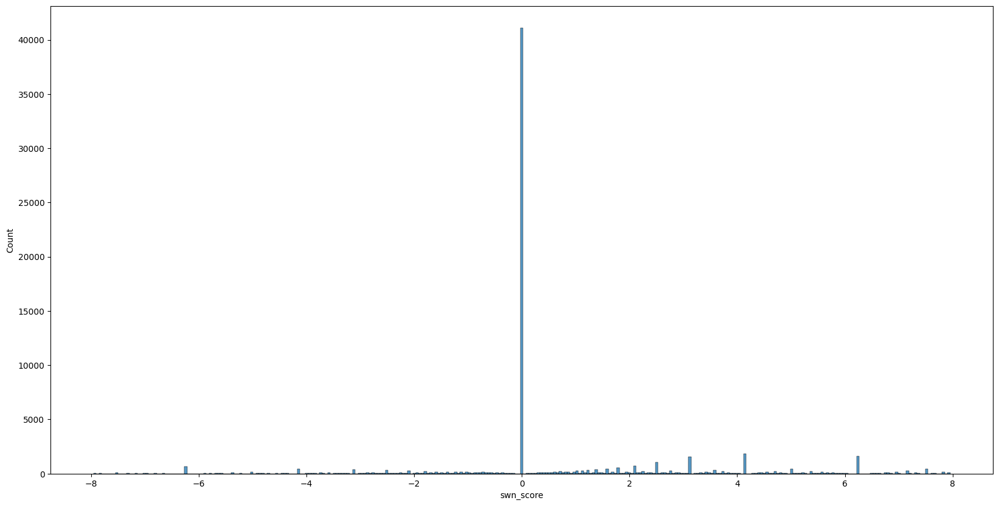

In [11]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))
sns.histplot(x='swn_score', data=reviews.query("swn_score < 8 and swn_score > -8"), ax=ax)
plt.show()

In [12]:
reviews[reviews["swn_score"] == 0].sample(10)

,content,score,swn_score
74508,Ndi makita ung comment ng mga followers ko pag nag aupload ako ng mga videos tapos wala dong notification na dumadating pag nagkocomment sila. Pakiayos po please kasi kaaupdate ko lang eh.,2,0.0
60618,✌︎,5,0.0
34357,Perfect,5,0.0
73398,Tiktok. Enough said.,1,0.0
22077,Gandaaaa ng apps nato,5,0.0
81899,Cuteee,5,0.0
80271,ShDvEh,1,0.0
17779,Nice 👍,5,0.0
50722,oky,5,0.0
61982,It's so amazing😄,5,0.0


In [13]:
reviews['swn_sentiment'] = reviews['swn_score'].apply(lambda x: "positive" if x>1 else ("negative" if x<0.5 else "neutral"))

In [14]:
reviews['swn_sentiment'].value_counts(dropna=False)

negative    52541
positive    46109
neutral      1349
Name: swn_sentiment, dtype: int64

<AxesSubplot: xlabel='score', ylabel='count'>

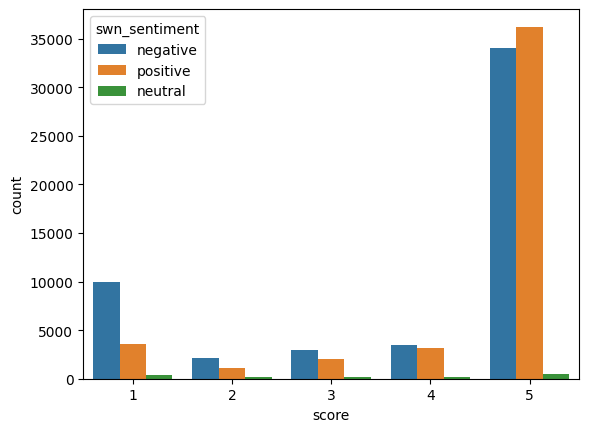

In [15]:
sns.countplot(x='score', hue='swn_sentiment' ,data = reviews)

<AxesSubplot: xlabel='swn_sentiment', ylabel='score'>

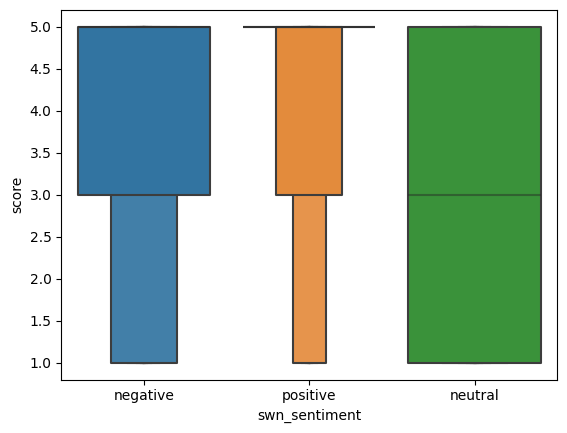

In [16]:
sns.boxenplot(x='swn_sentiment', y='score', data = reviews)

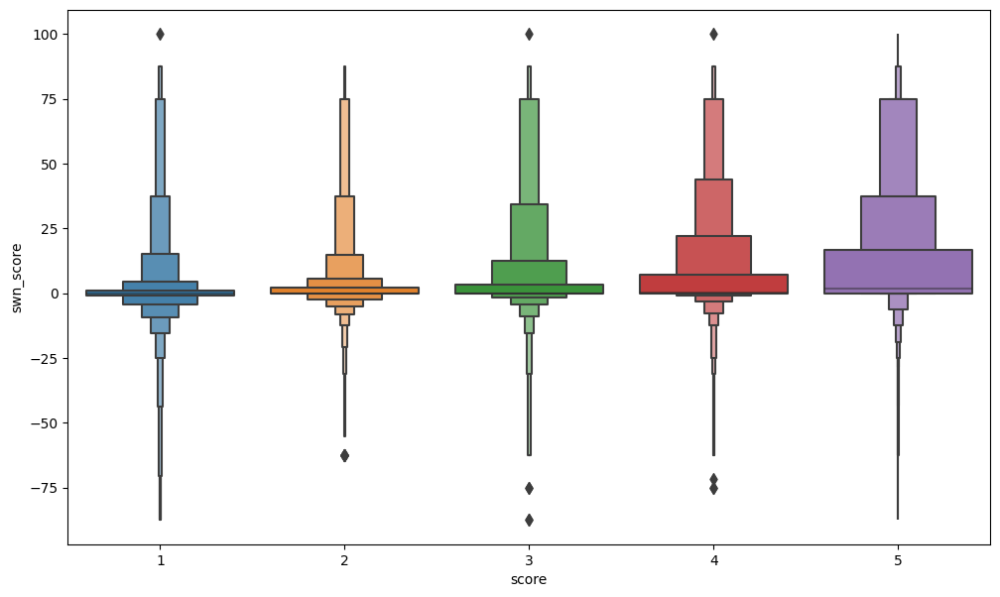

In [17]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize = (12,7))
sns.boxenplot(x='score', y='swn_score', data = reviews, ax=ax)
plt.show()

In [18]:
reviews['true_sentiment'] = \
    reviews['score'].apply(lambda x: "positive" if x>=4 else ("neutral" if x==3 else "negative"))

In [19]:
y_swn_pred, y_true = reviews['swn_sentiment'].tolist(), reviews['true_sentiment'].tolist()

In [20]:
len(y_swn_pred), len(y_true)

(99999, 99999)

In [21]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_true, y_swn_pred, labels=["negative", "neutral", "positive"])

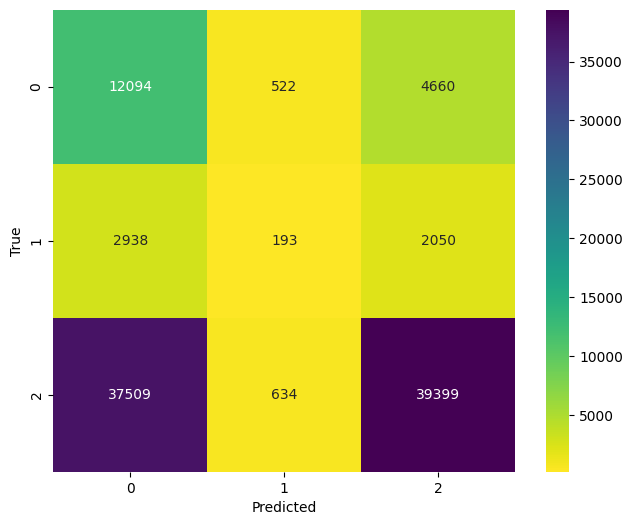

In [22]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(8,6))
sns.heatmap(cm, cmap='viridis_r', annot=True, fmt='d', square=True, ax=ax)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

## Performance Assesment

### Negative Sentiment Prediction Assessment

In [23]:
tp, tn, fp, fn = cm[0][0], cm[1][1]+cm[1][2]+cm[2][1]+cm[2][2], cm[1][0]+cm[2][0], cm[0][1]+cm[0][2]

In [24]:
recall = tp / (tp+fn)
specifity = tn / (tn+fp)
precision = tp/(tp+fp)
f1 = (2*tp) / (2*tp + fp + fn)
print("recall: {}\nprecission: {}\nf1 score: {}".format(recall, precision, f1))

recall: 0.7000463070155128
precission: 0.23018214346891
f1 score: 0.3464485726971941


### Positive Sentiment Prediction Assessment

In [25]:
tp, tn, fp, fn = cm[2][2], cm[0][0]+cm[0][1]+cm[1][0]+cm[1][1], cm[0][2]+cm[1][2], cm[2][0]+cm[2][1]

In [26]:
recall = tp / (tp+fn)
specifity = tn / (tn+fp)
precision = tp/(tp+fp)
f1 = (2*tp) / (2*tp + fp + fn)
print("recall: {}\nprecission: {}\nf1 score: {}".format(recall, precision, f1))

recall: 0.5080988367594336
precission: 0.8544752651326205
f1 score: 0.6372613242108839


A lot of reviews are not cleaned yet, resulting in mostly 0 SWN score.

## SentiWordNet with Preprocessing

In [174]:
reviews = pd.read_csv("../data/tiktok_playstore_reviews_last_100000_20220929.csv")
reviews = reviews.drop(columns=["Unnamed: 0"])

In [175]:
reviews.head()

,content,score
0,Not viral my vedios dont like tik tok,1
1,mantap,5
2,The best,5
3,Tik Tok,5
4,Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.,3


In [176]:
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])

In [177]:
# 1. Transform reviews into lower case
reviews['new_reviews'] = reviews['content'].apply(lambda x: " ".join(x.lower() for x in str(x).split()))
reviews['new_reviews'].head()

0                                                                                                                      not viral my vedios dont like tik tok
1                                                                                                                                                     mantap
2                                                                                                                                                   the best
3                                                                                                                                                    tik tok
4    please fix this bug where my account randomly logs out even though i've made sure that i'm not being hacked. makes me paranoid for some stupid reasons.
Name: new_reviews, dtype: object

In [178]:
# 2. Remove punctuation
reviews['new_reviews'] = reviews['new_reviews'].str.replace('[^\w\s]','')
reviews['new_reviews'].head()

/tmp/ipykernel_133/2722213714.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  reviews['new_reviews'] = reviews['new_reviews'].str.replace('[^\w\s]','')


0                                                                                                                  not viral my vedios dont like tik tok
1                                                                                                                                                 mantap
2                                                                                                                                               the best
3                                                                                                                                                tik tok
4    please fix this bug where my account randomly logs out even though ive made sure that im not being hacked makes me paranoid for some stupid reasons
Name: new_reviews, dtype: object

In [179]:
# 3. Remove emojis
# REFERENCE : https://gist.github.com/slowkow/7a7f61f495e3dbb7e3d767f97bd7304b
def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags 
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)
reviews['new_reviews'] = reviews['new_reviews'].apply(lambda x: remove_emoji(x))
reviews['new_reviews'].head()

0                                                                                                                  not viral my vedios dont like tik tok
1                                                                                                                                                 mantap
2                                                                                                                                               the best
3                                                                                                                                                tik tok
4    please fix this bug where my account randomly logs out even though ive made sure that im not being hacked makes me paranoid for some stupid reasons
Name: new_reviews, dtype: object

In [197]:
# 4. Remove non-english review
DetectorFactory.seed = 42

def detect_lang(sentence):
    try:
        return detect(sentence)
    except:
        return "not detected"

reviews["detected_lang"] = reviews["new_reviews"].apply(detect_lang)
reviews.drop(reviews[reviews["detected_lang"] != "en"].index, inplace=True)
reviews.head(20)

,content,score,new_reviews,detected_lang
2,The best,5,the best,en
4,Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.,3,please fix this bug where my account randomly logs out even though ive made sure that im not being hacked makes me paranoid for some stupid reasons,en
5,This nice and relaxing..application..and aim enjoying it .,5,this nice and relaxingapplicationand aim enjoying it,en
6,I'm happy,1,im happy,en
7,Why tiktok is not working in Realme C3😡 Fix it rn tysm,5,why tiktok is not working in realme c3 fix it rn tysm,en
8,Very nice app,5,very nice app,en
11,It's so much fun,5,its so much fun,en
17,I din't now how to use my accont,1,i dint now how to use my accont,en
23,"Good Presentations,Good Rating",5,good presentationsgood rating,en
25,Tik tok is becoming popular as a social media to know a fast and quick news,5,tik tok is becoming popular as a social media to know a fast and quick news,en


In [81]:
# 4. Remove stopwords (try not removing stopwords)
# stop = stopwords.words('english')
# reviews['new_reviews'] = reviews['new_reviews'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))
# reviews.head(20)

In [198]:
# 5. Lemmatization
def space(comment):
    doc = nlp(comment)
    return " ".join([token.lemma_ for token in doc])
reviews['new_reviews']= reviews['new_reviews'].apply(space)
reviews.head(20)

,content,score,new_reviews,detected_lang
2,The best,5,the good,en
4,Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.,3,please fix this bug where my account randomly log out even though I ve make sure that I m not be hack make I paranoid for some stupid reason,en
5,This nice and relaxing..application..and aim enjoying it .,5,this nice and relaxingapplicationand aim enjoy it,en
6,I'm happy,1,I m happy,en
7,Why tiktok is not working in Realme C3😡 Fix it rn tysm,5,why tiktok be not work in realme c3 fix it rn tysm,en
8,Very nice app,5,very nice app,en
11,It's so much fun,5,its so much fun,en
17,I din't now how to use my accont,1,I dint now how to use my accont,en
23,"Good Presentations,Good Rating",5,good presentationsgood rating,en
25,Tik tok is becoming popular as a social media to know a fast and quick news,5,tik tok be become popular as a social medium to know a fast and quick news,en


## SentiWordNet

In [377]:
def get_sentiment_score(text):
    
    """
        This method returns the sentiment score of a given text using SentiWordNet sentiment scores.
        input: text
        output: numeric (double) score, >0 means positive sentiment and <0 means negative sentiment.
    """    
    total_score = 0
    print(text)
    raw_sentences = sent_tokenize(text)
    print(raw_sentences)
    
    for sentence in raw_sentences:

        sent_score = 0     
        sentence = str(sentence)
        print(sentence)
#         sentence = sentence.replace("<br />"," ").translate(str.maketrans('','',punctuation)).lower()
        tokens = TreebankWordTokenizer().tokenize(text)
        tags = pos_tag(tokens)
        for word, tag in tags:
            wn_tag = penn_to_wn(tag)
            if not wn_tag:
                continue
#             lemma = WordNetLemmatizer().lemmatize(word, pos=wn_tag)
#             if not lemma:
#                 continue
            synsets = wn.synsets(word, pos=wn_tag)
            if not synsets:
                continue
            synset = synsets[0]
            swn_synset = swn.senti_synset(synset.name())
            sent_score += swn_synset.pos_score() - swn_synset.neg_score()

        total_score = total_score + (sent_score / len(tokens))

    
    return (total_score / len(raw_sentences)) * 100

In [378]:
reviews = reviews[reviews['new_reviews'].str.strip().astype(bool)]
reviews.shape

(39639, 9)

In [379]:
reviews['swn_score'] = reviews['new_reviews'].apply(lambda text : get_sentiment_score(text))

the good
['the good']
the good
please fix this bug where my account randomly log out even though I ve make sure that I m not be hack make I paranoid for some stupid reason
['please fix this bug where my account randomly log out even though I ve make sure that I m not be hack make I paranoid for some stupid reason']
please fix this bug where my account randomly log out even though I ve make sure that I m not be hack make I paranoid for some stupid reason
this nice and relaxingapplicationand aim enjoy it
['this nice and relaxingapplicationand aim enjoy it']
this nice and relaxingapplicationand aim enjoy it
I m happy
['I m happy']
I m happy
why tiktok be not work in realme c3 fix it rn tysm
['why tiktok be not work in realme c3 fix it rn tysm']
why tiktok be not work in realme c3 fix it rn tysm
very nice app
['very nice app']
very nice app
its so much fun
['its so much fun']
its so much fun
I dint now how to use my accont
['I dint now how to use my accont']
I dint now how to use my accont

I can not install it its not the storge I mean google be give I a feedback and its annoying pls fix this tiktok
['I can not install it its not the storge I mean google be give I a feedback and its annoying pls fix this tiktok']
I can not install it its not the storge I mean google be give I a feedback and its annoying pls fix this tiktok
thank you
['thank you']
thank you
I really really like this app I just love it
['I really really like this app I just love it']
I really really like this app I just love it
its good in world and I like this very much good bye
['its good in world and I like this very much good bye']
its good in world and I like this very much good bye
nice app thank
['nice app thank']
nice app thank
its very nice tho
['its very nice tho']
its very nice tho
this app be amazing ill give 5 star
['this app be amazing ill give 5 star']
this app be amazing ill give 5 star
all I can say its good app but every time I dint use my datum my filter be go
['all I can say its good ap

I love it but I install it in a long time ago
['I love it but I install it in a long time ago']
I love it but I install it in a long time ago
follow my instagram depiiq00 _ _ thnk
['follow my instagram depiiq00 _ _ thnk']
follow my instagram depiiq00 _ _ thnk
its good
['its good']
its good
help I tiktok to reach 10 m follower please   I really love the tiktok
['help I tiktok to reach 10 m follower please   I really love the tiktok']
help I tiktok to reach 10 m follower please   I really love the tiktok
its a fun app I really like it u should install it now
['its a fun app I really like it u should install it now']
its a fun app I really like it u should install it now
my tiktok can not update I do not know why and this be not first time be like this but this have happen several time before please tiktok explain to I why I can not update
['my tiktok can not update I do not know why and this be not first time be like this but this have happen several time before please tiktok explain to 

tik tok be very good but I thik it be good nor bad
['tik tok be very good but I thik it be good nor bad']
tik tok be very good but I thik it be good nor bad
thank you   and I likd it
['thank you   and I likd it']
thank you   and I likd it
it have to be update frequently
['it have to be update frequently']
it have to be update frequently
tiktok sow good and she fanny movie ilike dance
['tiktok sow good and she fanny movie ilike dance']
tiktok sow good and she fanny movie ilike dance
good app
['good app']
good app
tiktok keep ban my account
['tiktok keep ban my account']
tiktok keep ban my account
good for get out stress
['good for get out stress']
good for get out stress
app be amazing   so many video to be watch
['app be amazing   so many video to be watch']
app be amazing   so many video to be watch
its keep on force stop very annoying
['its keep on force stop very annoying']
its keep on force stop very annoying
I be just curious if you have to go through this with the sickne you have

really addict
['really addict']
really addict
amazing but ill tell you this if you have liw storage do not dowload
['amazing but ill tell you this if you have liw storage do not dowload']
amazing but ill tell you this if you have liw storage do not dowload
this tiktok be good app for my talent to many people
['this tiktok be good app for my talent to many people']
this tiktok be good app for my talent to many people
have a helpful video
['have a helpful video']
have a helpful video
I have problem with filter
['I have problem with filter']
I have problem with filter
its band my account
['its band my account']
its band my account
so entertaining and very good app I do not have a problem here if I have some concern I proceed to customer serviyand they do action immediately very nice app
['so entertaining and very good app I do not have a problem here if I have some concern I proceed to customer serviyand they do action immediately very nice app']
so entertaining and very good app I do not

its so sohappy
['its so sohappy']
its so sohappy
I know so many new place from tt
['I know so many new place from tt']
I know so many new place from tt
the good
['the good']
the good
I like this app
['I like this app']
I like this app
why I can not instal this app anymore
['why I can not instal this app anymore']
why I can not instal this app anymore
I give 5 star becoise its nice
['I give 5 star becoise its nice']
I give 5 star becoise its nice
cause its funi like this app
['cause its funi like this app']
cause its funi like this app
nice   informative short video in asia
['nice   informative short video in asia']
nice   informative short video in asia
because di will band yours acc
['because di will band yours acc']
because di will band yours acc
good app
['good app']
good app
have be get many interesting information like combat and academic thank for make this app
['have be get many interesting information like combat and academic thank for make this app']
have be get many interesti

it app in only horror video
['it app in only horror video']
it app in only horror video
I have some report like a I m read video the if I check the screen be black I can not see my recording
['I have some report like a I m read video the if I check the screen be black I can not see my recording']
I have some report like a I m read video the if I check the screen be black I can not see my recording
the good app
['the good app']
the good app
its good enough reason
['its good enough reason']
its good enough reason
good and nice experience
['good and nice experience']
good and nice experience
it suck I can not even use it it allway say I be not old enough like what the hell
['it suck I can not even use it it allway say I be not old enough like what the hell']
it suck I can not even use it it allway say I be not old enough like what the hell
I have strong connection but it will not allow I to openbut when I go out use my datum it workspls fix this tiktok
['I have strong connection but it wi

hey tiktok can you fix these 2 issue 1 if I go tiktok its lagging so hard fix this 2 if I try to edit a video it crash so fix this all problem
['hey tiktok can you fix these 2 issue 1 if I go tiktok its lagging so hard fix this 2 if I try to edit a video it crash so fix this all problem']
hey tiktok can you fix these 2 issue 1 if I go tiktok its lagging so hard fix this 2 if I try to edit a video it crash so fix this all problem
very slow la
['very slow la']
very slow la
I m addicted to this app
['I m addicted to this app']
I m addicted to this app
great and amazing
['great and amazing']
great and amazing
I like very much this app
['I like very much this app']
I like very much this app
cool
['cool']
cool
I hate this
['I hate this']
I hate this
hi tiktok ilove this beacuse this be so pretty
['hi tiktok ilove this beacuse this be so pretty']
hi tiktok ilove this beacuse this be so pretty
when I be watch video on tiktok it pause for about how many second til it resume what be happen
['whe

good app but somtimes be lag I hope we earn this app soon for video
['good app but somtimes be lag I hope we earn this app soon for video']
good app but somtimes be lag I hope we earn this app soon for video
this app be really good its just the account and some video be the problem because some video be not delete when they be inappropriate it take long time delete they and more people to see plus child be on this app even if its 13
['this app be really good its just the account and some video be the problem because some video be not delete when they be inappropriate it take long time delete they and more people to see plus child be on this app even if its 13']
this app be really good its just the account and some video be the problem because some video be not delete when they be inappropriate it take long time delete they and more people to see plus child be on this app even if its 13
more ad I do not like but the app be beautiful
['more ad I do not like but the app be beautiful']
mor

thank problem solve
['thank problem solve']
thank problem solve
I love this app couse so many friend u will get they be real   I could this game will update again so we can video call fvbbbbsnsv
['I love this app couse so many friend u will get they be real   I could this game will update again so we can video call fvbbbbsnsv']
I love this app couse so many friend u will get they be real   I could this game will update again so we can video call fvbbbbsnsv
its a great app but its a little sad that it take sooo much storage but other way it a very good app
['its a great app but its a little sad that it take sooo much storage but other way it a very good app']
its a great app but its a little sad that it take sooo much storage but other way it a very good app
I love to you this app
['I love to you this app']
I love to you this app
I like this app becouse its have many content
['I like this app becouse its have many content']
I like this app becouse its have many content
it really relieve

easy to use
['easy to use']
easy to use
I hate this app so much
['I hate this app so much']
I hate this app so much
why can not update
['why can not update']
why can not update
I really appreciate this application tiktok thank a lot I be enjoy for make videoi hope I have a little dream for my video become a trend my video thank you tiktok
['I really appreciate this application tiktok thank a lot I be enjoy for make videoi hope I have a little dream for my video become a trend my video thank you tiktok']
I really appreciate this application tiktok thank a lot I be enjoy for make videoi hope I have a little dream for my video become a trend my video thank you tiktok
I m able to use app since yesterday its show I no internet connection I m not even able to report this problem and also not able to create new account all other app be work how can I solve this issue totally frustrate
['I m able to use app since yesterday its show I no internet connection I m not even able to report this prob

I love this app
['I love this app']
I love this app
very easy to use
['very easy to use']
very easy to use
love this app soo much
['love this app soo much']
love this app soo much
ilike this app
['ilike this app']
ilike this app
wow yji si frined d
['wow yji si frined d']
wow yji si frined d
I love tiktok bat my account but my account band in no raisin
['I love tiktok bat my account but my account band in no raisin']
I love tiktok bat my account but my account band in no raisin
your stress well be go
['your stress well be go']
your stress well be go
be not but I want follower
['be not but I want follower']
be not but I want follower
its a good app for people who want to get some refreshing or get rid of boredom
['its a good app for people who want to get some refreshing or get rid of boredom']
its a good app for people who want to get some refreshing or get rid of boredom
very great
['very great']
very great
what be that you be pic
['what be that you be pic']
what be that you be pic
ta

why do you delete my account
['why do you delete my account']
why do you delete my account
I can not open this app
['I can not open this app']
I can not open this app
its nice
['its nice']
its nice
I be happy for this
['I be happy for this']
I be happy for this
this be a very good app to watch
['this be a very good app to watch']
this be a very good app to watch
this app make my day and its cool because there have a lot of video like uhmm dancing singe this app make I brave to show my talent and now I know how to dance yes I always hide my talent because I m a shy ferson and now no I m not a shy ferson anymore and anytime I always practice dance
['this app make my day and its cool because there have a lot of video like uhmm dancing singe this app make I brave to show my talent and now I know how to dance yes I always hide my talent because I m a shy ferson and now no I m not a shy ferson anymore and anytime I always practice dance']
this app make my day and its cool because there have 

I want to like and follower
['I want to like and follower']
I want to like and follower
shessh
['shessh']
shessh
please
['please']
please
diss app be sow good and nice
['diss app be sow good and nice']
diss app be sow good and nice
I do not want to update my tiktok
['I do not want to update my tiktok']
I do not want to update my tiktok
I love this app so muchhh
['I love this app so muchhh']
I love this app so muchhh
wow I love it
['wow I love it']
wow I love it
I can not open tiktokbefore iam use my mobile in india now iam in singaporei already change play store locationbut when ever openthey say no internet connection
['I can not open tiktokbefore iam use my mobile in india now iam in singaporei already change play store locationbut when ever openthey say no internet connection']
I can not open tiktokbefore iam use my mobile in india now iam in singaporei already change play store locationbut when ever openthey say no internet connection
its a good app when your boring u can use this 

I keep on reinstall the new version it be so annoying it do not work   that s why I can not watch tiktok video and so I hope it would remain as it be
['I keep on reinstall the new version it be so annoying it do not work   that s why I can not watch tiktok video and so I hope it would remain as it be']
I keep on reinstall the new version it be so annoying it do not work   that s why I can not watch tiktok video and so I hope it would remain as it be
enjoy this app because its really fun
['enjoy this app because its really fun']
enjoy this app because its really fun
I can not update the app to the late version it say that it will be instal soon in my device the question be when be that soon I always try to scroll up in my tiktok account but update notice always pop up on the screen
['I can not update the app to the late version it say that it will be instal soon in my device the question be when be that soon I always try to scroll up in my tiktok account but update notice always pop up 

I be so enjoy to watch people and dance
['I be so enjoy to watch people and dance']
I be so enjoy to watch people and dance
easy viral and fun
['easy viral and fun']
easy viral and fun
hi dearly tiktok can u update the tiktok with a messenger just like have a video call onlineoffline statuscallsend a voice messagea picture that s all advance thank u tiktok
['hi dearly tiktok can u update the tiktok with a messenger just like have a video call onlineoffline statuscallsend a voice messagea picture that s all advance thank u tiktok']
hi dearly tiktok can u update the tiktok with a messenger just like have a video call onlineoffline statuscallsend a voice messagea picture that s all advance thank u tiktok
about this app this be really good
['about this app this be really good']
about this app this be really good
a some
['a some']
a some
food
['food']
food
happy to use this app
['happy to use this app']
happy to use this app
this app be so good
['this app be so good']
this app be so good
be

very exciting
['very exciting']
very exciting
its so nice to use
['its so nice to use']
its so nice to use
love the daily trending update
['love the daily trending update']
love the daily trending update
I just love this app mic drop
['I just love this app mic drop']
I just love this app mic drop
tok tik tok delete my all of my account
['tok tik tok delete my all of my account']
tok tik tok delete my all of my account
good but too much toxic
['good but too much toxic']
good but too much toxic
its nice
['its nice']
its nice
it be actually stress reliever
['it be actually stress reliever']
it be actually stress reliever
I love to make acc and video always experience that tiktok be just a app
['I love to make acc and video always experience that tiktok be just a app']
I love to make acc and video always experience that tiktok be just a app
the filter be not good enough
['the filter be not good enough']
the filter be not good enough
this app be so beautiful
['this app be so beautiful']
thi

it be the good but I hope I gain more follow
['it be the good but I hope I gain more follow']
it be the good but I hope I gain more follow
tiktok be okay but now I m experience a problem which when I download a video it say   sd card not available   please fix this
['tiktok be okay but now I m experience a problem which when I download a video it say   sd card not available   please fix this']
tiktok be okay but now I m experience a problem which when I download a video it say   sd card not available   please fix this
it be fun
['it be fun']
it be fun
good app
['good app']
good app
shin bhone
['shin bhone']
shin bhone
I can not even download it
['I can not even download it']
I can not even download it
I love this app
['I love this app']
I love this app
bts sucks cardo pogi   update tiktok find my acc and ban I
['bts sucks cardo pogi   update tiktok find my acc and ban I']
bts sucks cardo pogi   update tiktok find my acc and ban I
why do not I have playlist
['why do not I have playlist'

ilove this
['ilove this']
ilove this
it be a 10 star app if there be more star I go viral in 3 day
['it be a 10 star app if there be more star I go viral in 3 day']
it be a 10 star app if there be more star I go viral in 3 day
my first account ban
['my first account ban']
my first account ban
thank
['thank']
thank
its good
['its good']
its good
I really love tiktok its so addicting
['I really love tiktok its so addicting']
I really love tiktok its so addicting
he always ban I
['he always ban I']
he always ban I
I can not follow a single person titkok it would just reset my following I do not know if this be a glitch but please fix it but the whole app be good alot of video and many more
['I can not follow a single person titkok it would just reset my following I do not know if this be a glitch but please fix it but the whole app be good alot of video and many more']
I can not follow a single person titkok it would just reset my following I do not know if this be a glitch but please fix

its really good
['its really good']
its really good
its fun I really ejoy use this app and its helpful to take away stress
['its fun I really ejoy use this app and its helpful to take away stress']
its fun I really ejoy use this app and its helpful to take away stress
hmmm my talent be to show to tiktok
['hmmm my talent be to show to tiktok']
hmmm my talent be to show to tiktok
stupid app keep tell I I have no internet connection in for you page even   even I see people life but my for you page do not show any single video just an error message tell I   no internet connection I have to reinstall just to make the problem go but guess what it keep come back
['stupid app keep tell I I have no internet connection in for you page even   even I see people life but my for you page do not show any single video just an error message tell I   no internet connection I have to reinstall just to make the problem go but guess what it keep come back']
stupid app keep tell I I have no internet connect

tiktok deserve a magician app of the year 2022 keep it up tiktok
['tiktok deserve a magician app of the year 2022 keep it up tiktok']
tiktok deserve a magician app of the year 2022 keep it up tiktok
good app but I rate it a 2 cause I just post a video of my pet and it get alot of view and the next day you guy suspend I temporarily and say that I do inappropriate thing and how be post a vid of a kitten with a teddy bear inappropriate please fix this glitch and suspend the poeple who actually do inappropriate stuff ill rate it high if you do thank u
['good app but I rate it a 2 cause I just post a video of my pet and it get alot of view and the next day you guy suspend I temporarily and say that I do inappropriate thing and how be post a vid of a kitten with a teddy bear inappropriate please fix this glitch and suspend the poeple who actually do inappropriate stuff ill rate it high if you do thank u']
good app but I rate it a 2 cause I just post a video of my pet and it get alot of view 

nicely this application
['nicely this application']
nicely this application
this app be good but some app be not update btw this this help I though
['this app be good but some app be not update btw this this help I though']
this app be good but some app be not update btw this this help I though
hello tiktok family sir please help sir my video do not like view sir please community gad line please set help sir thank you
['hello tiktok family sir please help sir my video do not like view sir please community gad line please set help sir thank you']
hello tiktok family sir please help sir my video do not like view sir please community gad line please set help sir thank you
good app
['good app']
good app
cancerous
['cancerous']
cancerous
waste time
['waste time']
waste time
I like this app
['I like this app']
I like this app
so goodbut she get upgrade and this app be rate 3 star
['so goodbut she get upgrade and this app be rate 3 star']
so goodbut she get upgrade and this app be rate 3 star

app be so good
['app be so good']
app be so good
this app be great and entertaining however user have to be aware for the usage and usefulness it can be commercial platform for my small business and it work well for I I use it wisely thank you to the developer for keep update new graphic field into the app that interesting
['this app be great and entertaining however user have to be aware for the usage and usefulness it can be commercial platform for my small business and it work well for I I use it wisely thank you to the developer for keep update new graphic field into the app that interesting']
this app be great and entertaining however user have to be aware for the usage and usefulness it can be commercial platform for my small business and it work well for I I use it wisely thank you to the developer for keep update new graphic field into the app that interesting
it be good but then some people acc be ban all of a sudden can you fix this alot of people work hard for their acc to g

this app be good
['this app be good']
this app be good
I love this app
['I love this app']
I love this app
good app
['good app']
good app
love the app I really like it download this right now guysss
['love the app I really like it download this right now guysss']
love the app I really like it download this right now guysss
I can not download it
['I can not download it']
I can not download it
its good
['its good']
its good
it be the vid
['it be the vid']
it be the vid
its good though
['its good though']
its good though
can u pls put a dark mode of it idk how pls tiktok
['can u pls put a dark mode of it idk how pls tiktok']
can u pls put a dark mode of it idk how pls tiktok
I just clear my cached datum and suddenly I can not log in use my facebook account I try restart my phone and still the same thing happen it just ask for my gmail and password but will not get through
['I just clear my cached datum and suddenly I can not log in use my facebook account I try restart my phone and still 

I love the app its fun lol
['I love the app its fun lol']
I love the app its fun lol
love this app 5 star
['love this app 5 star']
love this app 5 star
good app
['good app']
good app
everytime I shoot a video the audio be always delay especially when I be shoot a dance trend the audio do not always match the beat and it annoy I anytime I be hope that the tiktok experience for android preferrably those high smartphone version user will be as good as what ios experience in use the application
['everytime I shoot a video the audio be always delay especially when I be shoot a dance trend the audio do not always match the beat and it annoy I anytime I be hope that the tiktok experience for android preferrably those high smartphone version user will be as good as what ios experience in use the application']
everytime I shoot a video the audio be always delay especially when I be shoot a dance trend the audio do not always match the beat and it annoy I anytime I be hope that the tiktok experi

cool
['cool']
cool
it be not open the app I do not like it
['it be not open the app I do not like it']
it be not open the app I do not like it
I want this
['I want this']
I want this
good app for I because all people have fun to the trend and the dance be also good
['good app for I because all people have fun to the trend and the dance be also good']
good app for I because all people have fun to the trend and the dance be also good
awesome experience
['awesome experience']
awesome experience
my reply on my story do not appear nd my friend reply on my inbox also do not appear sometimes
['my reply on my story do not appear nd my friend reply on my inbox also do not appear sometimes']
my reply on my story do not appear nd my friend reply on my inbox also do not appear sometimes
amazing app for my card collection
['amazing app for my card collection']
amazing app for my card collection
I can post my self dance here I like it very much
['I can post my self dance here I like it very much']
I

on we d jan the the the the the the the the the the they be go to be a good time to get the good way
['on we d jan the the the the the the the the the the they be go to be a good time to get the good way']
on we d jan the the the the the the the the the the they be go to be a good time to get the good way
technically something wrong
['technically something wrong']
technically something wrong
I can not download it I try it so many time but it do not work
['I can not download it I try it so many time but it do not work']
I can not download it I try it so many time but it do not work
my be its good
['my be its good']
my be its good
its so good
['its so good']
its so good
its nice
['its nice']
its nice
outofthe box app and will see we through our journey in the future
['outofthe box app and will see we through our journey in the future']
outofthe box app and will see we through our journey in the future
I like this app because be good to use
['I like this app because be good to use']
I lik

I can not sign in please fix it
['I can not sign in please fix it']
I can not sign in please fix it
its cool
['its cool']
its cool
nice experience browde
['nice experience browde']
nice experience browde
when I m use this app I m enjoy to create but sometimes I feel angry because my video do not have a viewerswhat happen I do not make any violation
['when I m use this app I m enjoy to create but sometimes I feel angry because my video do not have a viewerswhat happen I do not make any violation']
when I m use this app I m enjoy to create but sometimes I feel angry because my video do not have a viewerswhat happen I do not make any violation
thank you
['thank you']
thank you
I really like this gamebut I give 4   becaus whybeacause I get bannedi do not know what I do
['I really like this gamebut I give 4   becaus whybeacause I get bannedi do not know what I do']
I really like this gamebut I give 4   becaus whybeacause I get bannedi do not know what I do
good app for mind free when you ge

super enjoy it tiktok be so much fun and less stress
['super enjoy it tiktok be so much fun and less stress']
super enjoy it tiktok be so much fun and less stress
this so so so so so so much amazing wallpaper
['this so so so so so so much amazing wallpaper']
this so so so so so so much amazing wallpaper
perfect very satisfied
['perfect very satisfied']
perfect very satisfied
I would definitely give this a 55 if tiktok would unban jeonxoxosomi
['I would definitely give this a 55 if tiktok would unban jeonxoxosomi']
I would definitely give this a 55 if tiktok would unban jeonxoxosomi
its good
['its good']
its good
when I post a 2k4k quality vid it turn to 720 when I post it and all the update include dark mode option have not be add on tiktok please give we more up date post the update asap when you post the update on io beacase there be people wait for your update and new feature and when I turn tiktok on it automatically back and when I turn it back on it keep back on and on repeatedly

why do you block I by no reson man bro this account I play a long time bro plz give it back bro I play from 2019 bro nanghx69
['why do you block I by no reson man bro this account I play a long time bro plz give it back bro I play from 2019 bro nanghx69']
why do you block I by no reson man bro this account I play a long time bro plz give it back bro I play from 2019 bro nanghx69
its so funn yeyyy
['its so funn yeyyy']
its so funn yeyyy
excellent good good love
['excellent good good love']
excellent good good love
the problem be why tiktok appear the i d not the name fix it
['the problem be why tiktok appear the i d not the name fix it']
the problem be why tiktok appear the i d not the name fix it
cool
['cool']
cool
be entertaining but lately I ve be get content that I do not likerelate to despite click on the i m not interested multiple time I still get the same content the feature seem to be useless hope this get fix otherwise I really like the app
['be entertaining but lately I ve be

I update my tiktok a few minute ago and unfortunately it turn up to be all blank pls fix it asap
['I update my tiktok a few minute ago and unfortunately it turn up to be all blank pls fix it asap']
I update my tiktok a few minute ago and unfortunately it turn up to be all blank pls fix it asap
I like this app
['I like this app']
I like this app
overall be an amazing app but I hope tiktik have the ability dispute the copy write claim music and summit the document for the right of use buside support auto horizonal would he superb
['overall be an amazing app but I hope tiktik have the ability dispute the copy write claim music and summit the document for the right of use buside support auto horizonal would he superb']
overall be an amazing app but I hope tiktik have the ability dispute the copy write claim music and summit the document for the right of use buside support auto horizonal would he superb
its a really good app to scroll with specially when you have nothing to do
['its a reall

tiktok why do you remove the upload high quality feature for android please bring it back
['tiktok why do you remove the upload high quality feature for android please bring it back']
tiktok why do you remove the upload high quality feature for android please bring it back
hello I ve be use tiktok for 3 year now but there s a problem about the comment section whenever I comment it will not show up please do fix this I really wanna respond to people but I can not my comment be not show up
['hello I ve be use tiktok for 3 year now but there s a problem about the comment section whenever I comment it will not show up please do fix this I really wanna respond to people but I can not my comment be not show up']
hello I ve be use tiktok for 3 year now but there s a problem about the comment section whenever I comment it will not show up please do fix this I really wanna respond to people but I can not my comment be not show up
temporary suppende 6months
['temporary suppende 6months']
tempora

I really enjoy watch video in tiktok
['I really enjoy watch video in tiktok']
I really enjoy watch video in tiktok
I love this app so much
['I love this app so much']
I love this app so much
due to my addiction I have to uninstall this app it be very good but some of the feature be go pls fix this
['due to my addiction I have to uninstall this app it be very good but some of the feature be go pls fix this']
due to my addiction I have to uninstall this app it be very good but some of the feature be go pls fix this
make you occupy on your free and relax time
['make you occupy on your free and relax time']
make you occupy on your free and relax time
I do not like this app I hate this app
['I do not like this app I hate this app']
I do not like this app I hate this app
I get ban for nothing tik tok I be wait you and you just money I be wait you find out of 5
['I get ban for nothing tik tok I be wait you and you just money I be wait you find out of 5']
I get ban for nothing tik tok I be wai

thank you
['thank you']
thank you
its so cool I m watch this for 5 hour
['its so cool I m watch this for 5 hour']
its so cool I m watch this for 5 hour
what s the point to have a report button in your app if you can not takedown any harmful user such a useless app
['what s the point to have a report button in your app if you can not takedown any harmful user such a useless app']
what s the point to have a report button in your app if you can not takedown any harmful user such a useless app
I do not have search   in filter
['I do not have search   in filter']
I do not have search   in filter
why there s no repost option anymore
['why there s no repost option anymore']
why there s no repost option anymore
the not interested button be useless the video with the same type still pop up on my fyp
['the not interested button be useless the video with the same type still pop up on my fyp']
the not interested button be useless the video with the same type still pop up on my fyp
I give 2 star bc

very entertaining and relax to everyone
['very entertaining and relax to everyone']
very entertaining and relax to everyone
its nice that s all
['its nice that s all']
its nice that s all
tiktok be one of the good app
['tiktok be one of the good app']
tiktok be one of the good app
this app be so fun download now this app be amazing you can upload any thing
['this app be so fun download now this app be amazing you can upload any thing']
this app be so fun download now this app be amazing you can upload any thing
this app be so good
['this app be so good']
this app be so good
I like this app my mom will not stop yell at I 247 now ಠωಠ
['I like this app my mom will not stop yell at I 247 now ಠωಠ']
I like this app my mom will not stop yell at I 247 now ಠωಠ
I do not like what be show in my fyp it often show video or live stream that be not within my interest or the type of content that I have interest in
['I do not like what be show in my fyp it often show video or live stream that be not wi

its so good to watch some asmr ty tiktok
['its so good to watch some asmr ty tiktok']
its so good to watch some asmr ty tiktok
this app be so wonderful
['this app be so wonderful']
this app be so wonderful
very awesome but there s some inappropriate for child like cuss
['very awesome but there s some inappropriate for child like cuss']
very awesome but there s some inappropriate for child like cuss
not cool the new update be not nice and easy to use because even tho I can change my birth year it still dosent approve and this be not right for a app to be like this I can not work with tiktok I m sorry but its a no for I not now
['not cool the new update be not nice and easy to use because even tho I can change my birth year it still dosent approve and this be not right for a app to be like this I can not work with tiktok I m sorry but its a no for I not now']
not cool the new update be not nice and easy to use because even tho I can change my birth year it still dosent approve and this b

great app
['great app']
great app
yo give we back the dark mode thingy plss
['yo give we back the dark mode thingy plss']
yo give we back the dark mode thingy plss
so very good app to use and give to your day be always not bored to watch
['so very good app to use and give to your day be always not bored to watch']
so very good app to use and give to your day be always not bored to watch
I can not create my account and its say sorry your not agible on tiktok
['I can not create my account and its say sorry your not agible on tiktok']
I can not create my account and its say sorry your not agible on tiktok
stop ban people not against to your community guideline
['stop ban people not against to your community guideline']
stop ban people not against to your community guideline
tiktok the good app in the world
['tiktok the good app in the world']
tiktok the good app in the world
happy and content
['happy and content']
happy and content
thank
['thank']
thank
I can not log in it always say too 

I hate this app
['I hate this app']
I hate this app
its good tho bit I love it
['its good tho bit I love it']
its good tho bit I love it
iwant to be famous
['iwant to be famous']
iwant to be famous
so I ve be use tiktok for 1 year and month and its pretty good I love it
['so I ve be use tiktok for 1 year and month and its pretty good I love it']
so I ve be use tiktok for 1 year and month and its pretty good I love it
I give 3 star cause the new filter I connot see
['I give 3 star cause the new filter I connot see']
I give 3 star cause the new filter I connot see
for the first time I usei feel happy and enjoy with it but yesterday when I open tiktok my account suddenly log out when I want to log inthe pop up message come and it write my account permanently ban but I be not do any wrong or upload any bad video my account suspendedi have already make a report for your helptiktok but you can not solve it I can not get back my account and all my video my datum and privacy be insecurevery ba

good app thes all
['good app thes all']
good app thes all
neither my friend and I receive any notification when we tag each other this have happen for month now please fix
['neither my friend and I receive any notification when we tag each other this have happen for month now please fix']
neither my friend and I receive any notification when we tag each other this have happen for month now please fix
I m super funny this app and when I m bore an open it this app
['I m super funny this app and when I m bore an open it this app']
I m super funny this app and when I m bore an open it this app
this so much fun
['this so much fun']
this so much fun
I like this app because this app will help I to injoy you can see I and I can see you tomorrow haha okay   love you and I will be guide to the next few day and time that nice to hear that you be not filter into your account can and will not have a great day ko oiii ma ou have any question or need more information about the young good friend mo an

yes please
['yes please']
yes please
usefull
['usefull']
usefull
hey I would like to say that tiktok be my favorite app at most but I like to repost some obscnene content please tiktok remove that kind of video because it so lame and tiktok please stop ban some accountthank you
['hey I would like to say that tiktok be my favorite app at most but I like to repost some obscnene content please tiktok remove that kind of video because it so lame and tiktok please stop ban some accountthank you']
hey I would like to say that tiktok be my favorite app at most but I like to repost some obscnene content please tiktok remove that kind of video because it so lame and tiktok please stop ban some accountthank you
I love watch video
['I love watch video']
I love watch video
good app
['good app']
good app
I keep on reinstall it bc when I search on it video do not apear its only sound user and hashtag like what s go on
['I keep on reinstall it bc when I search on it video do not apear its only sound 

its really cool tho but please ban the most toxic tiktoker
['its really cool tho but please ban the most toxic tiktoker']
its really cool tho but please ban the most toxic tiktoker
the good
['the good']
the good
free
['free']
free
be soo cool
['be soo cool']
be soo cool
its so very very good I enjoy it
['its so very very good I enjoy it']
its so very very good I enjoy it
I love tiktok be so beautiful and follow I in tiktok copy link too
['I love tiktok be so beautiful and follow I in tiktok copy link too']
I love tiktok be so beautiful and follow I in tiktok copy link too
I do not have the clear mode update
['I do not have the clear mode update']
I do not have the clear mode update
di so good for people
['di so good for people']
di so good for people
wow pls helpme for downlad thisthnksimsofroud of tiktok
['wow pls helpme for downlad thisthnksimsofroud of tiktok']
wow pls helpme for downlad thisthnksimsofroud of tiktok
its so good
['its so good']
its so good
iloveee itit very happy to 

when I first time see this app its so cool and amazing but suddenly when I unstall and download again when I create a account with facebook she say what your birthday and when I agree she say oops your not at tiktok people then I can not make a account so 2 rate for this and when I want to unstall I can not unstall the tiktok so my phone full and my game be 1 now because of the tiktok so please fix my account
['when I first time see this app its so cool and amazing but suddenly when I unstall and download again when I create a account with facebook she say what your birthday and when I agree she say oops your not at tiktok people then I can not make a account so 2 rate for this and when I want to unstall I can not unstall the tiktok so my phone full and my game be 1 now because of the tiktok so please fix my account']
when I first time see this app its so cool and amazing but suddenly when I unstall and download again when I create a account with facebook she say what your birthday and

I love this app
['I love this app']
I love this app
hey ban all user with innocent video but on other with sexual video do not ban what be wrong with you hire some human not bot
['hey ban all user with innocent video but on other with sexual video do not ban what be wrong with you hire some human not bot']
hey ban all user with innocent video but on other with sexual video do not ban what be wrong with you hire some human not bot
excellent thank for accept I here   
['excellent thank for accept I here']
excellent thank for accept I here
its so you know
['its so you know']
its so you know
I enjoy watch how to cook and etc
['I enjoy watch how to cook and etc']
I enjoy watch how to cook and etc
I love it I enjoy use this app
['I love it I enjoy use this app']
I love it I enjoy use this app
my tiktok account get ban bcs I have account warning in my profile
['my tiktok account get ban bcs I have account warning in my profile']
my tiktok account get ban bcs I have account warning in my profi

I love this app
['I love this app']
I love this app
I ve be uninstalle the app accidentally and I ve try to install it again why it do not worki coundnt install it
['I ve be uninstalle the app accidentally and I ve try to install it again why it do not worki coundnt install it']
I ve be uninstalle the app accidentally and I ve try to install it again why it do not worki coundnt install it
this app be cool
['this app be cool']
this app be cool
I just love it butplease make mutual section at follower section
['I just love it butplease make mutual section at follower section']
I just love it butplease make mutual section at follower section
great app
['great app']
great app
very good app I like it so much
['very good app I like it so much']
very good app I like it so much
cool
['cool']
cool
why can not instal why
['why can not instal why']
why can not instal why
account warning
['account warning']
account warning
always shadowbann and I m not rude on tiktok but I m shadow
['always shadowb

good app
['good app']
good app
why you ban my sister account huh why asher_gacha huh why
['why you ban my sister account huh why asher_gacha huh why']
why you ban my sister account huh why asher_gacha huh why
I m go to pack my thing and leave you behind because would I pay when you shadow my self but I love so
['I m go to pack my thing and leave you behind because would I pay when you shadow my self but I love so']
I m go to pack my thing and leave you behind because would I pay when you shadow my self but I love so
I love this app
['I love this app']
I love this app
this app be so much fun
['this app be so much fun']
this app be so much fun
its so beautiful
['its so beautiful']
its so beautiful
I can not do live even I already have 3000 follower and on a legal age
['I can not do live even I already have 3000 follower and on a legal age']
I can not do live even I already have 3000 follower and on a legal age
its so very nice app
['its so very nice app']
its so very nice app
toxic app
[

its very perfotment
['its very perfotment']
its very perfotment
great app my only problem right now be that the video I upload become low quality be it my phone how do I fix this
['great app my only problem right now be that the video I upload become low quality be it my phone how do I fix this']
great app my only problem right now be that the video I upload become low quality be it my phone how do I fix this
the app be amazing great content from entertainment to informational my only concern be that my search bar be not show it all only usershashtagsound be show and its frustrating for I to search for video because its limited I can not browse the vidoe I want nor the audio I ve be deal this for quite some time and I m just hope it would be back by update yet still do not I hope you ll fix this
['the app be amazing great content from entertainment to informational my only concern be that my search bar be not show it all only usershashtagsound be show and its frustrating for I to searc

I just do not like that you take down my vid for no reason even tho I have not violate any community guideline while you guy do not ban the people who do violate the guideline
['I just do not like that you take down my vid for no reason even tho I have not violate any community guideline while you guy do not ban the people who do violate the guideline']
I just do not like that you take down my vid for no reason even tho I have not violate any community guideline while you guy do not ban the people who do violate the guideline
app lag especially after log with facebook sometimes login with facebook cause app hang infinitely on vivo 1820 2 gb ram
['app lag especially after log with facebook sometimes login with facebook cause app hang infinitely on vivo 1820 2 gb ram']
app lag especially after log with facebook sometimes login with facebook cause app hang infinitely on vivo 1820 2 gb ram
the app so very very good it so hood to I bless
['the app so very very good it so hood to I bless']
t

for you pageရကစမfypplease
['for you pageရကစမfypplease']
for you pageရကစမfypplease
my tiktok account be famous thank you for the beautiful app ily
['my tiktok account be famous thank you for the beautiful app ily']
my tiktok account be famous thank you for the beautiful app ily
I think you should add a history option sometimes I accidently press the refresh button and the video go
['I think you should add a history option sometimes I accidently press the refresh button and the video go']
I think you should add a history option sometimes I accidently press the refresh button and the video go
I love this app
['I love this app']
I love this app
good for a lot of free time
['good for a lot of free time']
good for a lot of free time
new app
['new app']
new app
I want you to please take this away your tapping so fast take a break literally its be 8 hour since you guy do not let I like anybody video because this thing be stop I and its kinda annoying if your help anybody with low creator with 

I have a lot of follower but I m band
['I have a lot of follower but I m band']
I have a lot of follower but I m band
I like tiktok tiktok be the good I want to be famous like the other this app its good
['I like tiktok tiktok be the good I want to be famous like the other this app its good']
I like tiktok tiktok be the good I want to be famous like the other this app its good
his be cool I love it but my follower be to low
['his be cool I love it but my follower be to low']
his be cool I love it but my follower be to low
they still allow some pay troll and content user to share misinformation and misleading content
['they still allow some pay troll and content user to share misinformation and misleading content']
they still allow some pay troll and content user to share misinformation and misleading content
good app
['good app']
good app
thank you
['thank you']
thank you
good service
['good service']
good service
this platform be use as a tool to spread fake news and black propaganda 

a very good app
['a very good app']
a very good app
great app there that you can video your self and more video of people and even my favorite be likeng all the video
['great app there that you can video your self and more video of people and even my favorite be likeng all the video']
great app there that you can video your self and more video of people and even my favorite be likeng all the video
I love this kind of platform
['I love this kind of platform']
I love this kind of platform
awesome I love the promotion feature of the app more power
['awesome I love the promotion feature of the app more power']
awesome I love the promotion feature of the app more power
I love it wow
['I love it wow']
I love it wow
love it very versatile except it would be well if link be clickable under comment like reel in fb
['love it very versatile except it would be well if link be clickable under comment like reel in fb']
love it very versatile except it would be well if link be clickable under comment

tiktok be realy nice and enjoy
['tiktok be realy nice and enjoy']
tiktok be realy nice and enjoy
tiktok you ban all my acc I know I m a kid but I do not find a reason to ban I I hate this app and I do not do anything unrespecfull so just pls back my acc I try so hard to get some follower but I do not rate this 1 I rate 0 but I can not so I rate this
['tiktok you ban all my acc I know I m a kid but I do not find a reason to ban I I hate this app and I do not do anything unrespecfull so just pls back my acc I try so hard to get some follower but I do not rate this 1 I rate 0 but I can not so I rate this']
tiktok you ban all my acc I know I m a kid but I do not find a reason to ban I I hate this app and I do not do anything unrespecfull so just pls back my acc I try so hard to get some follower but I do not rate this 1 I rate 0 but I can not so I rate this
great app to use very entertaining and useful for business market my favorite part be diy video at the same time so entertaining
['gre

app can not downlod
['app can not downlod']
app can not downlod
very great full app
['very great full app']
very great full app
I love this app and I hope people love this app
['I love this app and I hope people love this app']
I love this app and I hope people love this app
I can not have the new filter ol fix this
['I can not have the new filter ol fix this']
I can not have the new filter ol fix this
good app
['good app']
good app
thank for the app
['thank for the app']
thank for the app
its a great app
['its a great app']
its a great app
when one of my accs be ban due to multiple violation I can not log in any of my other account the app itself be very good I just have that one problemi need the help so much
['when one of my accs be ban due to multiple violation I can not log in any of my other account the app itself be very good I just have that one problemi need the help so much']
when one of my accs be ban due to multiple violation I can not log in any of my other account the app

wowwwwwwcooooollllllllll
['wowwwwwwcooooollllllllll']
wowwwwwwcooooollllllllll
I really like this app alot I m so addicted to the app so much that I spend my free time scroll in the app and I do not see any problem or bug and I recommend this app I give it 5 star
['I really like this app alot I m so addicted to the app so much that I spend my free time scroll in the app and I do not see any problem or bug and I recommend this app I give it 5 star']
I really like this app alot I m so addicted to the app so much that I spend my free time scroll in the app and I do not see any problem or bug and I recommend this app I give it 5 star
I m totally enjoy and stress free    
['I m totally enjoy and stress free']
I m totally enjoy and stress free
hey tiktok what happend to you my video have no view and no comment and no like what the hell
['hey tiktok what happend to you my video have no view and no comment and no like what the hell']
hey tiktok what happend to you my video have no view and no 

I do not have fan in tiktok its hard to have ah fan
['I do not have fan in tiktok its hard to have ah fan']
I do not have fan in tiktok its hard to have ah fan
I give 3 star because this app be fun but my acc be in account warning   but I do not make a content that against the community guideline my content be similar to other but there acc be no violation
['I give 3 star because this app be fun but my acc be in account warning   but I do not make a content that against the community guideline my content be similar to other but there acc be no violation']
I give 3 star because this app be fun but my acc be in account warning   but I do not make a content that against the community guideline my content be similar to other but there acc be no violation
the app be very space consume my phone be run out of space because of the new update
['the app be very space consume my phone be run out of space because of the new update']
the app be very space consume my phone be run out of space becaus

its so happy
['its so happy']
its so happy
sofisticate and satisfying and educational
['sofisticate and satisfying and educational']
sofisticate and satisfying and educational
many update but still have unfair community guideline   reason why you have low rating
['many update but still have unfair community guideline   reason why you have low rating']
many update but still have unfair community guideline   reason why you have low rating
I can not log in because it keep say I m underage or not eligible even though I m 13 year old please fix this
['I can not log in because it keep say I m underage or not eligible even though I m 13 year old please fix this']
I can not log in because it keep say I m underage or not eligible even though I m 13 year old please fix this
think you
['think you']
think you
love the app it have so many video and so many people to interact with its like heaven tiktok practically save my life when I be bored the app be amazing
['love the app it have so many video 

I like it but its too many bad word
['I like it but its too many bad word']
I like it but its too many bad word
dis app its so god
['dis app its so god']
dis app its so god
I lovelike the tiktok and its okay to use but I only have one probem my problem be if I m do some video to post it on my acc the camera be lag
['I lovelike the tiktok and its okay to use but I only have one probem my problem be if I m do some video to post it on my acc the camera be lag']
I lovelike the tiktok and its okay to use but I only have one probem my problem be if I m do some video to post it on my acc the camera be lag
very well app
['very well app']
very well app
I love this app so much you can watch create and so many more
['I love this app so much you can watch create and so many more']
I love this app so much you can watch create and so many more
this be my homietiktok your my fav apppls this be my last acc do not ban this I know I m under 13 yr old but I have respect for my body and plss do not ban th

bring back watch history
['bring back watch history']
bring back watch history
good app
['good app']
good app
my old video be go
['my old video be go']
my old video be go
well than facebook
['well than facebook']
well than facebook
this make my storage full but who care I get load with bts video from this app xddddd good app in my opinion but please take action to disgusting video and hashtag like the bld in kpop fanpage its really bad especially since there s a lot of kid user in this app please give they a warning when they post smthn bad take action immediately because it make kid learn bad stuff because of video like that please and it will continue if you guy do not take action asap
['this make my storage full but who care I get load with bts video from this app xddddd good app in my opinion but please take action to disgusting video and hashtag like the bld in kpop fanpage its really bad especially since there s a lot of kid user in this app please give they a warning when they p

sometimes its make alot of fun
['sometimes its make alot of fun']
sometimes its make alot of fun
wow soy ameyse
['wow soy ameyse']
wow soy ameyse
the apk si really really good
['the apk si really really good']
the apk si really really good
cool
['cool']
cool
I m happy now thank you for the great news about your new job bye love you
['I m happy now thank you for the great news about your new job bye love you']
I m happy now thank you for the great news about your new job bye love you
not change my rating until you put back watch history
['not change my rating until you put back watch history']
not change my rating until you put back watch history
I really like it but I wish I could be famous like just a little be fine nanachan443 my content be about voice act i wanna be a voice actor in the future I wanna grow my acc I m alright have 1000 or 900 follower I m happy with that or maybe no I just want ppl to love my voice act
['I really like it but I wish I could be famous like just a littl

the algorithm suck fix it
['the algorithm suck fix it']
the algorithm suck fix it
good app to relax and feel you
['good app to relax and feel you']
good app to relax and feel you
overall good but I want the text to speech with multiple type of voice to be available in android
['overall good but I want the text to speech with multiple type of voice to be available in android']
overall good but I want the text to speech with multiple type of voice to be available in android
my favorite app
['my favorite app']
my favorite app
very cool
['very cool']
very cool
its a great app extremely satisfied I love tiktok so much
['its a great app extremely satisfied I love tiktok so much']
its a great app extremely satisfied I love tiktok so much
I really like this app omg
['I really like this app omg']
I really like this app omg
its quite thrilling application
['its quite thrilling application']
its quite thrilling application
it keep I out I be watch some of my video
['it keep I out I be watch some 

so sad discover tab be not there anymore and replace with friend tab also can not trim audio
['so sad discover tab be not there anymore and replace with friend tab also can not trim audio']
so sad discover tab be not there anymore and replace with friend tab also can not trim audio
nice thing
['nice thing']
nice thing
this app be so beautiful I love it so much
['this app be so beautiful I love it so much']
this app be so beautiful I love it so much
unbelievable app very nice and   fantastic
['unbelievable app very nice and   fantastic']
unbelievable app very nice and   fantastic
I iove this app since 2020
['I iove this app since 2020']
I iove this app since 2020
great app
['great app']
great app
love this app so much
['love this app so much']
love this app so much
good experience
['good experience']
good experience
I glue my 2 friend dick together with my cum
['I glue my 2 friend dick together with my cum']
I glue my 2 friend dick together with my cum
so good app
['so good app']
so goo

tiktok why you ban I why plss back my account or I will delete tiktok
['tiktok why you ban I why plss back my account or I will delete tiktok']
tiktok why you ban I why plss back my account or I will delete tiktok
the good
['the good']
the good
I love this app but my account get something problem and many time I requisite to solve my problem but until now not yet solve still have problem I m try ready
['I love this app but my account get something problem and many time I requisite to solve my problem but until now not yet solve still have problem I m try ready']
I love this app but my account get something problem and many time I requisite to solve my problem but until now not yet solve still have problem I m try ready
hello tiktok why can not I log in to my fb account
['hello tiktok why can not I log in to my fb account']
hello tiktok why can not I log in to my fb account
bad experience for the past few month I have an account and I ve notice that I lose a big amount of follower every

hi tiktok can you add the watch history button on android device so that I can check the past video that I want to removed and rewatch from it
['hi tiktok can you add the watch history button on android device so that I can check the past video that I want to removed and rewatch from it']
hi tiktok can you add the watch history button on android device so that I can check the past video that I want to removed and rewatch from it
I love it this app help I
['I love it this app help I']
I love it this app help I
at least now l be able to go live everyday get new follower and make some cash through my life
['at least now l be able to go live everyday get new follower and make some cash through my life']
at least now l be able to go live everyday get new follower and make some cash through my life
I m use this for almost 3year
['I m use this for almost 3year']
I m use this for almost 3year
this be so pretty app when your bore just open this app and watch video like thatand my idol be here t

something wrong with tiktok my account have be violate multiple time even tho I m just dance and lipsynce
['something wrong with tiktok my account have be violate multiple time even tho I m just dance and lipsynce']
something wrong with tiktok my account have be violate multiple time even tho I m just dance and lipsynce
I like this app
['I like this app']
I like this app
thank I love it
['thank I love it']
thank I love it
I send a report and I wait 48h and then nothing happen please fix this tiktok
['I send a report and I wait 48h and then nothing happen please fix this tiktok']
I send a report and I wait 48h and then nothing happen please fix this tiktok
stress free
['stress free']
stress free
this app so beutiful
['this app so beutiful']
this app so beutiful
sorry to say but low content quality
['sorry to say but low content quality']
sorry to say but low content quality
very good appswe love it
['very good appswe love it']
very good appswe love it
its great that there s a favorite o

the good app u can injoy
['the good app u can injoy']
the good app u can injoy
my safe place
['my safe place']
my safe place
tiktok please notice I have do some report about my refund that I do not get from march until now I do not get my refund please take note
['tiktok please notice I have do some report about my refund that I do not get from march until now I do not get my refund please take note']
tiktok please notice I have do some report about my refund that I do not get from march until now I do not get my refund please take note
I m happy for this app
['I m happy for this app']
I m happy for this app
so log very 7890log this be my husei have 3 house
['so log very 7890log this be my husei have 3 house']
so log very 7890log this be my husei have 3 house
good app
['good app']
good app
this app be great but why I can not start a live I have already 1k follower what s go on I report a problem so many time but seem like they do not want I to start a live
['this app be great but why I

I like this app
['I like this app']
I like this app
thank you
['thank you']
thank you
helpful
['helpful']
helpful
this be so good
['this be so good']
this be so good
I can not upload anymore why my tiktok bug it freeze and can not click anything I hate the update the way you edit I hate tiktok now
['I can not upload anymore why my tiktok bug it freeze and can not click anything I hate the update the way you edit I hate tiktok now']
I can not upload anymore why my tiktok bug it freeze and can not click anything I hate the update the way you edit I hate tiktok now
when I draft my video it always say something go wrong it I can draft my video
['when I draft my video it always say something go wrong it I can draft my video']
when I draft my video it always say something go wrong it I can draft my video
I give this 1 star cause why this be something bug I can not even login or sign up pls fix this
['I give this 1 star cause why this be something bug I can not even login or sign up pls fix t

I do not like the new update everyone see how many people have favorite my vidthere should be private how many people fav your vidand the soundi can not control the volume of the sound
['I do not like the new update everyone see how many people have favorite my vidthere should be private how many people fav your vidand the soundi can not control the volume of the sound']
I do not like the new update everyone see how many people have favorite my vidthere should be private how many people fav your vidand the soundi can not control the volume of the sound
high
['high']
high
its a verry nice
['its a verry nice']
its a verry nice
ang cute asin sobrang cute bye guy atsaka install na face emoji
['ang cute asin sobrang cute bye guy atsaka install na face emoji']
ang cute asin sobrang cute bye guy atsaka install na face emoji
this be a great app but I have some recommendation 1 can you put a feature on tiktok where you can send image and take photo pls and no2 be when we can send voice message 

why my tiktok camera be lag pls fix this immediately I can not record properly
['why my tiktok camera be lag pls fix this immediately I can not record properly']
why my tiktok camera be lag pls fix this immediately I can not record properly
please
['please']
please
its so beautiful and I love this app
['its so beautiful and I love this app']
its so beautiful and I love this app
I love this app very much
['I love this app very much']
I love this app very much
I love this app nothing to say ilove it
['I love this app nothing to say ilove it']
I love this app nothing to say ilove it
I like this one
['I like this one']
I like this one
I appreciate more like with my vid
['I appreciate more like with my vid']
I appreciate more like with my vid
be fun
['be fun']
be fun
its make I more fun and it will be my past time
['its make I more fun and it will be my past time']
its make I more fun and it will be my past time
I m not able to create account not even the birth I m on samsung galaxy a73 hel

useful
['useful']
useful
this app be such a good appcoz this be exciting and enjoyable I love it
['this app be such a good appcoz this be exciting and enjoyable I love it']
this app be such a good appcoz this be exciting and enjoyable I love it
it be easy convenience and reliable happy   enjoy
['it be easy convenience and reliable happy   enjoy']
it be easy convenience and reliable happy   enjoy
for I this be my comfort app
['for I this be my comfort app']
for I this be my comfort app
this app be cool u can dance sing and everything
['this app be cool u can dance sing and everything']
this app be cool u can dance sing and everything
my 2 account just get ban just in 2 month but I like the app
['my 2 account just get ban just in 2 month but I like the app']
my 2 account just get ban just in 2 month but I like the app
this app be so bored and its ban I for no reason do not download this
['this app be so bored and its ban I for no reason do not download this']
this app be so bored and its

very nice application in whole world
['very nice application in whole world']
very nice application in whole world
I m happy
['I m happy']
I m happy
I love it   tiktok be the good
['I love it   tiktok be the good']
I love it   tiktok be the good
I love this app so much but right now in my samsung galaxy j3 2016 I can not install this app for how many time can you fix this problem
['I love this app so much but right now in my samsung galaxy j3 2016 I can not install this app for how many time can you fix this problem']
I love this app so much but right now in my samsung galaxy j3 2016 I can not install this app for how many time can you fix this problem
I enjoy play ticktok   I want to broadcast it live with my friend   please help I to broadcast it live   your ticktok
['I enjoy play ticktok   I want to broadcast it live with my friend   please help I to broadcast it live   your ticktok']
I enjoy play ticktok   I want to broadcast it live with my friend   please help I to broadcast it l

this app be cool but why do the watch history removedplease add it again I still do not have the playlist option in my device it blow up my storage for 1 month after use the app forget the last and add the other two pls ty
['this app be cool but why do the watch history removedplease add it again I still do not have the playlist option in my device it blow up my storage for 1 month after use the app forget the last and add the other two pls ty']
this app be cool but why do the watch history removedplease add it again I still do not have the playlist option in my device it blow up my storage for 1 month after use the app forget the last and add the other two pls ty
download and immediately regret it
['download and immediately regret it']
download and immediately regret it
good for stress
['good for stress']
good for stress
I hate now I do not have playlist feature tiktok fix this do all user have a playlist no matter do not have follower this be unfair
['I hate now I do not have playlis

nice app I know many video from here
['nice app I know many video from here']
nice app I know many video from here
tiktok na ban yung account ko please help I
['tiktok na ban yung account ko please help I']
tiktok na ban yung account ko please help I
its really ok app
['its really ok app']
its really ok app
its so very useful
['its so very useful']
its so very useful
tiktok be crash
['tiktok be crash']
tiktok be crash
ilove this app
['ilove this app']
ilove this app
this tiktok be berry pretty and suber duper experience just like the other side effect on the show and shea butter have be
['this tiktok be berry pretty and suber duper experience just like the other side effect on the show and shea butter have be']
this tiktok be berry pretty and suber duper experience just like the other side effect on the show and shea butter have be
oh my god   tiktok its so very very funny I wish I can buy
['oh my god   tiktok its so very very funny I wish I can buy']
oh my god   tiktok its so very ver

I m make another acc for my mom   she s 40 btw and when I tap here birthday 1977 july 4th it always say that look like your not eligible to use the app
['I m make another acc for my mom   she s 40 btw and when I tap here birthday 1977 july 4th it always say that look like your not eligible to use the app']
I m make another acc for my mom   she s 40 btw and when I tap here birthday 1977 july 4th it always say that look like your not eligible to use the app
pls tiktok do not ban my acc again pls
['pls tiktok do not ban my acc again pls']
pls tiktok do not ban my acc again pls
good app
['good app']
good app
this be amazing  
['this be amazing']
this be amazing
its good
['its good']
its good
this be so beutiful tiktok ever
['this be so beutiful tiktok ever']
this be so beutiful tiktok ever
its so cool
['its so cool']
its so cool
girl yes I love put snake in my birthjayna
['girl yes I love put snake in my birthjayna']
girl yes I love put snake in my birthjayna
great app
['great app']
great 

nice for past time and if you want to enjoy in just a 13minute video
['nice for past time and if you want to enjoy in just a 13minute video']
nice for past time and if you want to enjoy in just a 13minute video
I can not make a account because I m egibile on tiktok please fix this problem
['I can not make a account because I m egibile on tiktok please fix this problem']
I can not make a account because I m egibile on tiktok please fix this problem
thes tiktok be a beutifull app
['thes tiktok be a beutifull app']
thes tiktok be a beutifull app
its very nice to other to dance
['its very nice to other to dance']
its very nice to other to dance
bad app
['bad app']
bad app
easy to view and easy to use
['easy to view and easy to use']
easy to view and easy to use
why do you give no violation notice to the content that user already report for sexual objectificaton you can see that many user report babyca666 for her content
['why do you give no violation notice to the content that user already

young people
['young people']
young people
some filter be not avail on android do not you gusy think this be not fair haha bruh
['some filter be not avail on android do not you gusy think this be not fair haha bruh']
some filter be not avail on android do not you gusy think this be not fair haha bruh
take up to much storage
['take up to much storage']
take up to much storage
I like the app but when I open the comment my app will crash so I m vote it four
['I like the app but when I open the comment my app will crash so I m vote it four']
I like the app but when I open the comment my app will crash so I m vote it four
if my friend in tiktok message I its late to notify I and its late to update
['if my friend in tiktok message I its late to notify I and its late to update']
if my friend in tiktok message I its late to notify I and its late to update
a poison for humanity
['a poison for humanity']
a poison for humanity
such a amazing app
['such a amazing app']
such a amazing app
I love th

easy to create video
['easy to create video']
easy to create video
I love it so much I can whatch all I want
['I love it so much I can whatch all I want']
I love it so much I can whatch all I want
this app be so nice
['this app be so nice']
this app be so nice
someone ban I from the app I give it 1 star
['someone ban I from the app I give it 1 star']
someone ban I from the app I give it 1 star
suck
['suck']
suck
I love this one
['I love this one']
I love this one
I like this app because I can search all of we be dead
['I like this app because I can search all of we be dead']
I like this app because I can search all of we be dead
I can not follow it say something go wrong
['I can not follow it say something go wrong']
I can not follow it say something go wrong
its just my first time to update this tiktok but there so many issue
['its just my first time to update this tiktok but there so many issue']
its just my first time to update this tiktok but there so many issue
I love this app but

I hate this app it always say ur not edigible for this app   but I try every time and it will not let I make a acc in tiktok so I hate it pls fix the bug pls cause my friend ask I to download it so please fix it
['I hate this app it always say ur not edigible for this app   but I try every time and it will not let I make a acc in tiktok so I hate it pls fix the bug pls cause my friend ask I to download it so please fix it']
I hate this app it always say ur not edigible for this app   but I try every time and it will not let I make a acc in tiktok so I hate it pls fix the bug pls cause my friend ask I to download it so please fix it
this app be make happy
['this app be make happy']
this app be make happy
musically be well
['musically be well']
musically be well
great app
['great app']
great app
could not share video to tiktok friend even wifi connection be perfectly fine try clear cache unsinstall and install
['could not share video to tiktok friend even wifi connection be perfectly fin

the tick be fool around
['the tick be fool around']
the tick be fool around
super super I like it and more update to come
['super super I like it and more update to come']
super super I like it and more update to come
it good but the new update I can not update the tiktok
['it good but the new update I can not update the tiktok']
it good but the new update I can not update the tiktok
I like this app very much its nice u can have a supporter
['I like this app very much its nice u can have a supporter']
I like this app very much its nice u can have a supporter
this app be good but there s only a small problem its when I can not swipe the photo in the video which be quite a bit annoying but when u report some thing that be inppropriate it do not work so its a bit bad and please bring back the gacha please the hastag bring it back without the gacha we will not able to put gacha if you remove it because you think its inppropriate well its not so bring back it okay hope u fix it
['this app b

he s ok but he s always ban
['he s ok but he s always ban']
he s ok but he s always ban
cool
['cool']
cool
its a great entertaining app but why I can not see the new feature like who view my profile
['its a great entertaining app but why I can not see the new feature like who view my profile']
its a great entertaining app but why I can not see the new feature like who view my profile
I m not new to tiktok I srte tiktok in 2019 but the app jsut delete on they own idk why but I give it 5 star cuz its a super viral app and its good
['I m not new to tiktok I srte tiktok in 2019 but the app jsut delete on they own idk why but I give it 5 star cuz its a super viral app and its good']
I m not new to tiktok I srte tiktok in 2019 but the app jsut delete on they own idk why but I give it 5 star cuz its a super viral app and its good
this app be amazing I like this app and capcut
['this app be amazing I like this app and capcut']
this app be amazing I like this app and capcut
yes I love tiktok th

wow this app be really cool I like it
['wow this app be really cool I like it']
wow this app be really cool I like it
this app so good
['this app so good']
this app so good
hi goodmorne good afternoon or goodnight this be a great app but when I press the timer button it will stop and I can not press any button so imma have to retry recording again and somtime its lagging and the quality of the cam be low quality my camera be high quality but when I record at this app its low quality I just want u guy fix the camera of this app but this be a great app
['hi goodmorne good afternoon or goodnight this be a great app but when I press the timer button it will stop and I can not press any button so imma have to retry recording again and somtime its lagging and the quality of the cam be low quality my camera be high quality but when I record at this app its low quality I just want u guy fix the camera of this app but this be a great app']
hi goodmorne good afternoon or goodnight this be a grea

this so cool
['this so cool']
this so cool
irritate too many time ad be play
['irritate too many time ad be play']
irritate too many time ad be play
the good
['the good']
the good
good app tiktok video can enjoy your self   to dance
['good app tiktok video can enjoy your self   to dance']
good app tiktok video can enjoy your self   to dance
I love this app
['I love this app']
I love this app
please help I grow my tiktok account
['please help I grow my tiktok account']
please help I grow my tiktok account
its so many guidline so I m little bit angry somtime
['its so many guidline so I m little bit angry somtime']
its so many guidline so I m little bit angry somtime
beautiful app ilove it
['beautiful app ilove it']
beautiful app ilove it
a great app be cool
['a great app be cool']
a great app be cool
its nice good 5 five star good app
['its nice good 5 five star good app']
its nice good 5 five star good app
the reason why I rate this 1 star because tiktok ban my account without violate t

hi team initially can not update I try uninstalle and reinstall it and it can not even download from goggle plat store
['hi team initially can not update I try uninstalle and reinstall it and it can not even download from goggle plat store']
hi team initially can not update I try uninstalle and reinstall it and it can not even download from goggle plat store
I like this app cuz I could dance without be shy it get amazing soundsamazing lense and more but a lot of girl wear sexy clothe and they twerk thrust and more and I think this app be relate to porn
['I like this app cuz I could dance without be shy it get amazing soundsamazing lense and more but a lot of girl wear sexy clothe and they twerk thrust and more and I think this app be relate to porn']
I like this app cuz I could dance without be shy it get amazing soundsamazing lense and more but a lot of girl wear sexy clothe and they twerk thrust and more and I think this app be relate to porn
nice app ever but I can not sign up somet

its so good
['its so good']
its so good
this its so amazing I like this video and who create this I love this acc
['this its so amazing I like this video and who create this I love this acc']
this its so amazing I like this video and who create this I love this acc
waste my time because of all the good content lol
['waste my time because of all the good content lol']
waste my time because of all the good content lol
a lot of fake news peddler tiktok do not make an action
['a lot of fake news peddler tiktok do not make an action']
a lot of fake news peddler tiktok do not make an action
I really love it but there s an issue that I get a why I always get something else like it always kick I out tho
['I really love it but there s an issue that I get a why I always get something else like it always kick I out tho']
I really love it but there s an issue that I get a why I always get something else like it always kick I out tho
for developer tiktok please remove watermark end on tiktok video 

good tho
['good tho']
good tho
I really like it but sometimes its lag for no reason pls fix it
['I really like it but sometimes its lag for no reason pls fix it']
I really like it but sometimes its lag for no reason pls fix it
wonderful experience I get
['wonderful experience I get']
wonderful experience I get
its a great app you can create you can earn money like youtube but pls tiktok delete this vid of dirty vid and hacker and that s it I m give it a 5 and thank
['its a great app you can create you can earn money like youtube but pls tiktok delete this vid of dirty vid and hacker and that s it I m give it a 5 and thank']
its a great app you can create you can earn money like youtube but pls tiktok delete this vid of dirty vid and hacker and that s it I m give it a 5 and thank
hello there this app be have problem tiktok want bad video she and tiktok be ban I beacouse I m girl
['hello there this app be have problem tiktok want bad video she and tiktok be ban I beacouse I m girl']
hell

cool
['cool']
cool
be so cool my like be 83637k and my follower be 2 m
['be so cool my like be 83637k and my follower be 2 m']
be so cool my like be 83637k and my follower be 2 m
very exciting when you update this app
['very exciting when you update this app']
very exciting when you update this app
this be the good app
['this be the good app']
this be the good app
very happily and fun
['very happily and fun']
very happily and fun
tiktok shop be a scam I ve be pay and my credit money have be cut out but nothing happen next then my purchase just cancel without my money back absolute scam
['tiktok shop be a scam I ve be pay and my credit money have be cut out but nothing happen next then my purchase just cancel without my money back absolute scam']
tiktok shop be a scam I ve be pay and my credit money have be cut out but nothing happen next then my purchase just cancel without my money back absolute scam
cring11
['cring11']
cring11
4 star bcuz the tap break can u remove it or just make it

its great
['its great']
its great
I want to be 1k fallowe pless fallow I my name avril adrianne a ebal
['I want to be 1k fallowe pless fallow I my name avril adrianne a ebal']
I want to be 1k fallowe pless fallow I my name avril adrianne a ebal
its ok
['its ok']
its ok
laggy when I start
['laggy when I start']
laggy when I start
great app
['great app']
great app
I love it and I enjoy watch all the video on tiktok
['I love it and I enjoy watch all the video on tiktok']
I love it and I enjoy watch all the video on tiktok
cool
['cool']
cool
hi too bad this app be the cool one but problem 1 I install this and then I can not find it in wallpaper home screen 2 I char my phone and then I go tothe app store cus I can not find tiktok so I search tiktok and then it say install and then I install it and so slow instaling so 4 star so please fix it thank you
['hi too bad this app be the cool one but problem 1 I install this and then I can not find it in wallpaper home screen 2 I char my phone and 

I be ban the tiktok
['I be ban the tiktok']
I be ban the tiktok
its really not that great when I try to make another acc its not work and it also say login whenever I make another acc
['its really not that great when I try to make another acc its not work and it also say login whenever I make another acc']
its really not that great when I try to make another acc its not work and it also say login whenever I make another acc
my kind of social medium platform
['my kind of social medium platform']
my kind of social medium platform
I love this app
['I love this app']
I love this app
there s a massive misinformation in this app and tiktok be not do anything to block it unlike facebook minor be also easily take advantage of overall there s really a lot of negative issue freely circulate here
['there s a massive misinformation in this app and tiktok be not do anything to block it unlike facebook minor be also easily take advantage of overall there s really a lot of negative issue freely circu

nice app very easy to use
['nice app very easy to use']
nice app very easy to use
its so cool
['its so cool']
its so cool
such a good app
['such a good app']
such a good app
the app be good but sometimes you can get ban for no reason my account be ban and I do not even post some video please fix that just plss
['the app be good but sometimes you can get ban for no reason my account be ban and I do not even post some video please fix that just plss']
the app be good but sometimes you can get ban for no reason my account be ban and I do not even post some video please fix that just plss
very good app enjoy everyone
['very good app enjoy everyone']
very good app enjoy everyone
I get popular becouse of this app
['I get popular becouse of this app']
I get popular becouse of this app
I love it cause why not I meet a good friend but he get ban
['I love it cause why not I meet a good friend but he get ban']
I love it cause why not I meet a good friend but he get ban
hello tiktok please can you

this be the good ap in the world umairah
['this be the good ap in the world umairah']
this be the good ap in the world umairah
this app be good
['this app be good']
this app be good
super nice and amazing that s way I give 5 star
['super nice and amazing that s way I give 5 star']
super nice and amazing that s way I give 5 star
qwerty
['qwerty']
qwerty
its just a good app btw so much goofy ahh thing here on this app I like it
['its just a good app btw so much goofy ahh thing here on this app I like it']
its just a good app btw so much goofy ahh thing here on this app I like it
tiktok I be very disappointed because you ban I again I do not even do anything bad or post anything bad please appeal my account again if you manage to get my account back you will get your 5 star _ s0meoneyoudontknow _ be my ban account please bring it back
['tiktok I be very disappointed because you ban I again I do not even do anything bad or post anything bad please appeal my account again if you manage to g

the effect filter use on the video be no long show up   and I can not search for it either
['the effect filter use on the video be no long show up   and I can not search for it either']
the effect filter use on the video be no long show up   and I can not search for it either
sorry because other person can not comment but be still nice
['sorry because other person can not comment but be still nice']
sorry because other person can not comment but be still nice
this app be my fav
['this app be my fav']
this app be my fav
cringe app in the world
['cringe app in the world']
cringe app in the world
too much update
['too much update']
too much update
this be su super nice app cause I love it it be easy to use
['this be su super nice app cause I love it it be easy to use']
this be su super nice app cause I love it it be easy to use
I do not have message in this app but my pther acc have some but in my acc the comnect in fb its do not have message
['I do not have message in this app but my pth

this be a super bug and fake I can ban this I can t sing up in tiktok
['this be a super bug and fake I can ban this I can t sing up in tiktok']
this be a super bug and fake I can ban this I can t sing up in tiktok
this be pretty
['this be pretty']
this be pretty
very good and anaze app
['very good and anaze app']
very good and anaze app
I like this app
['I like this app']
I like this app
its good but when I want to post video he be lag and can not post video
['its good but when I want to post video he be lag and can not post video']
its good but when I want to post video he be lag and can not post video
this app be so beautiful you can show your talent and you can have also follower and like so I give this 5 star
['this app be so beautiful you can show your talent and you can have also follower and like so I give this 5 star']
this app be so beautiful you can show your talent and you can have also follower and like so I give this 5 star
follow and like I and copy link my acc mrsky 258


be fun
['be fun']
be fun
wow my heart be 90
['wow my heart be 90']
wow my heart be 90
I really like this app because when I m bored I just open this app and
['I really like this app because when I m bored I just open this app and']
I really like this app because when I m bored I just open this app and
berry fun
['berry fun']
berry fun
very happpy
['very happpy']
very happpy
perfect I love so much more effect in tiktok
['perfect I love so much more effect in tiktok']
perfect I love so much more effect in tiktok
super super cool nice amazing download it now
['super super cool nice amazing download it now']
super super cool nice amazing download it now
I do not actually like a thingit be like I be malaysiai want to log an new acc but tiktok will not let I do itit be annoying cause I can not subscribe and add favourite because I can not sign in my acc which make I annoyed
['I do not actually like a thingit be like I be malaysiai want to log an new acc but tiktok will not let I do itit be a

it be so nice to usei love it very much
['it be so nice to usei love it very much']
it be so nice to usei love it very much
tiktok why you do not have a clickable link in our please put a clickable link this be dispointe for business owner
['tiktok why you do not have a clickable link in our please put a clickable link this be dispointe for business owner']
tiktok why you do not have a clickable link in our please put a clickable link this be dispointe for business owner
this be very nice and it help with fatigue
['this be very nice and it help with fatigue']
this be very nice and it help with fatigue
this be a great app and its really fun watching
['this be a great app and its really fun watching']
this be a great app and its really fun watching
this app be my stress reliver
['this app be my stress reliver']
this app be my stress reliver
hi jkbjnkkkjjbo99iiughuhhhhhhhhh use a few of these technique for his new album of his new novel about his father who 888888inche his son have a hist

good app
['good app']
good app
9th ttttggggggggggvhcxrcbycb vyvyvyvygubihibihivucidyxyxhxgzgxhvjchlcjxjtxitxididjtditdjtditditditdotxitxitxitditdjfxjckgkhchchchcuvucuvuvhvhchxtxlfkfkflclcmum and construction of the year to be able and construction of the most popular and construction of a good time for I and I have to say the same as well do you be a good day at work in a bit of a new year and the most important to I to get the same as well do you be a good day at work in a bit of a good time for I and I have to say
['9th ttttggggggggggvhcxrcbycb vyvyvyvygubihibihivucidyxyxhxgzgxhvjchlcjxjtxitxididjtditdjtditditditdotxitxitxitditdjfxjckgkhchchchcuvucuvuvhvhchxtxlfkfkflclcmum and construction of the year to be able and construction of the most popular and construction of a good time for I and I have to say the same as well do you be a good day at work in a bit of a new year and the most important to I to get the same as well do you be a good day at work in a bit of a good time for I and

nice app   there s so many girl big booty
['nice app   there s so many girl big booty']
nice app   there s so many girl big booty
it make my day well and I also make friend this be the good
['it make my day well and I also make friend this be the good']
it make my day well and I also make friend this be the good
play about 15 minute and it force close pls fix this for my device
['play about 15 minute and it force close pls fix this for my device']
play about 15 minute and it force close pls fix this for my device
I love it but it just permanently ban I from my other account which I do not know why because I be just do not play roblox and I go to tiktok and just see that my account get permanently ban why tiktok
['I love it but it just permanently ban I from my other account which I do not know why because I be just do not play roblox and I go to tiktok and just see that my account get permanently ban why tiktok']
I love it but it just permanently ban I from my other account which I do 

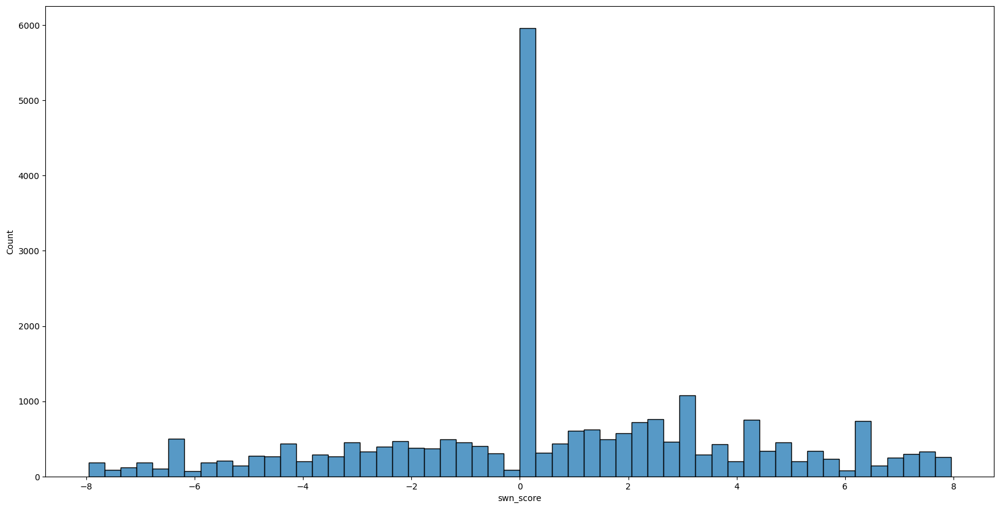

In [380]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))
sns.histplot(x='swn_score', data=reviews.query("swn_score < 8 and swn_score > -8"), ax=ax)
plt.show()

In [381]:
reviews[reviews["swn_score"] == 0].count()

content                  5899
score                    5899
new_reviews              5899
detected_lang            5899
swn_score                5899
swn_sentiment            5899
true_sentiment           5899
oplex_sentiment_score    5899
oplex_sentiment          5899
dtype: int64

In [382]:
reviews[reviews["swn_score"] == 0].sample(10)

,content,score,new_reviews,detected_lang,swn_score,swn_sentiment,true_sentiment,oplex_sentiment_score,oplex_sentiment
11006,Thank,5,thank,en,0.0,neutral,positive,1.000000,positive
33113,Princess gandar mangacou,5,princess gandar mangacou,en,0.0,neutral,positive,0.000000,negative
64636,"I purchased 1,214.05 last May 24, 2022 and I got no coins, and I already reported the problem about that but until now I got no response from your services 🤦🏻‍♂️ please help me bring back my money.",2,I purchase 121405 last may 24 2022 and I get no coin and I already report the problem about that but until now I get no response from your service please help I bring back my money,en,0.0,neutral,negative,-0.027027,negative
89404,like this appp,3,like this appp,en,0.0,neutral,neutral,0.333333,positive
28919,Only has Russian feed. I change my language preferences to English but it does not update. Poco x3 pro user,1,only have russian feed I change my language preference to english but it do not update poco x3 pro user,en,0.0,neutral,negative,0.000000,negative
47508,The World 🌎,5,the world,en,0.0,neutral,positive,0.000000,negative
250,1000k followers😢😢😢👇👇👇👇,5,1000k follower,en,0.0,neutral,positive,0.000000,negative
72822,This app verrygood,5,this app verrygood,en,0.0,neutral,positive,0.000000,negative
22124,"Tiktok team in the Philippines are very disappointing! They are cheaters, I am not interested in tiktok at this very moment. I will surely uninstall this app after this review!!!!",1,tiktok team in the philippine be very disappointing they be cheater I be not interested in tiktok at this very moment I will surely uninstall this app after this review,en,0.0,neutral,negative,-0.066667,negative
40229,always updating,1,always update,en,0.0,neutral,negative,0.000000,negative


In [383]:
reviews['swn_sentiment'] = reviews['swn_score'].apply(lambda x: "positive" if x>1 else ("negative" if x<0 else "neutral"))

In [384]:
reviews['swn_sentiment'].value_counts(dropna=False)

positive    22709
negative     9995
neutral      6935
Name: swn_sentiment, dtype: int64

<AxesSubplot: xlabel='score', ylabel='count'>

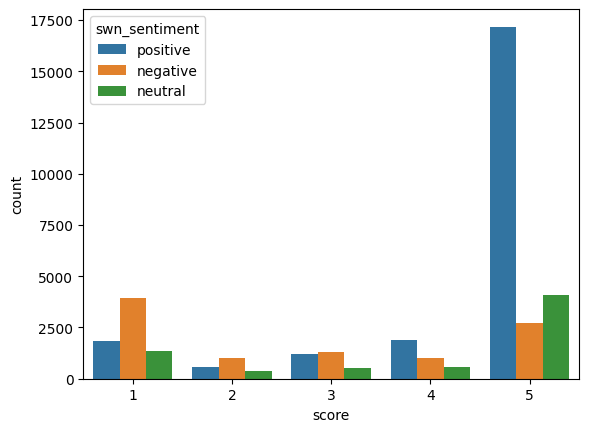

In [385]:
sns.countplot(x='score', hue='swn_sentiment' ,data = reviews)

<AxesSubplot: xlabel='swn_sentiment', ylabel='score'>

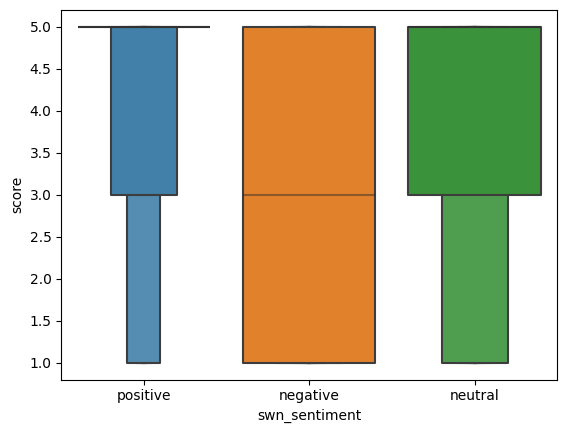

In [386]:
sns.boxenplot(x='swn_sentiment', y='score', data = reviews)

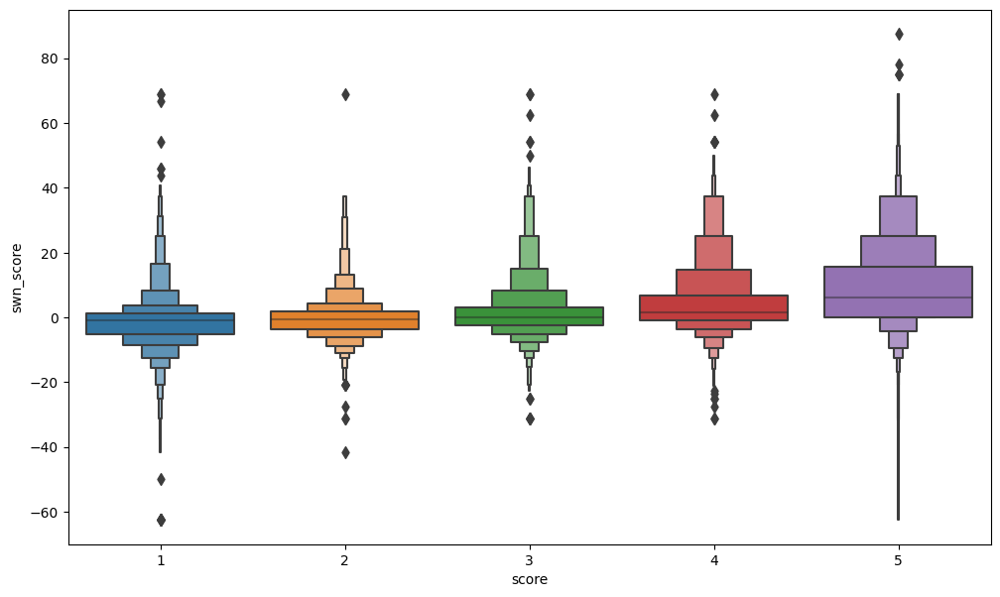

In [387]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize = (12,7))
sns.boxenplot(x='score', y='swn_score', data = reviews, ax=ax)
plt.show()

In [388]:
reviews['true_sentiment'] = \
    reviews['score'].apply(lambda x: "positive" if x>=4 else ("neutral" if x==3 else "negative"))

In [389]:
y_swn_pred, y_true = reviews['swn_sentiment'].tolist(), reviews['true_sentiment'].tolist()

In [390]:
len(y_swn_pred), len(y_true)

(39639, 39639)

In [391]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_true, y_swn_pred, labels=["negative", "neutral", "positive"])

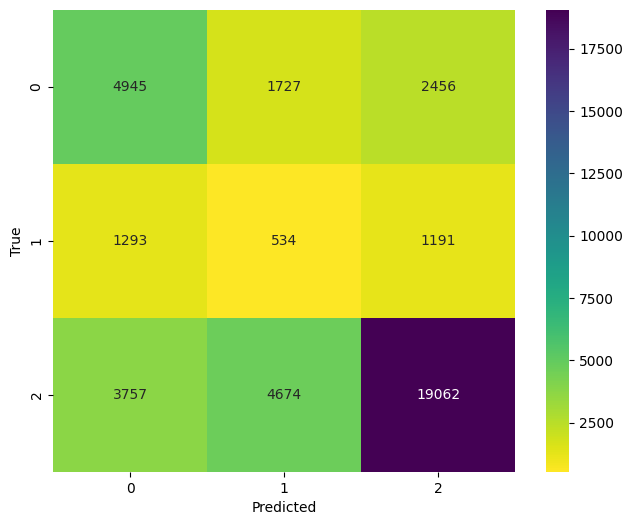

In [392]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(8,6))
sns.heatmap(cm, cmap='viridis_r', annot=True, fmt='d', square=True, ax=ax)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

## Performance Assesment

### Negative Sentiment Prediction Assessment

In [393]:
tp, tn, fp, fn = cm[0][0], cm[1][1]+cm[1][2]+cm[2][1]+cm[2][2], cm[1][0]+cm[2][0], cm[0][1]+cm[0][2]

In [394]:
recall = tp / (tp+fn)
specifity = tn / (tn+fp)
precision = tp/(tp+fp)
f1 = (2*tp) / (2*tp + fp + fn)
print("recall: {}\nprecission: {}\nf1 score: {}".format(recall, precision, f1))

recall: 0.5417397020157756
precission: 0.4947473736868434
f1 score: 0.5171782670083146


### Positive Sentiment Prediction Assessment

In [395]:
tp, tn, fp, fn = cm[2][2], cm[0][0]+cm[0][1]+cm[1][0]+cm[1][1], cm[0][2]+cm[1][2], cm[2][0]+cm[2][1]

In [396]:
recall = tp / (tp+fn)
specifity = tn / (tn+fp)
precision = tp/(tp+fp)
f1 = (2*tp) / (2*tp + fp + fn)
print("recall: {}\nprecission: {}\nf1 score: {}".format(recall, precision, f1))

recall: 0.6933401229403848
precission: 0.839402879915452
f1 score: 0.7594119756185013


## Sentiment Scoring Model Using NLTK Opinion Lexicon

In [397]:
pos_words = list(opinion_lexicon.positive())
neg_words = list(opinion_lexicon.negative())

In [398]:
def get_sentiment_score_oplex(text):
    
    """
        This method returns the sentiment score of a given text using nltk opinion lexicon.
        input: text
        output: numeric (double) score, >0 means positive sentiment and <0 means negative sentiment.
    """    
    total_score = 0

    raw_sentences = sent_tokenize(text)
    
    for sentence in raw_sentences:

        sent_score = 0     
        sentence = str(sentence)
        sentence = sentence.replace("<br />"," ").translate(str.maketrans('','',punctuation)).lower()
        tokens = TreebankWordTokenizer().tokenize(text)
        for token in tokens:
            sent_score = sent_score + 1 if token in pos_words else (sent_score - 1 if token in neg_words else sent_score)
        total_score = total_score + (sent_score / len(tokens))

    
    return total_score

In [399]:
reviews['oplex_sentiment_score'] = reviews['new_reviews'].apply(lambda x: get_sentiment_score_oplex(x))

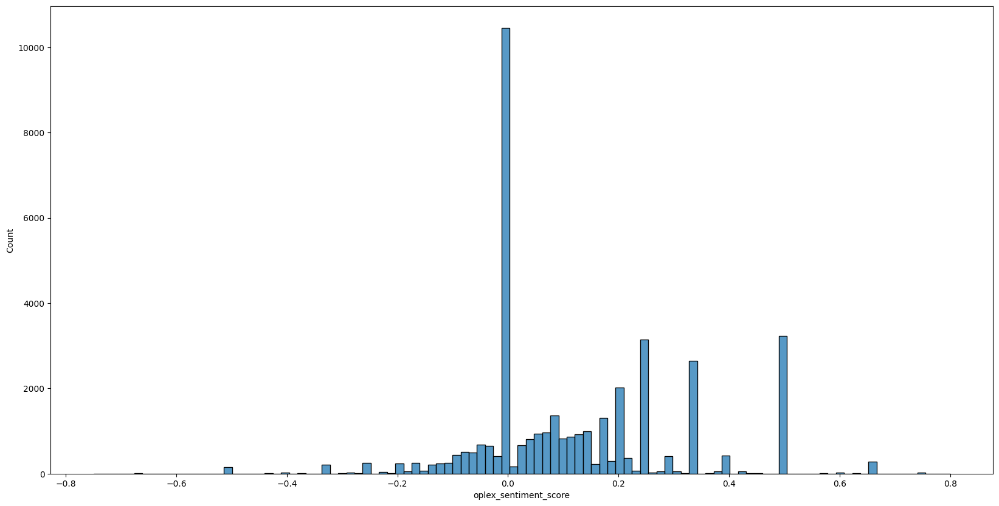

In [400]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))
sns.histplot(x='oplex_sentiment_score',\
             data=reviews.query("oplex_sentiment_score < 1 and oplex_sentiment_score>-1"), ax=ax)
plt.show()

In [401]:
reviews['oplex_sentiment'] = \
    reviews['oplex_sentiment_score'].apply(lambda x: "positive" if x>0.15 else ("negative" if x<0.5 else "neutral"))

In [402]:
reviews['oplex_sentiment'].value_counts(dropna=False)

negative    24219
positive    15420
Name: oplex_sentiment, dtype: int64

<AxesSubplot: xlabel='score', ylabel='count'>

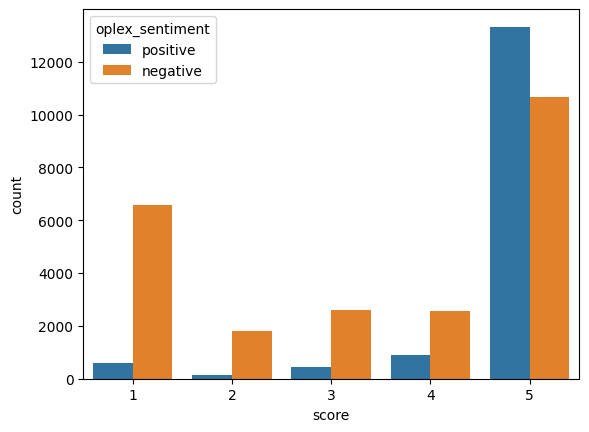

In [403]:
sns.countplot(x='score', hue='oplex_sentiment' ,data = reviews)

<AxesSubplot: xlabel='oplex_sentiment', ylabel='score'>

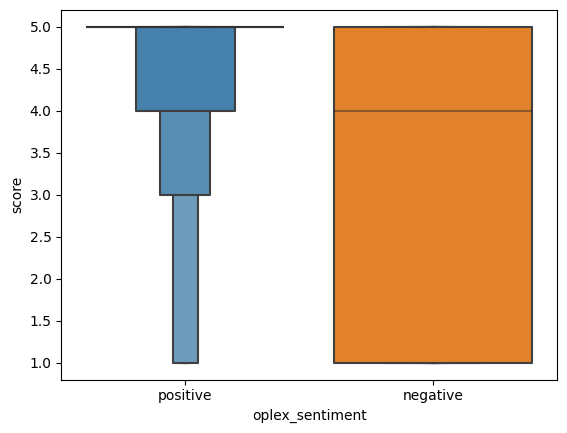

In [404]:
sns.boxenplot(x='oplex_sentiment', y='score', data = reviews)

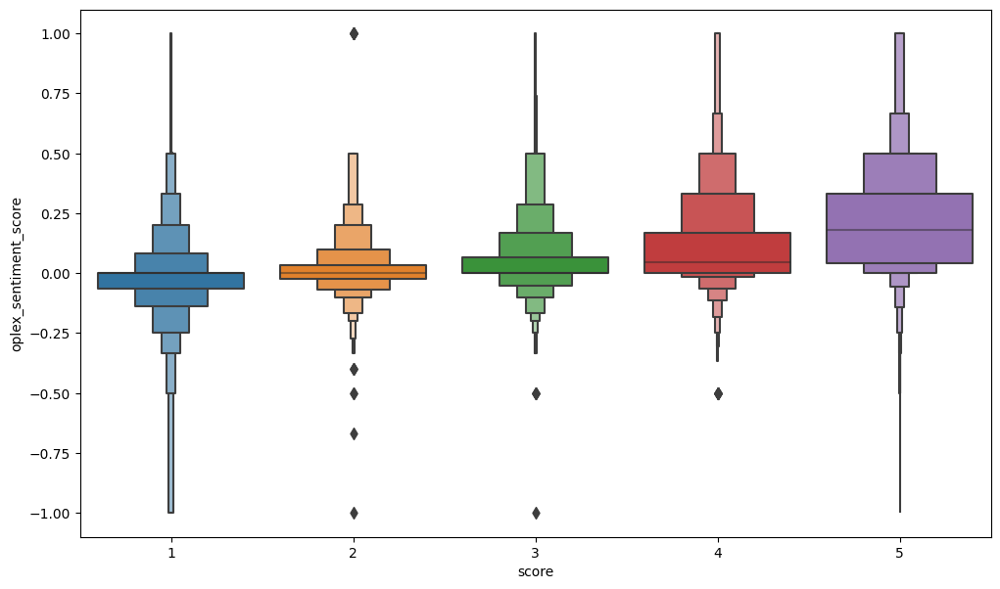

In [405]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize = (12,7))
sns.boxenplot(x='score', y='oplex_sentiment_score', data = reviews, ax=ax)
plt.show()

In [406]:
y_oplex_pred = reviews['oplex_sentiment'].tolist()

In [407]:
oplex_cm = confusion_matrix(y_true, y_oplex_pred)

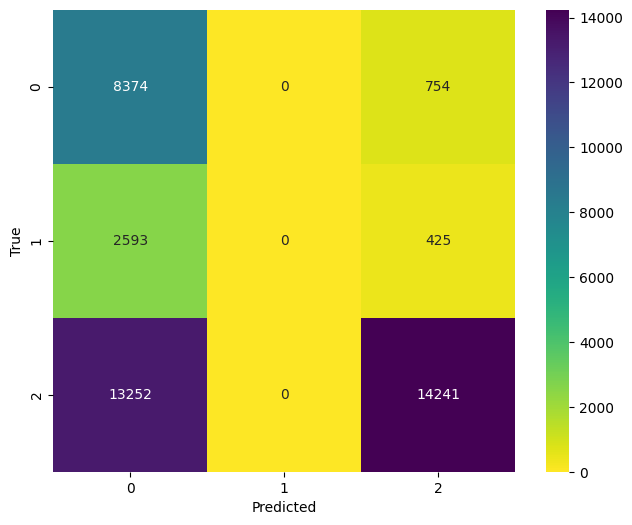

In [408]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(8,6))
sns.heatmap(oplex_cm, cmap='viridis_r', annot=True, fmt='d', square=True, ax=ax)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

## Performance Assesment

### Negative Sentiment Prediction Assessment

In [409]:
tp, tn, fp, fn = oplex_cm[0][0], oplex_cm[1][1]+oplex_cm[1][2]+oplex_cm[2][1]+oplex_cm[2][2], oplex_cm[1][0]+oplex_cm[2][0], oplex_cm[0][1]+oplex_cm[0][2]

In [410]:
recall = tp / (tp+fn)
specifity = tn / (tn+fp)
precision = tp/(tp+fp)
f1 = (2*tp) / (2*tp + fp + fn)
print("recall: {}\nprecission: {}\nf1 score: {}".format(recall, precision, f1))

recall: 0.9173970201577564
precission: 0.34576159213840374
f1 score: 0.5022340840255495


### Positive Sentiment Prediction Assessment

In [411]:
tp, tn, fp, fn = oplex_cm[2][2], oplex_cm[0][0]+oplex_cm[0][1]+oplex_cm[1][0]+oplex_cm[1][1], oplex_cm[0][2]+oplex_cm[1][2], oplex_cm[2][0]+oplex_cm[2][1]

In [412]:
recall = tp / (tp+fn)
specifity = tn / (tn+fp)
precision = tp/(tp+fp)
f1 = (2*tp) / (2*tp + fp + fn)
print("recall: {}\nprecission: {}\nf1 score: {}".format(recall, precision, f1))

recall: 0.5179863965373004
precission: 0.9235408560311285
f1 score: 0.6637149581711835
